<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_10_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 39.0449 - IoU: 0.0499
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 93ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


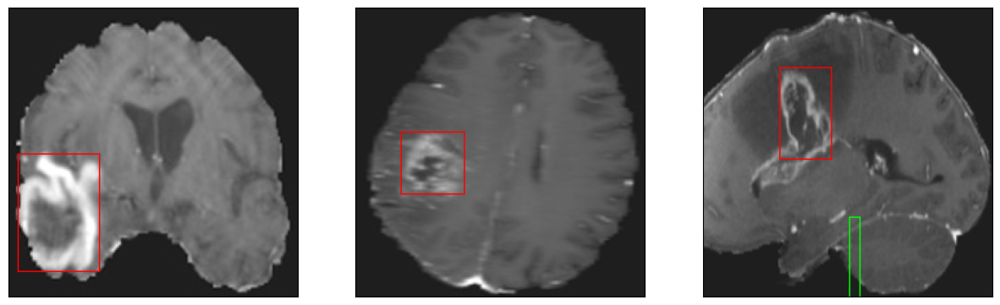

26/26 [==============================] - 48s 1s/step - loss: 39.0449 - IoU: 0.0499 - val_loss: 105.4674 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 26.5470 - IoU: 0.0723
Epoch 2: val_IoU improved from 0.00000 to 0.00579, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


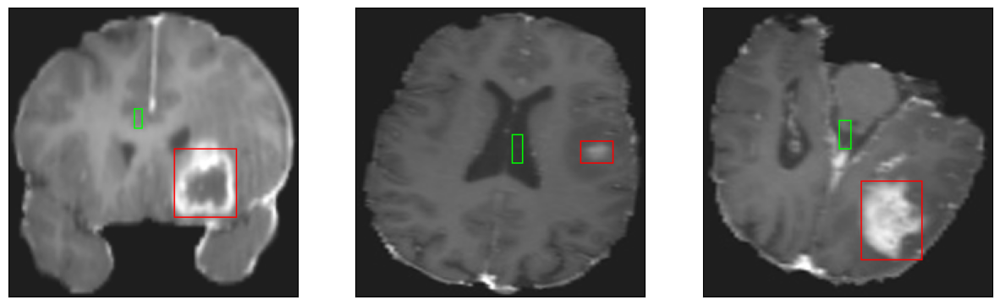

26/26 [==============================] - 24s 953ms/step - loss: 26.5470 - IoU: 0.0723 - val_loss: 76.6173 - val_IoU: 0.0058
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 25.8180 - IoU: 0.0857
Epoch 3: val_IoU improved from 0.00579 to 0.01886, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


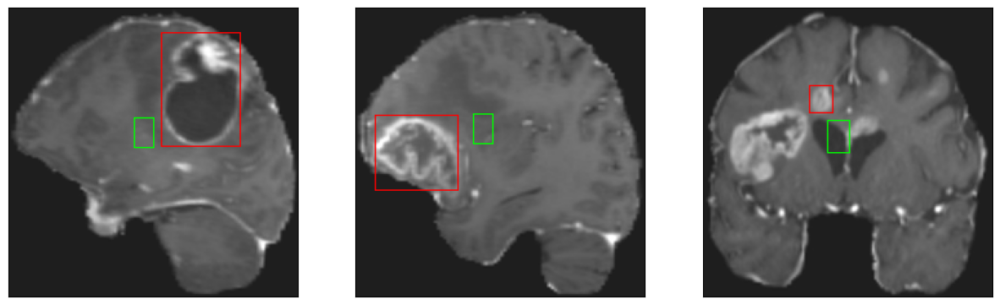

26/26 [==============================] - 21s 820ms/step - loss: 25.8180 - IoU: 0.0857 - val_loss: 62.7716 - val_IoU: 0.0189
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 24.3847 - IoU: 0.0946
Epoch 4: val_IoU improved from 0.01886 to 0.02750, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


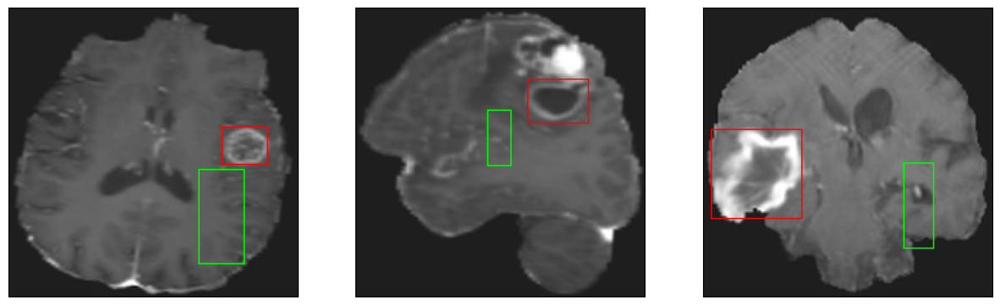

26/26 [==============================] - 18s 724ms/step - loss: 24.3847 - IoU: 0.0946 - val_loss: 53.6637 - val_IoU: 0.0275
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 23.0953 - IoU: 0.1238
Epoch 5: val_IoU improved from 0.02750 to 0.04597, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


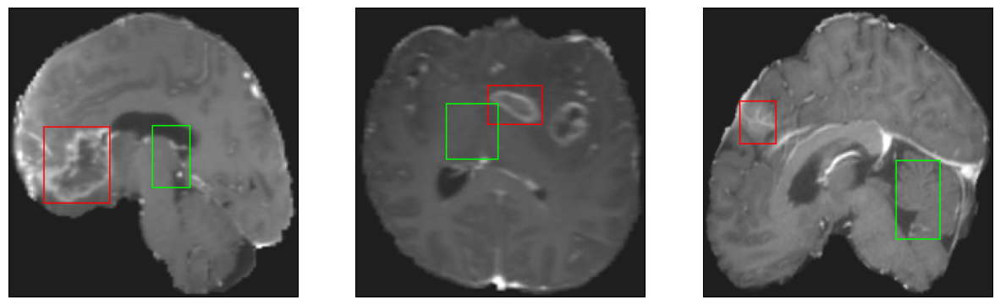

26/26 [==============================] - 25s 1s/step - loss: 23.0953 - IoU: 0.1238 - val_loss: 34.3999 - val_IoU: 0.0460
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 21.3830 - IoU: 0.1509
Epoch 6: val_IoU did not improve from 0.04597
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


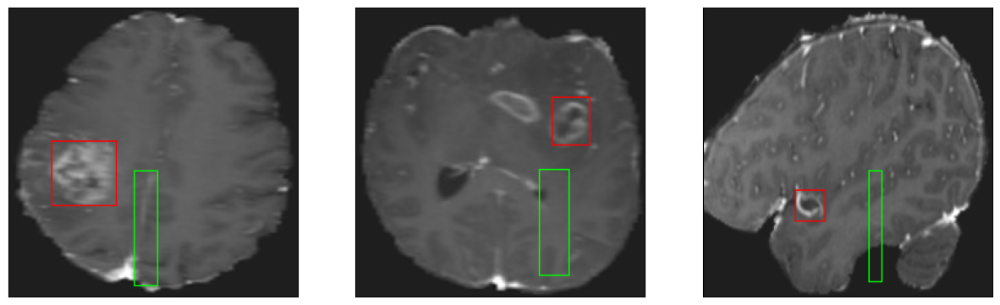

26/26 [==============================] - 8s 292ms/step - loss: 21.3830 - IoU: 0.1509 - val_loss: 77.9350 - val_IoU: 0.0043
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 19.0075 - IoU: 0.1884
Epoch 7: val_IoU did not improve from 0.04597
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


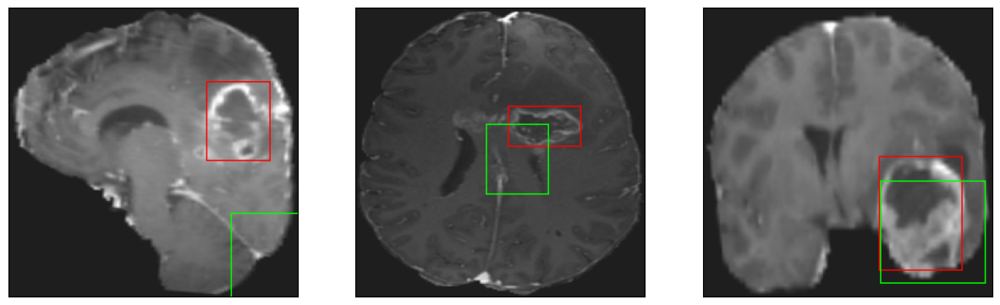

26/26 [==============================] - 8s 306ms/step - loss: 19.0075 - IoU: 0.1884 - val_loss: 63.3093 - val_IoU: 0.0117
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 17.6381 - IoU: 0.2208
Epoch 8: val_IoU did not improve from 0.04597
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


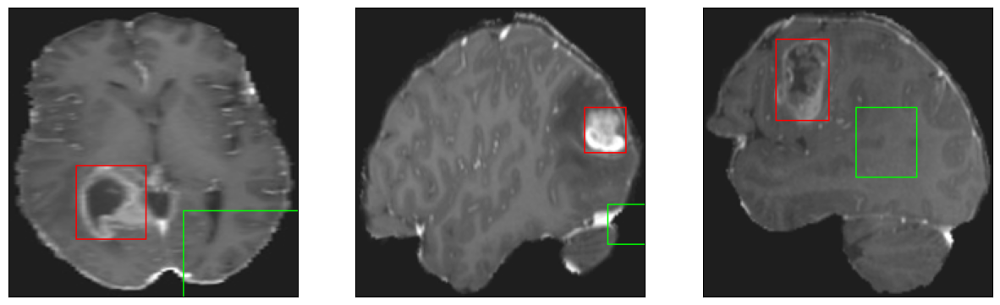

26/26 [==============================] - 8s 291ms/step - loss: 17.6381 - IoU: 0.2208 - val_loss: 65.2472 - val_IoU: 0.0140
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 17.3441 - IoU: 0.2273
Epoch 9: val_IoU did not improve from 0.04597
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


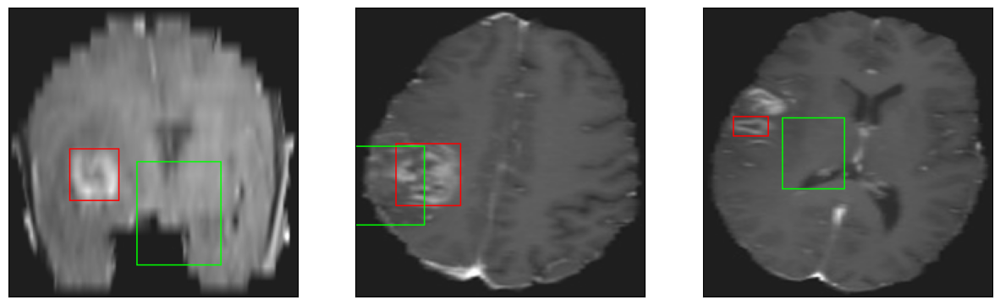

26/26 [==============================] - 7s 267ms/step - loss: 17.3441 - IoU: 0.2273 - val_loss: 66.2283 - val_IoU: 0.0274
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 16.9319 - IoU: 0.2413
Epoch 10: val_IoU did not improve from 0.04597
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


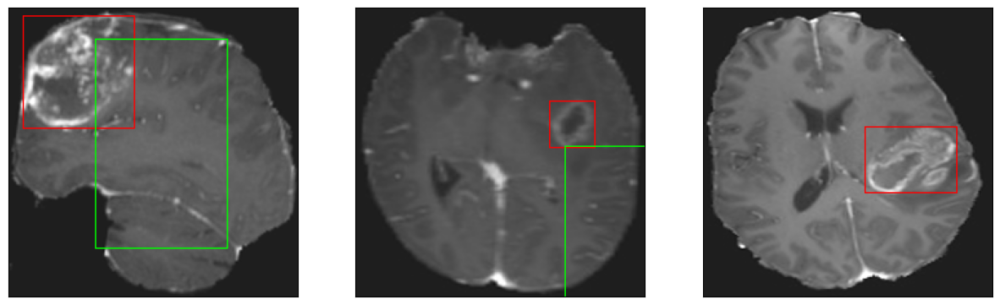

26/26 [==============================] - 7s 265ms/step - loss: 16.9319 - IoU: 0.2413 - val_loss: 115.8695 - val_IoU: 0.0120
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 16.4045 - IoU: 0.2505
Epoch 11: val_IoU improved from 0.04597 to 0.06697, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


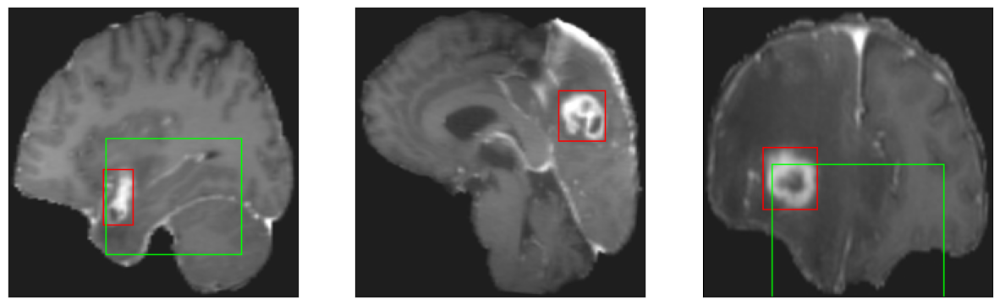

26/26 [==============================] - 23s 894ms/step - loss: 16.4045 - IoU: 0.2505 - val_loss: 65.9319 - val_IoU: 0.0670
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 15.1503 - IoU: 0.2864
Epoch 12: val_IoU improved from 0.06697 to 0.12040, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


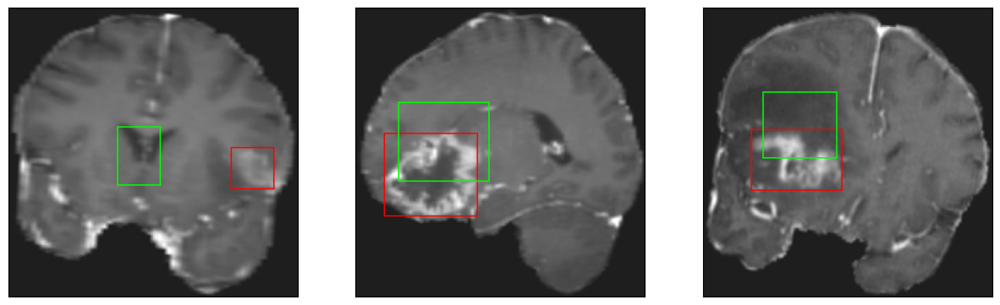

26/26 [==============================] - 13s 528ms/step - loss: 15.1503 - IoU: 0.2864 - val_loss: 25.2511 - val_IoU: 0.1204
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 14.7474 - IoU: 0.2815
Epoch 13: val_IoU did not improve from 0.12040
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


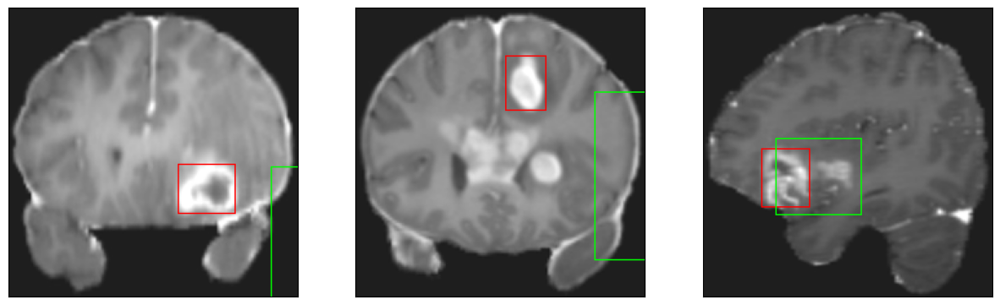

26/26 [==============================] - 8s 321ms/step - loss: 14.7474 - IoU: 0.2815 - val_loss: 38.5137 - val_IoU: 0.0704
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 13.7443 - IoU: 0.3189
Epoch 14: val_IoU improved from 0.12040 to 0.22028, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


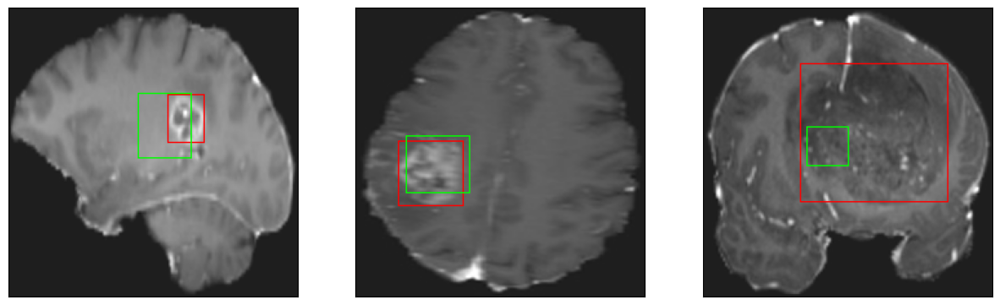

26/26 [==============================] - 15s 600ms/step - loss: 13.7443 - IoU: 0.3189 - val_loss: 17.5147 - val_IoU: 0.2203
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 12.9990 - IoU: 0.3362
Epoch 15: val_IoU improved from 0.22028 to 0.30829, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


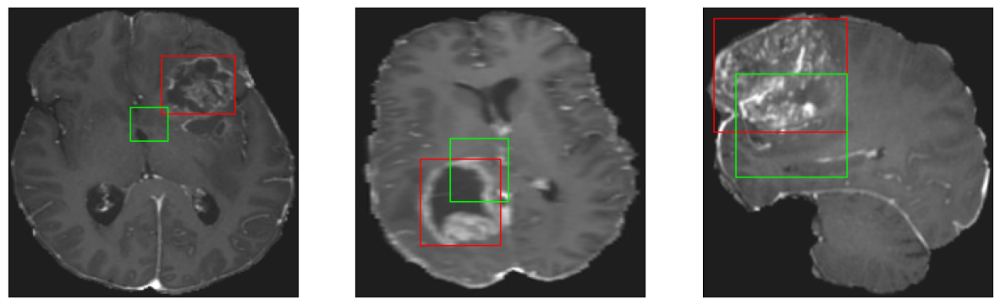

26/26 [==============================] - 13s 518ms/step - loss: 12.9990 - IoU: 0.3362 - val_loss: 15.0286 - val_IoU: 0.3083
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 13.6023 - IoU: 0.3186
Epoch 16: val_IoU improved from 0.30829 to 0.33149, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


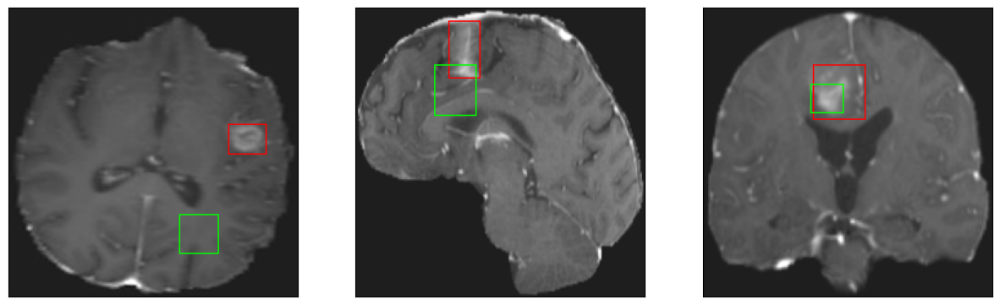

26/26 [==============================] - 15s 609ms/step - loss: 13.6023 - IoU: 0.3186 - val_loss: 13.0692 - val_IoU: 0.3315
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 14.2838 - IoU: 0.3008
Epoch 17: val_IoU did not improve from 0.33149
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


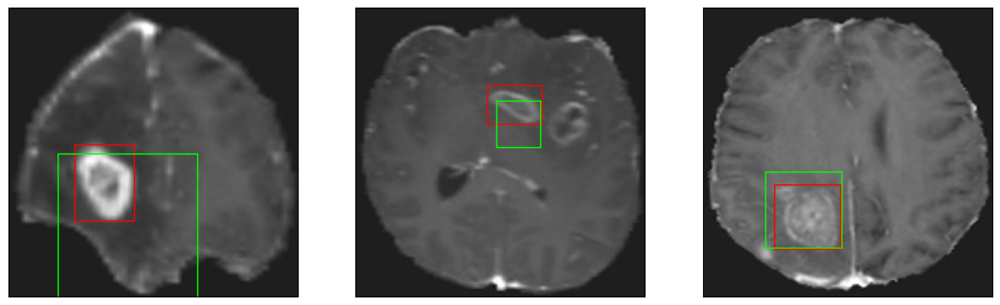

26/26 [==============================] - 8s 293ms/step - loss: 14.2838 - IoU: 0.3008 - val_loss: 23.2311 - val_IoU: 0.2491
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 12.7941 - IoU: 0.3317
Epoch 18: val_IoU did not improve from 0.33149
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


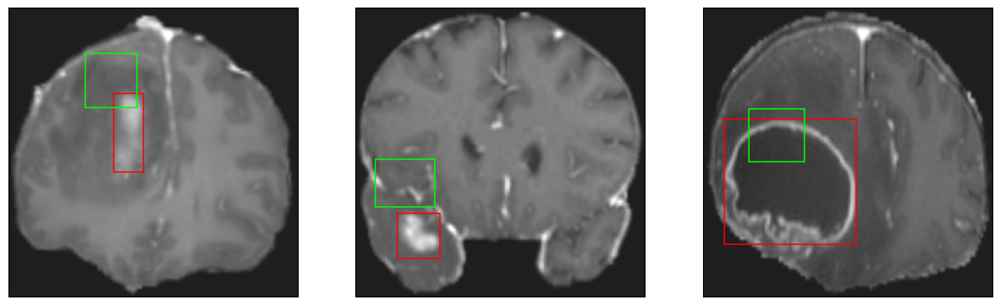

26/26 [==============================] - 8s 294ms/step - loss: 12.7941 - IoU: 0.3317 - val_loss: 14.3456 - val_IoU: 0.2662
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 12.3113 - IoU: 0.3584
Epoch 19: val_IoU improved from 0.33149 to 0.35050, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


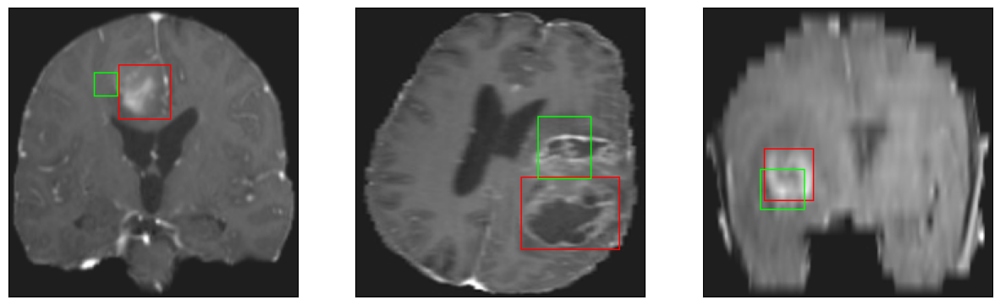

26/26 [==============================] - 18s 711ms/step - loss: 12.3113 - IoU: 0.3584 - val_loss: 11.7730 - val_IoU: 0.3505
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 11.3347 - IoU: 0.3726
Epoch 20: val_IoU did not improve from 0.35050
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


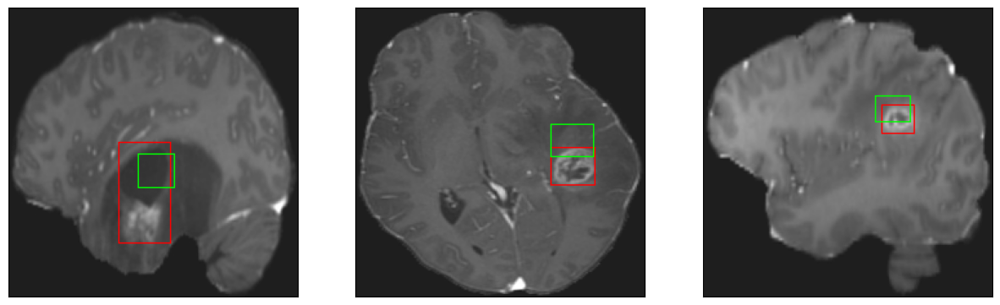

26/26 [==============================] - 8s 305ms/step - loss: 11.3347 - IoU: 0.3726 - val_loss: 11.7841 - val_IoU: 0.3482
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 11.5342 - IoU: 0.3683
Epoch 21: val_IoU improved from 0.35050 to 0.35567, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


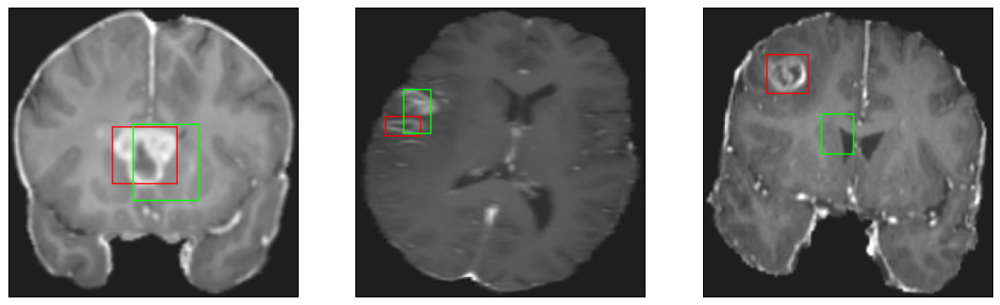

26/26 [==============================] - 16s 614ms/step - loss: 11.5342 - IoU: 0.3683 - val_loss: 13.2458 - val_IoU: 0.3557
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 11.0237 - IoU: 0.3759
Epoch 22: val_IoU did not improve from 0.35567
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


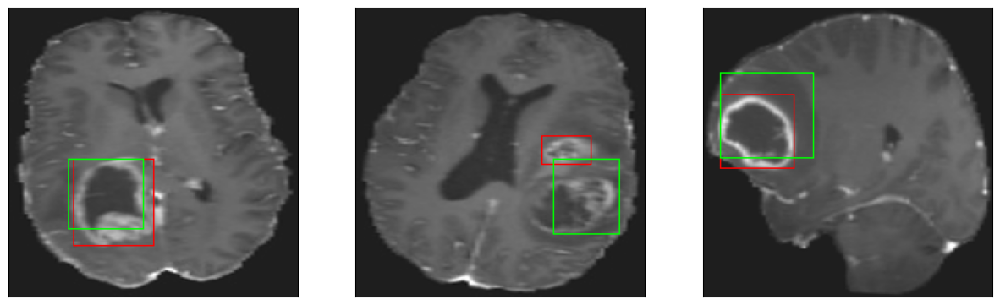

26/26 [==============================] - 7s 280ms/step - loss: 11.0237 - IoU: 0.3759 - val_loss: 12.5385 - val_IoU: 0.3295
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 11.3021 - IoU: 0.3638
Epoch 23: val_IoU did not improve from 0.35567
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 48ms/step
4


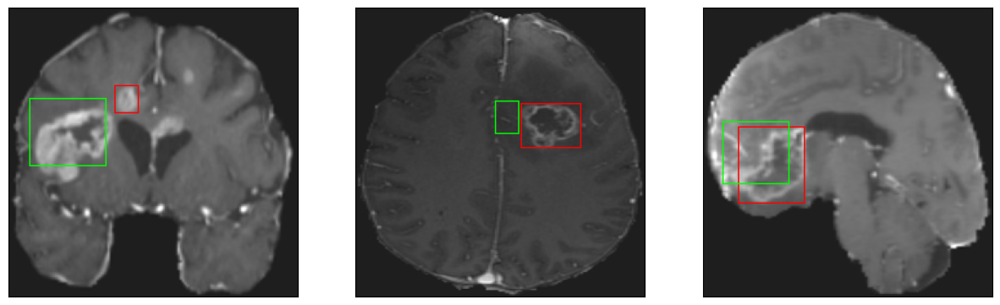

26/26 [==============================] - 9s 330ms/step - loss: 11.3021 - IoU: 0.3638 - val_loss: 12.0022 - val_IoU: 0.3224
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 11.0144 - IoU: 0.3845
Epoch 24: val_IoU did not improve from 0.35567
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


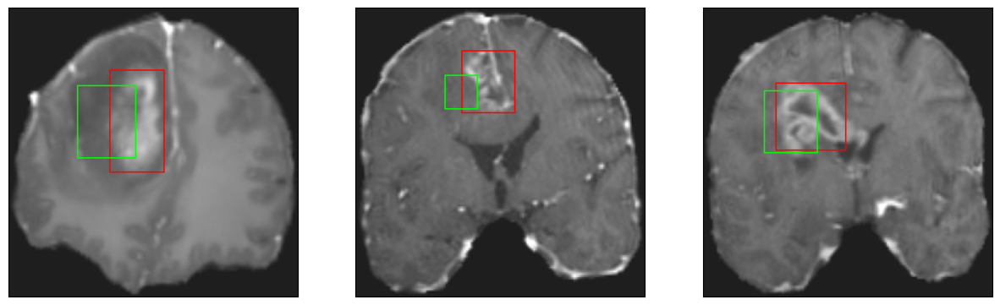

26/26 [==============================] - 7s 280ms/step - loss: 11.0144 - IoU: 0.3845 - val_loss: 12.4690 - val_IoU: 0.3388
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.4581 - IoU: 0.4009
Epoch 25: val_IoU did not improve from 0.35567
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


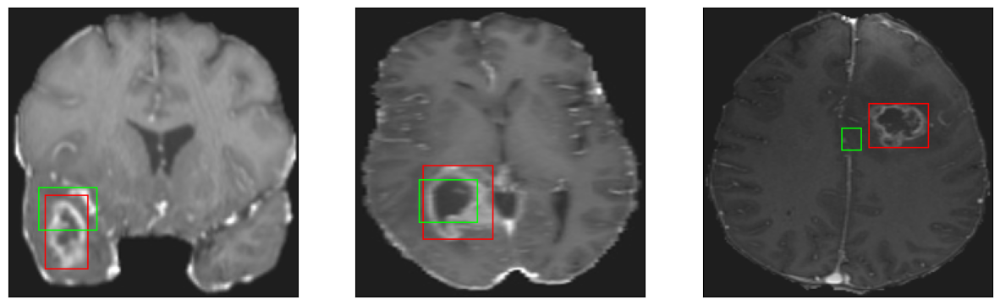

26/26 [==============================] - 7s 284ms/step - loss: 10.4581 - IoU: 0.4009 - val_loss: 13.1890 - val_IoU: 0.2813
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 10.5796 - IoU: 0.3901
Epoch 26: val_IoU did not improve from 0.35567
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


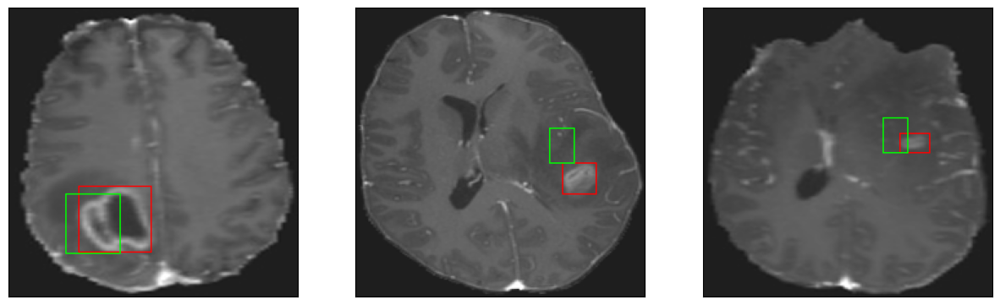

26/26 [==============================] - 8s 301ms/step - loss: 10.5796 - IoU: 0.3901 - val_loss: 11.7477 - val_IoU: 0.3494
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 10.4766 - IoU: 0.3941
Epoch 27: val_IoU improved from 0.35567 to 0.37783, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


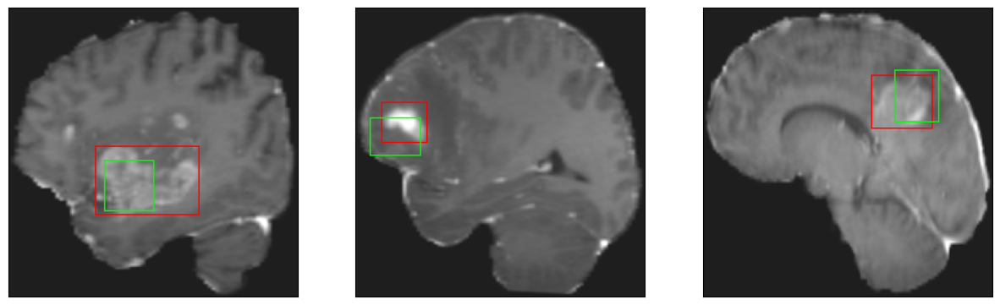

26/26 [==============================] - 21s 836ms/step - loss: 10.4766 - IoU: 0.3941 - val_loss: 11.5881 - val_IoU: 0.3778
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 9.9636 - IoU: 0.4089
Epoch 28: val_IoU improved from 0.37783 to 0.37987, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


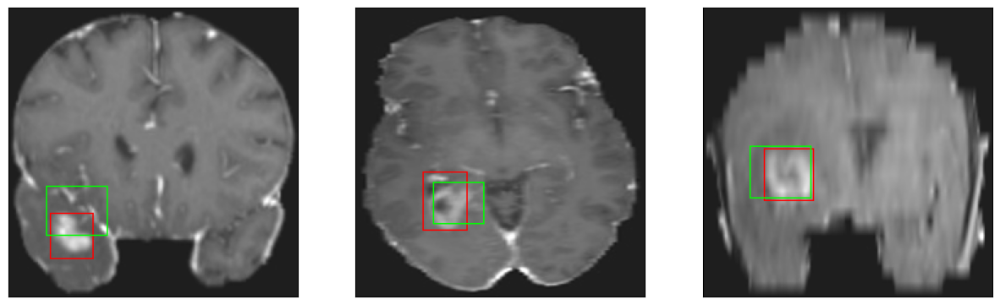

26/26 [==============================] - 16s 610ms/step - loss: 9.9636 - IoU: 0.4089 - val_loss: 10.3805 - val_IoU: 0.3799
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 9.9018 - IoU: 0.4143
Epoch 29: val_IoU did not improve from 0.37987
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


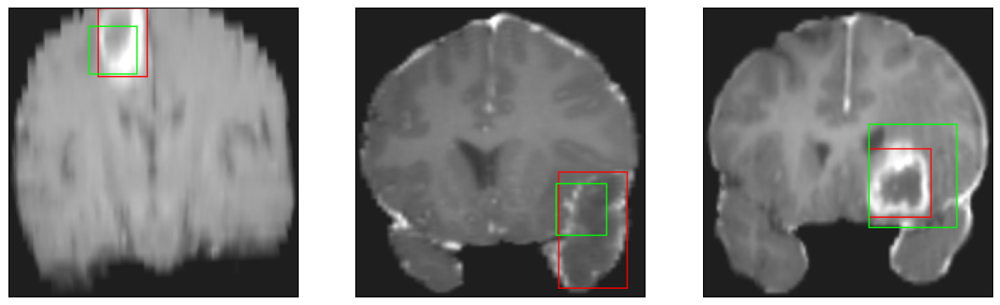

26/26 [==============================] - 8s 306ms/step - loss: 9.9018 - IoU: 0.4143 - val_loss: 12.3886 - val_IoU: 0.3382
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 10.2832 - IoU: 0.4031
Epoch 30: val_IoU improved from 0.37987 to 0.38184, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


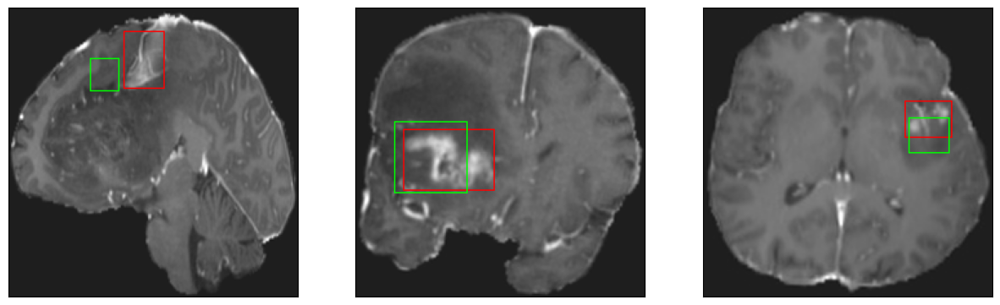

26/26 [==============================] - 16s 634ms/step - loss: 10.2832 - IoU: 0.4031 - val_loss: 11.2213 - val_IoU: 0.3818
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 9.7866 - IoU: 0.4153
Epoch 31: val_IoU improved from 0.38184 to 0.39997, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


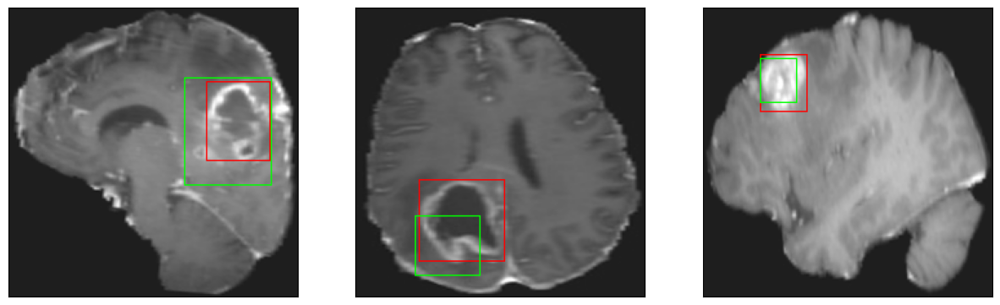

26/26 [==============================] - 19s 753ms/step - loss: 9.7866 - IoU: 0.4153 - val_loss: 10.1702 - val_IoU: 0.4000
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.5011 - IoU: 0.4299
Epoch 32: val_IoU did not improve from 0.39997
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


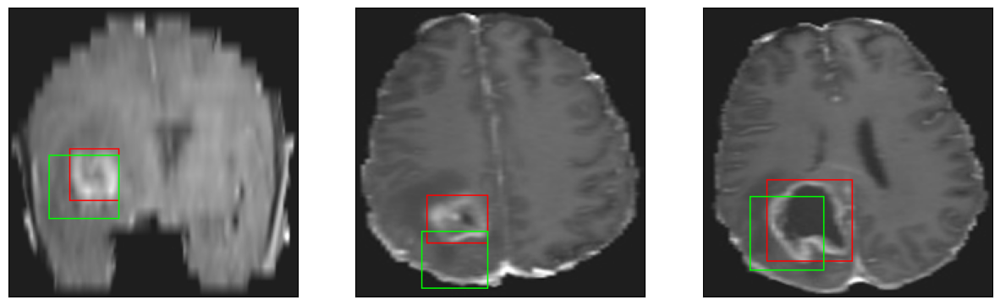

26/26 [==============================] - 8s 316ms/step - loss: 9.5011 - IoU: 0.4299 - val_loss: 10.7563 - val_IoU: 0.3551
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.4077 - IoU: 0.4184
Epoch 33: val_IoU did not improve from 0.39997
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


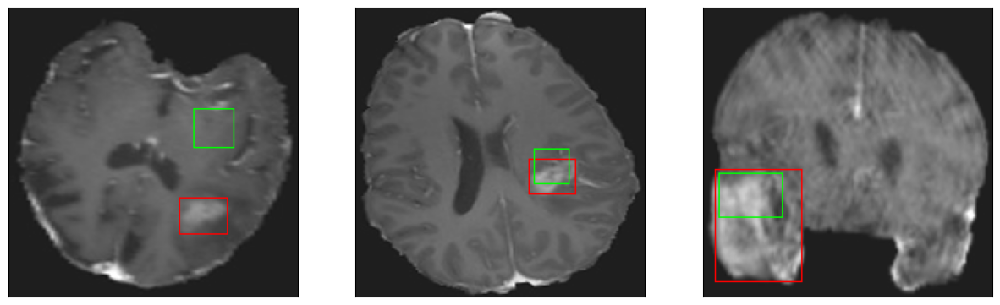

26/26 [==============================] - 8s 310ms/step - loss: 9.4077 - IoU: 0.4184 - val_loss: 11.0493 - val_IoU: 0.3812
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.0319 - IoU: 0.4570
Epoch 34: val_IoU did not improve from 0.39997
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


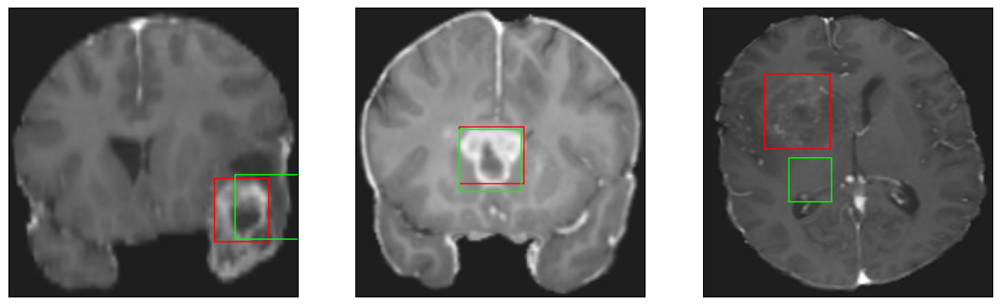

26/26 [==============================] - 8s 287ms/step - loss: 9.0319 - IoU: 0.4570 - val_loss: 10.2462 - val_IoU: 0.3838
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 9.0989 - IoU: 0.4339
Epoch 35: val_IoU improved from 0.39997 to 0.42973, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


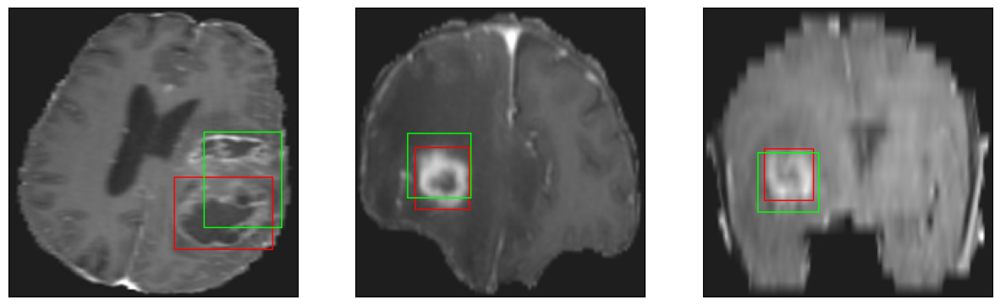

26/26 [==============================] - 34s 1s/step - loss: 9.0989 - IoU: 0.4339 - val_loss: 10.3661 - val_IoU: 0.4297
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 8.7662 - IoU: 0.4500
Epoch 36: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


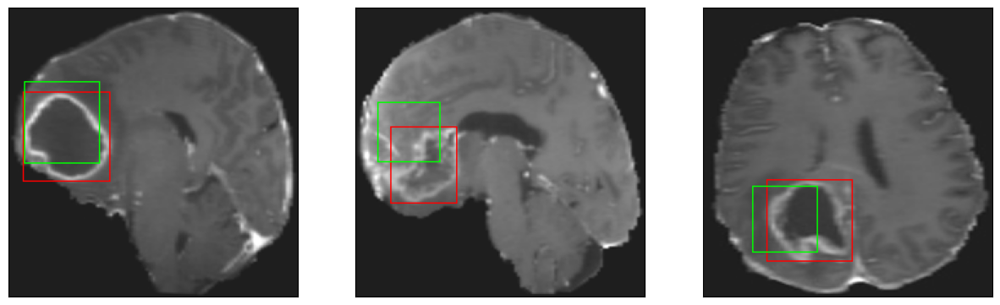

26/26 [==============================] - 7s 267ms/step - loss: 8.7662 - IoU: 0.4500 - val_loss: 10.5218 - val_IoU: 0.3833
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 8.8440 - IoU: 0.4431
Epoch 37: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


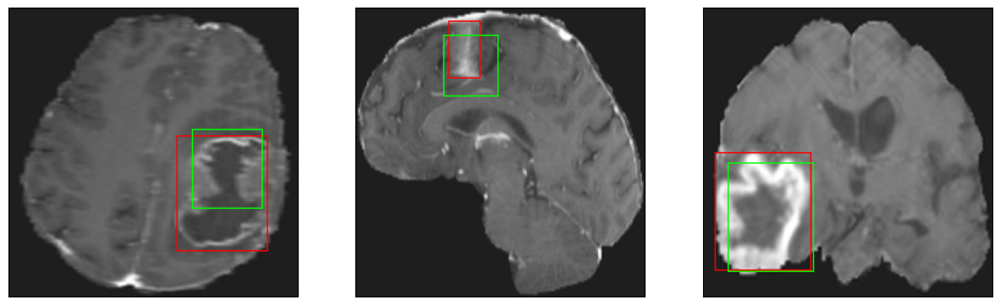

26/26 [==============================] - 8s 325ms/step - loss: 8.8440 - IoU: 0.4431 - val_loss: 9.8442 - val_IoU: 0.4101
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 8.4920 - IoU: 0.4636
Epoch 38: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


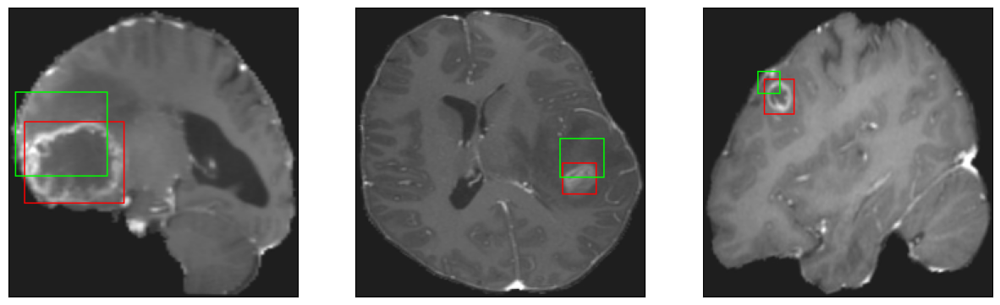

26/26 [==============================] - 8s 299ms/step - loss: 8.4920 - IoU: 0.4636 - val_loss: 10.8480 - val_IoU: 0.3826
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 8.5091 - IoU: 0.4543
Epoch 39: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


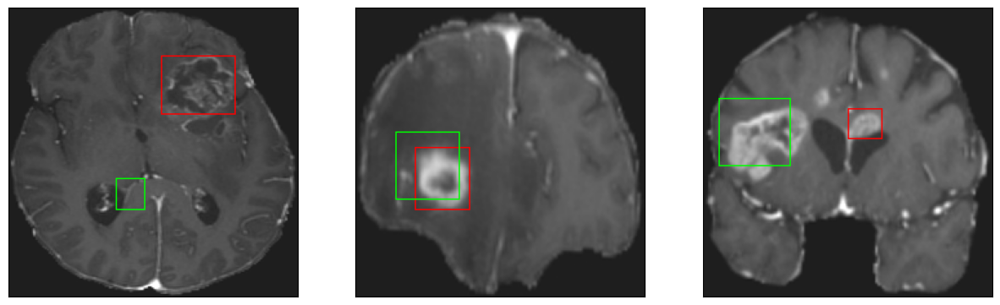

26/26 [==============================] - 8s 293ms/step - loss: 8.5091 - IoU: 0.4543 - val_loss: 10.6601 - val_IoU: 0.4230
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.8099 - IoU: 0.4497
Epoch 40: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


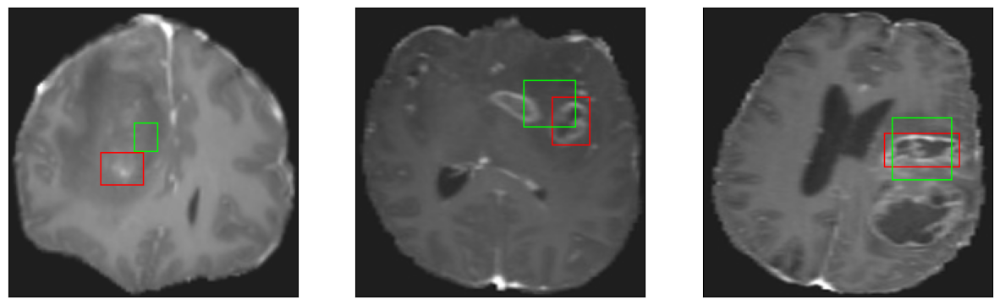

26/26 [==============================] - 7s 275ms/step - loss: 8.8099 - IoU: 0.4497 - val_loss: 10.9929 - val_IoU: 0.3830
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.2905 - IoU: 0.4729
Epoch 41: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


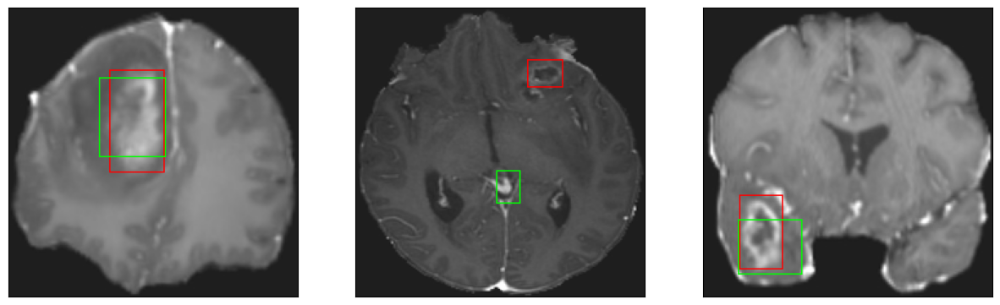

26/26 [==============================] - 7s 265ms/step - loss: 8.2905 - IoU: 0.4729 - val_loss: 10.6657 - val_IoU: 0.3887
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.8885 - IoU: 0.4416
Epoch 42: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


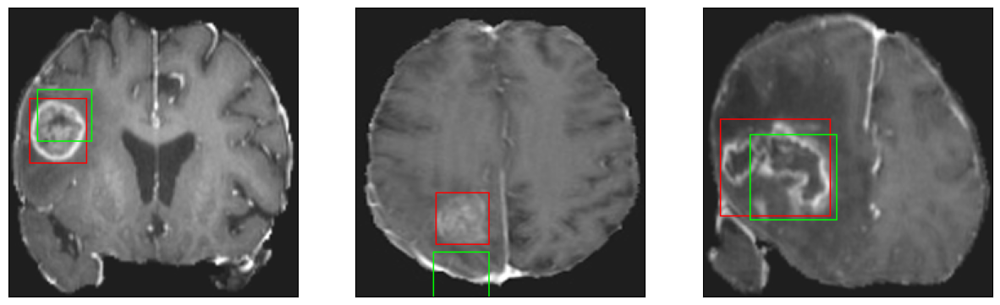

26/26 [==============================] - 8s 306ms/step - loss: 8.8885 - IoU: 0.4416 - val_loss: 10.0975 - val_IoU: 0.3882
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.6030 - IoU: 0.4588
Epoch 43: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


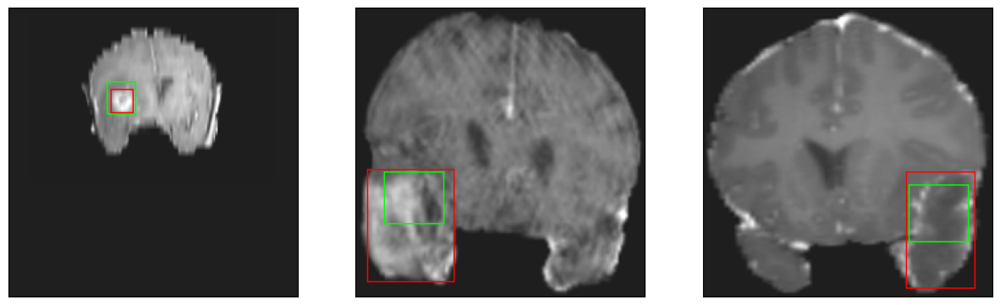

26/26 [==============================] - 7s 289ms/step - loss: 8.6030 - IoU: 0.4588 - val_loss: 9.8620 - val_IoU: 0.4138
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.5963 - IoU: 0.4596
Epoch 44: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


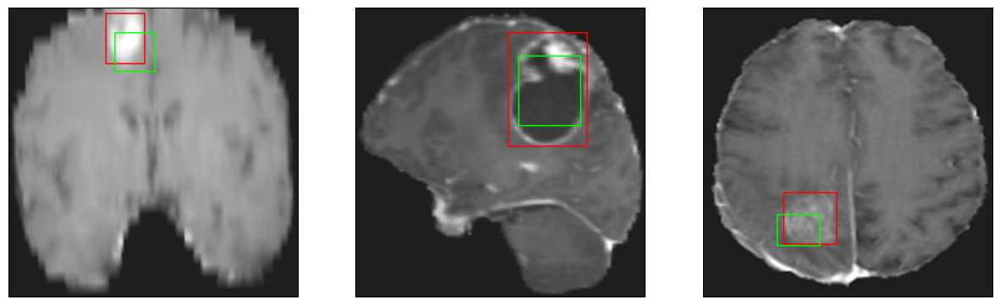

26/26 [==============================] - 7s 288ms/step - loss: 8.5963 - IoU: 0.4596 - val_loss: 10.7355 - val_IoU: 0.3749
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.4876 - IoU: 0.4517
Epoch 45: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


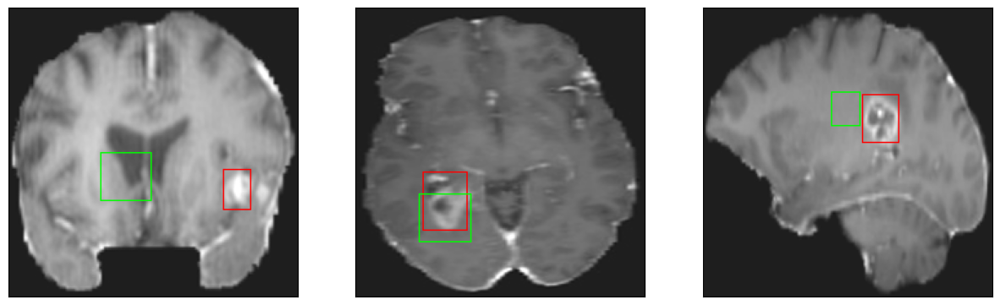

26/26 [==============================] - 7s 282ms/step - loss: 8.4876 - IoU: 0.4517 - val_loss: 9.6680 - val_IoU: 0.4286
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.5414 - IoU: 0.4597
Epoch 46: val_IoU did not improve from 0.42973
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


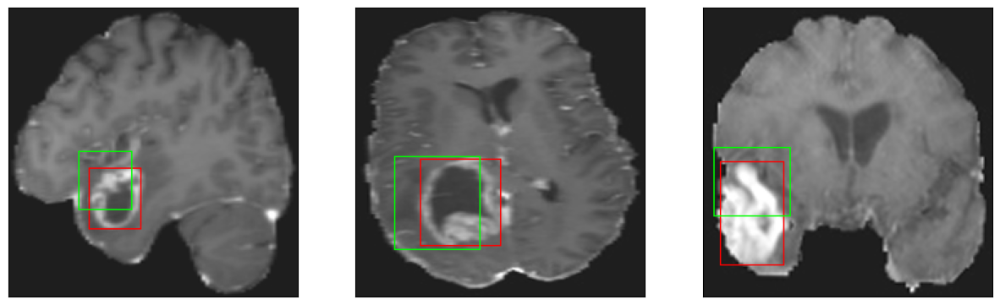

26/26 [==============================] - 8s 294ms/step - loss: 8.5414 - IoU: 0.4597 - val_loss: 10.7813 - val_IoU: 0.3764
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.3183 - IoU: 0.4658
Epoch 47: val_IoU improved from 0.42973 to 0.46446, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


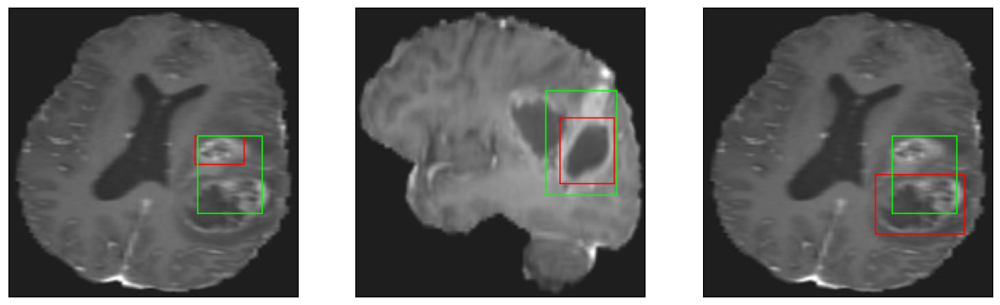

26/26 [==============================] - 27s 1s/step - loss: 8.3183 - IoU: 0.4658 - val_loss: 9.1890 - val_IoU: 0.4645
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.1290 - IoU: 0.4670
Epoch 48: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


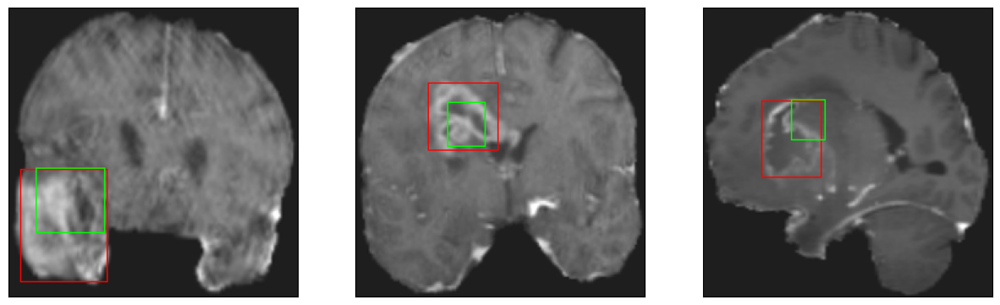

26/26 [==============================] - 8s 303ms/step - loss: 8.1290 - IoU: 0.4670 - val_loss: 9.9407 - val_IoU: 0.4055
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.1221 - IoU: 0.4618
Epoch 49: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


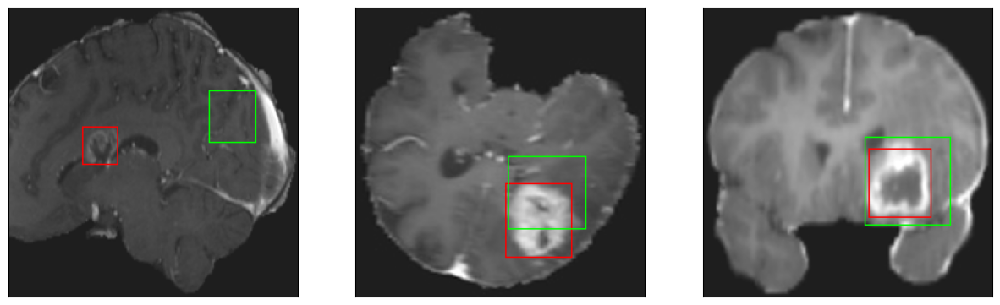

26/26 [==============================] - 8s 298ms/step - loss: 8.1221 - IoU: 0.4618 - val_loss: 9.3273 - val_IoU: 0.4449
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.1514 - IoU: 0.4696
Epoch 50: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


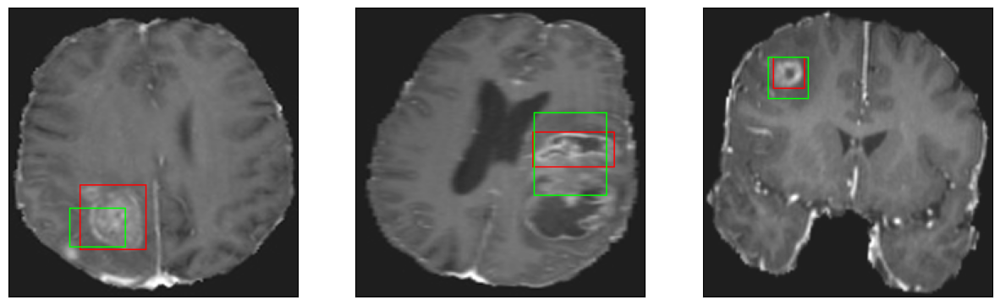

26/26 [==============================] - 7s 269ms/step - loss: 8.1514 - IoU: 0.4696 - val_loss: 10.1227 - val_IoU: 0.3846
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.2972 - IoU: 0.4542
Epoch 51: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


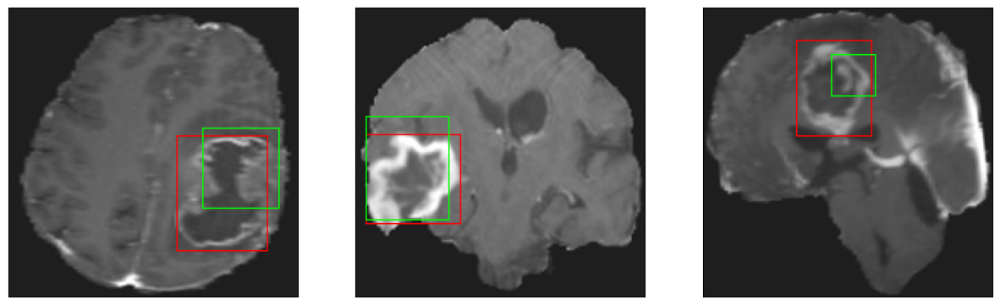

26/26 [==============================] - 8s 292ms/step - loss: 8.2972 - IoU: 0.4542 - val_loss: 9.1664 - val_IoU: 0.4400
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 7.9655 - IoU: 0.4815
Epoch 52: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


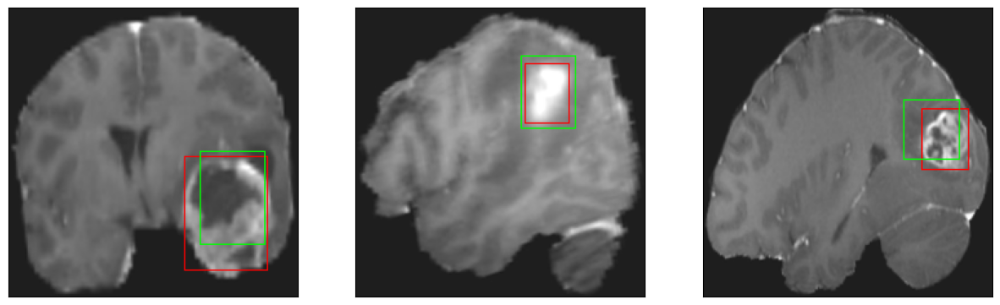

26/26 [==============================] - 8s 297ms/step - loss: 7.9655 - IoU: 0.4815 - val_loss: 9.2222 - val_IoU: 0.4387
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 7.6965 - IoU: 0.4928
Epoch 53: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


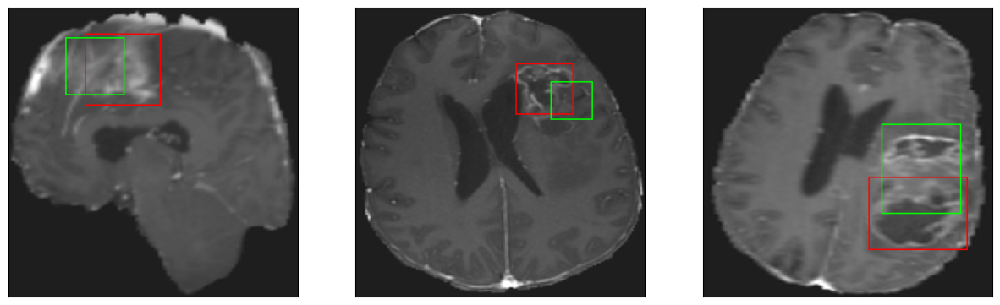

26/26 [==============================] - 8s 297ms/step - loss: 7.6965 - IoU: 0.4928 - val_loss: 9.6251 - val_IoU: 0.4365
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 7.5480 - IoU: 0.4971
Epoch 54: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


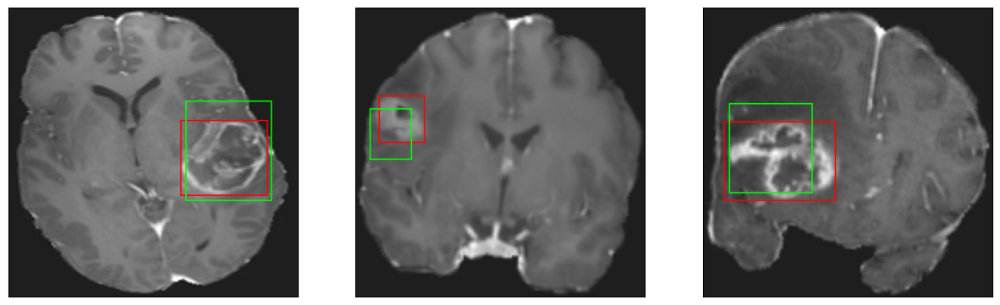

26/26 [==============================] - 8s 298ms/step - loss: 7.5480 - IoU: 0.4971 - val_loss: 10.2821 - val_IoU: 0.4252
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.1153 - IoU: 0.4723
Epoch 55: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


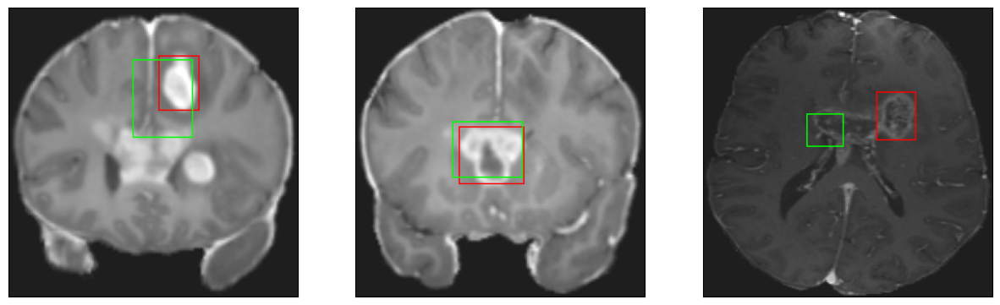

26/26 [==============================] - 7s 289ms/step - loss: 8.1153 - IoU: 0.4723 - val_loss: 9.8053 - val_IoU: 0.4180
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 8.0910 - IoU: 0.4741
Epoch 56: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


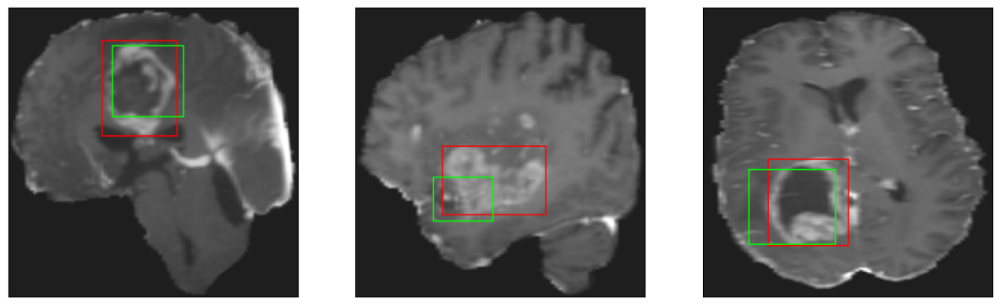

26/26 [==============================] - 8s 300ms/step - loss: 8.0910 - IoU: 0.4741 - val_loss: 9.9248 - val_IoU: 0.4317
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.6854 - IoU: 0.4936
Epoch 57: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


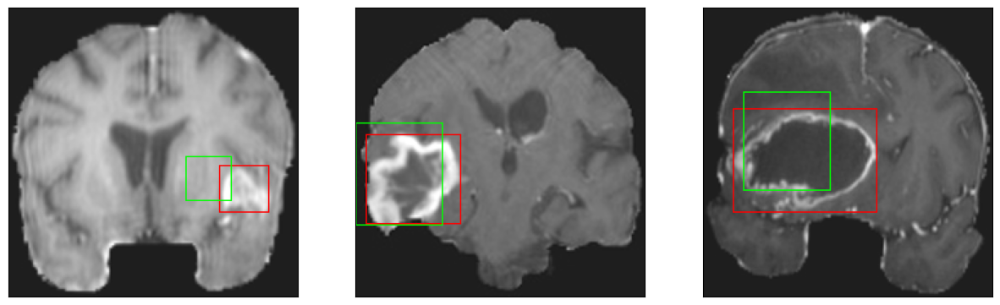

26/26 [==============================] - 7s 288ms/step - loss: 7.6854 - IoU: 0.4936 - val_loss: 11.1524 - val_IoU: 0.3787
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.3674 - IoU: 0.4998
Epoch 58: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


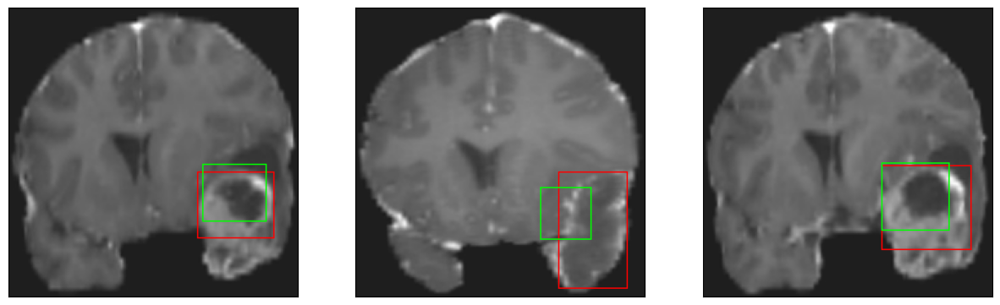

26/26 [==============================] - 8s 314ms/step - loss: 7.3674 - IoU: 0.4998 - val_loss: 10.5286 - val_IoU: 0.4063
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.4723 - IoU: 0.4978
Epoch 59: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


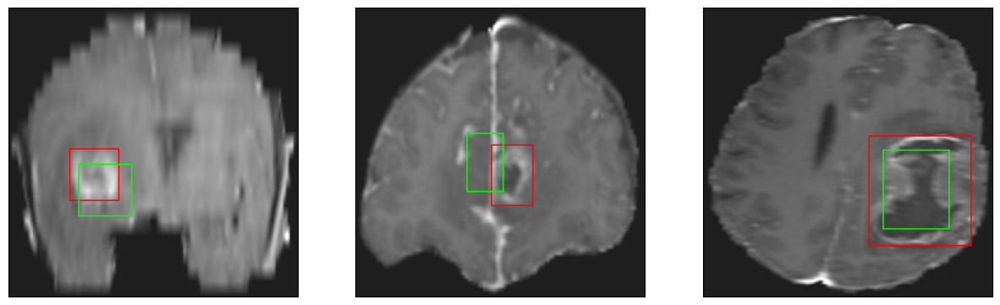

26/26 [==============================] - 8s 304ms/step - loss: 7.4723 - IoU: 0.4978 - val_loss: 10.2380 - val_IoU: 0.3974
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.6751 - IoU: 0.4901
Epoch 60: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


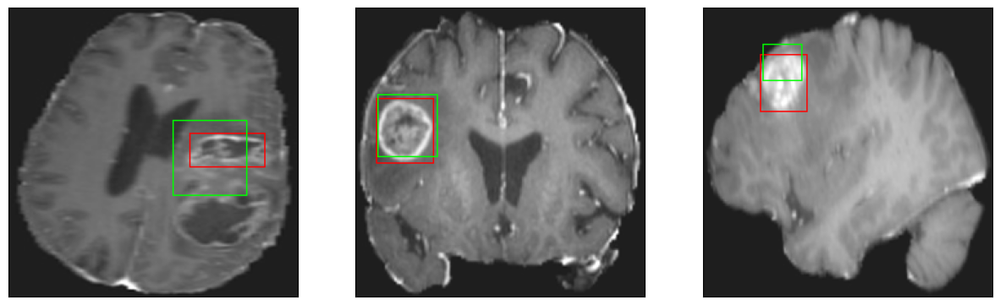

26/26 [==============================] - 7s 282ms/step - loss: 7.6751 - IoU: 0.4901 - val_loss: 9.2907 - val_IoU: 0.4457
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.6271 - IoU: 0.4834
Epoch 61: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


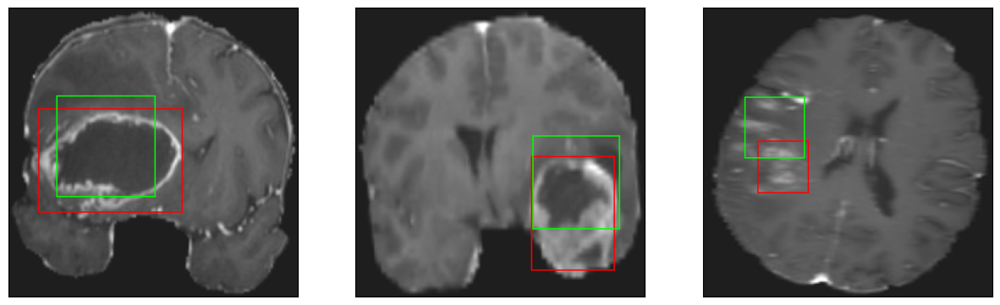

26/26 [==============================] - 8s 297ms/step - loss: 7.6271 - IoU: 0.4834 - val_loss: 9.5390 - val_IoU: 0.4505
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.4812 - IoU: 0.4948
Epoch 62: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


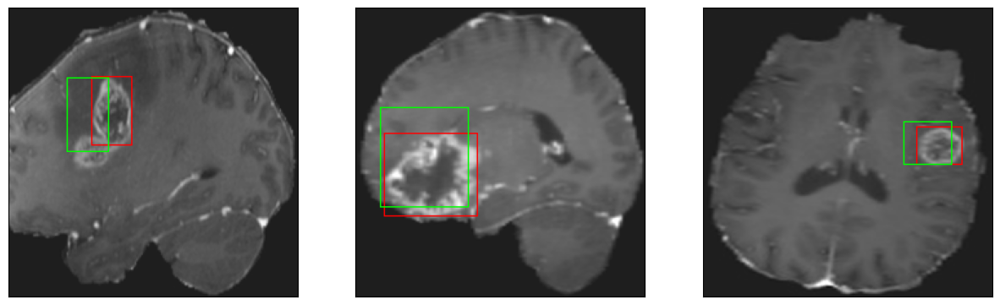

26/26 [==============================] - 8s 296ms/step - loss: 7.4812 - IoU: 0.4948 - val_loss: 10.3566 - val_IoU: 0.4090
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.3696 - IoU: 0.4972
Epoch 63: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


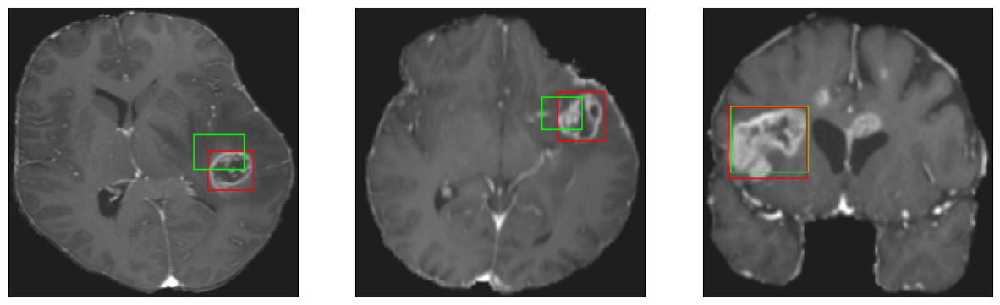

26/26 [==============================] - 7s 276ms/step - loss: 7.3696 - IoU: 0.4972 - val_loss: 9.6801 - val_IoU: 0.4186
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.4664 - IoU: 0.4991
Epoch 64: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


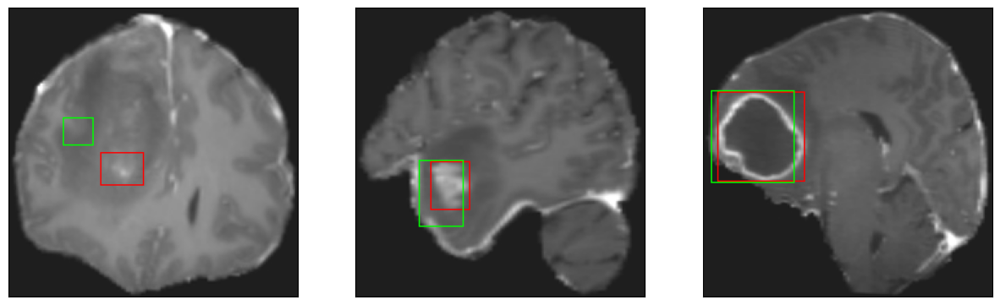

26/26 [==============================] - 7s 271ms/step - loss: 7.4664 - IoU: 0.4991 - val_loss: 9.1657 - val_IoU: 0.4423
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.3928 - IoU: 0.4990
Epoch 65: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


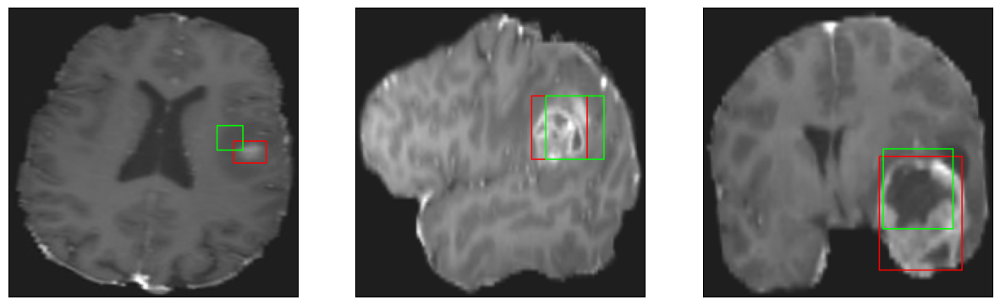

26/26 [==============================] - 8s 314ms/step - loss: 7.3928 - IoU: 0.4990 - val_loss: 9.8259 - val_IoU: 0.4172
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.3071 - IoU: 0.5028
Epoch 66: val_IoU did not improve from 0.46446
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


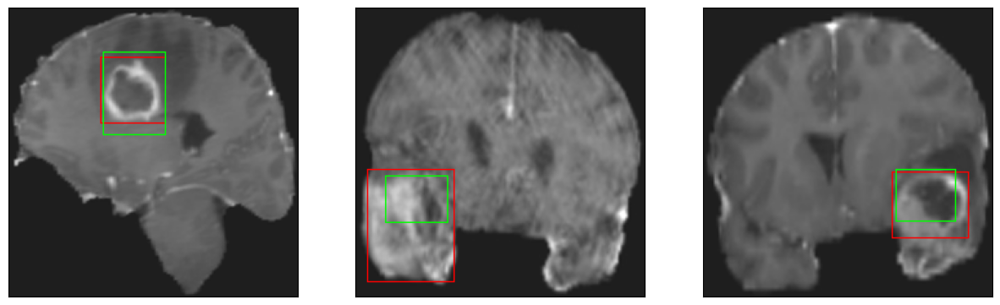

26/26 [==============================] - 7s 283ms/step - loss: 7.3071 - IoU: 0.5028 - val_loss: 9.2284 - val_IoU: 0.4477
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.0529 - IoU: 0.5121
Epoch 67: val_IoU improved from 0.46446 to 0.46878, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


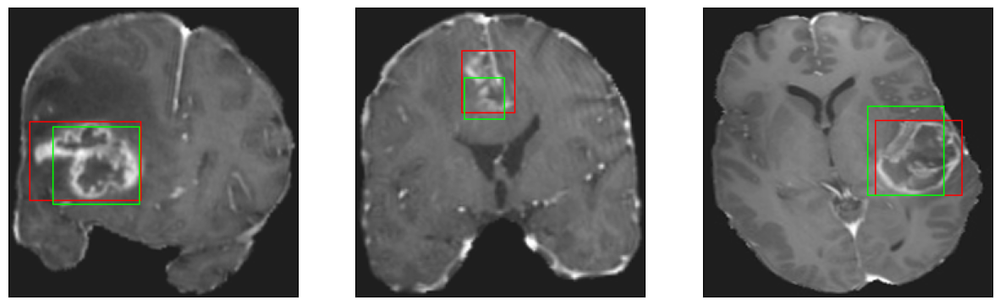

26/26 [==============================] - 25s 982ms/step - loss: 7.0529 - IoU: 0.5121 - val_loss: 9.3293 - val_IoU: 0.4688
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.4431 - IoU: 0.5017
Epoch 68: val_IoU did not improve from 0.46878
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


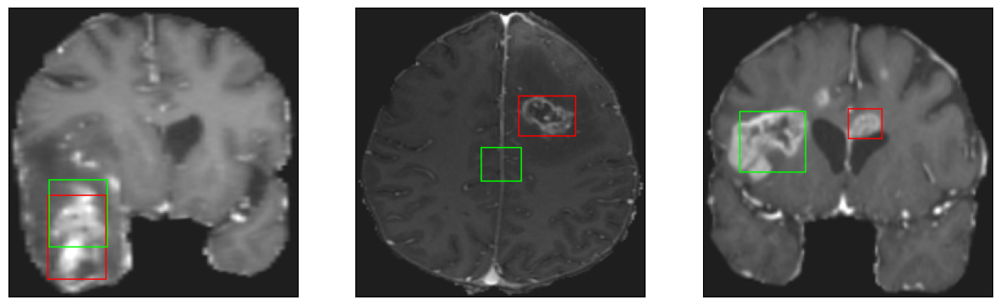

26/26 [==============================] - 8s 326ms/step - loss: 7.4431 - IoU: 0.5017 - val_loss: 9.2024 - val_IoU: 0.4407
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 6.9419 - IoU: 0.5196
Epoch 69: val_IoU did not improve from 0.46878
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4


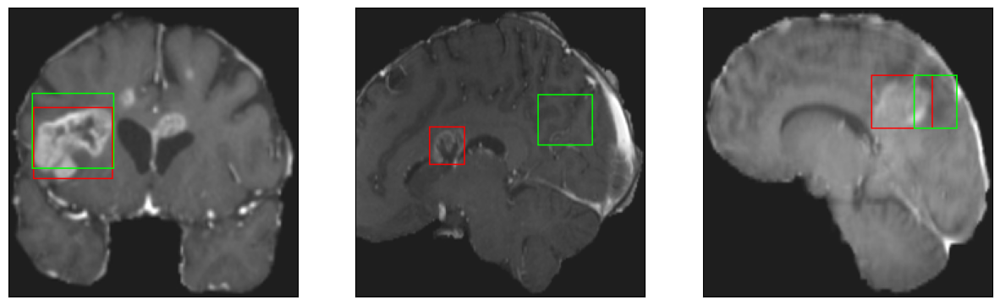

26/26 [==============================] - 9s 339ms/step - loss: 6.9419 - IoU: 0.5196 - val_loss: 9.5327 - val_IoU: 0.4097
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 6.9879 - IoU: 0.5113
Epoch 70: val_IoU improved from 0.46878 to 0.47070, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


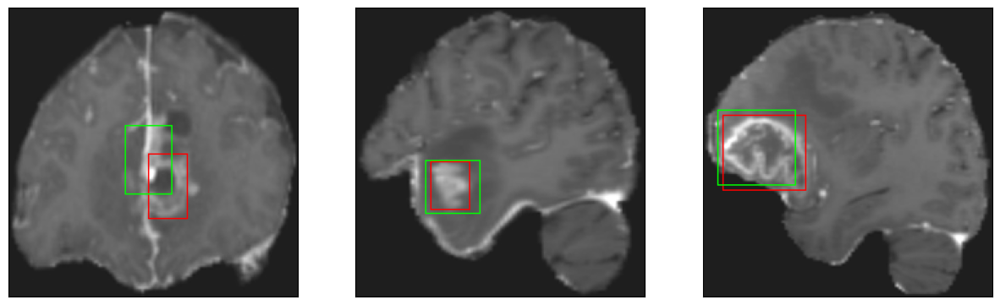

26/26 [==============================] - 22s 850ms/step - loss: 6.9879 - IoU: 0.5113 - val_loss: 8.8131 - val_IoU: 0.4707
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.3044 - IoU: 0.5031
Epoch 71: val_IoU improved from 0.47070 to 0.48132, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


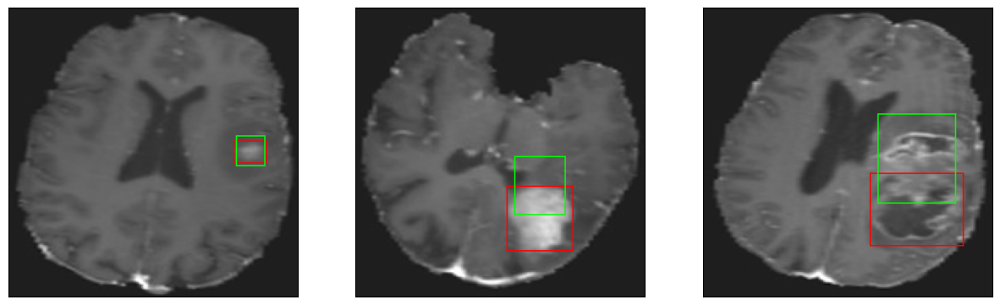

26/26 [==============================] - 21s 820ms/step - loss: 7.3044 - IoU: 0.5031 - val_loss: 8.7403 - val_IoU: 0.4813
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 6.9340 - IoU: 0.5146
Epoch 72: val_IoU did not improve from 0.48132
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


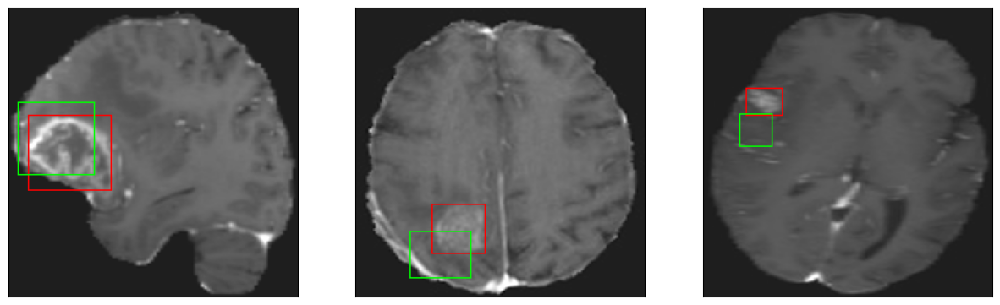

26/26 [==============================] - 8s 303ms/step - loss: 6.9340 - IoU: 0.5146 - val_loss: 9.0644 - val_IoU: 0.4484
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.2946 - IoU: 0.5024
Epoch 73: val_IoU did not improve from 0.48132
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


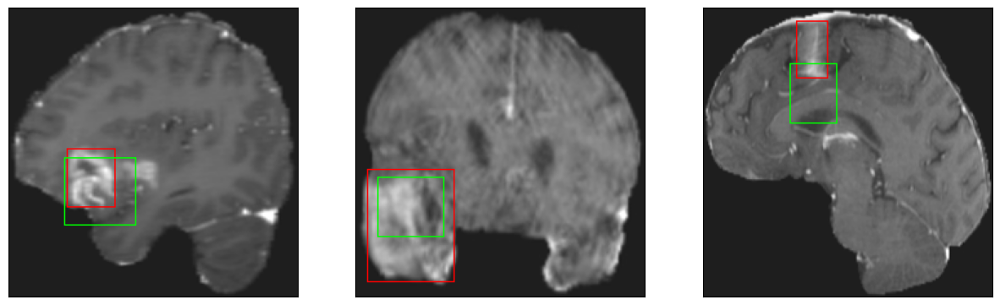

26/26 [==============================] - 8s 292ms/step - loss: 7.2946 - IoU: 0.5024 - val_loss: 8.9258 - val_IoU: 0.4722
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.0410 - IoU: 0.5105
Epoch 74: val_IoU did not improve from 0.48132
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


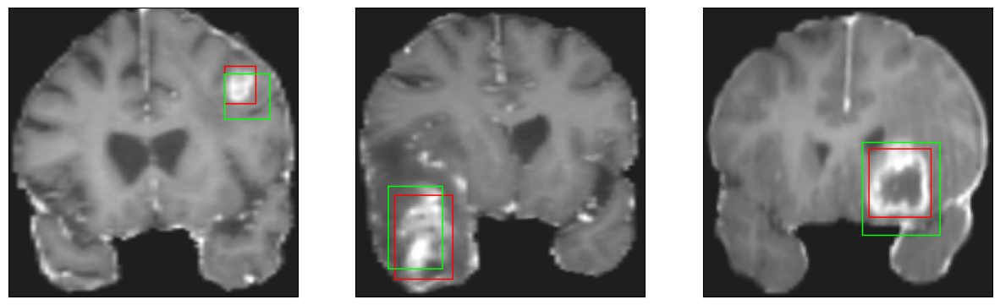

26/26 [==============================] - 8s 308ms/step - loss: 7.0410 - IoU: 0.5105 - val_loss: 9.0162 - val_IoU: 0.4807
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.3149 - IoU: 0.5064
Epoch 75: val_IoU did not improve from 0.48132
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


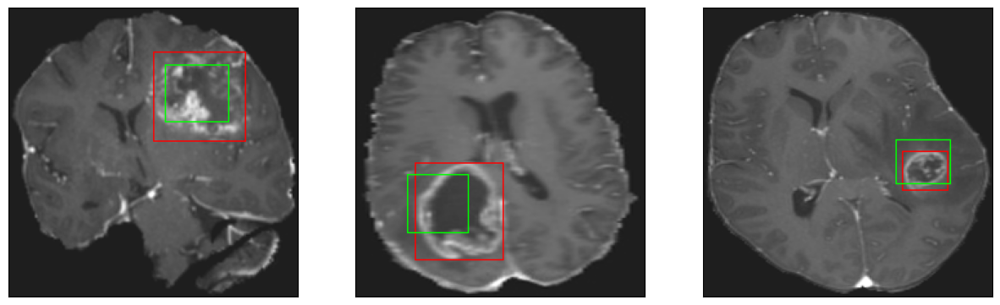

26/26 [==============================] - 8s 317ms/step - loss: 7.3149 - IoU: 0.5064 - val_loss: 10.7568 - val_IoU: 0.3767
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.4592 - IoU: 0.4918
Epoch 76: val_IoU improved from 0.48132 to 0.49229, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


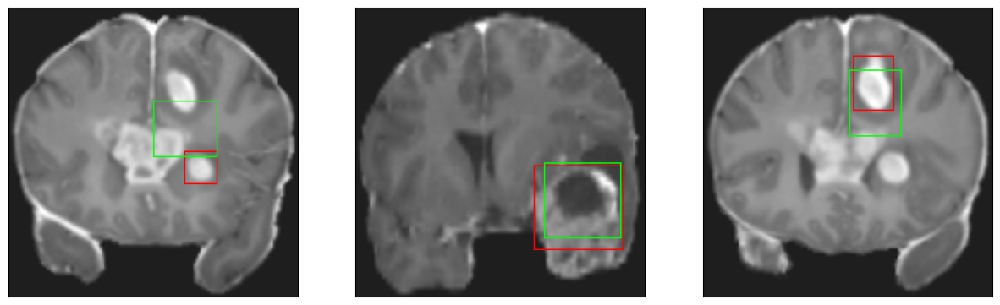

26/26 [==============================] - 18s 724ms/step - loss: 7.4592 - IoU: 0.4918 - val_loss: 8.6253 - val_IoU: 0.4923
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 7.4950 - IoU: 0.4945
Epoch 77: val_IoU did not improve from 0.49229
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


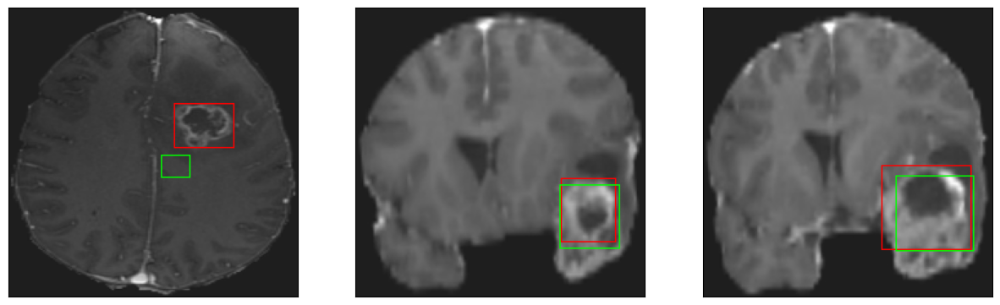

26/26 [==============================] - 8s 298ms/step - loss: 7.4950 - IoU: 0.4945 - val_loss: 9.7211 - val_IoU: 0.4189
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.2914 - IoU: 0.4982
Epoch 78: val_IoU did not improve from 0.49229
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


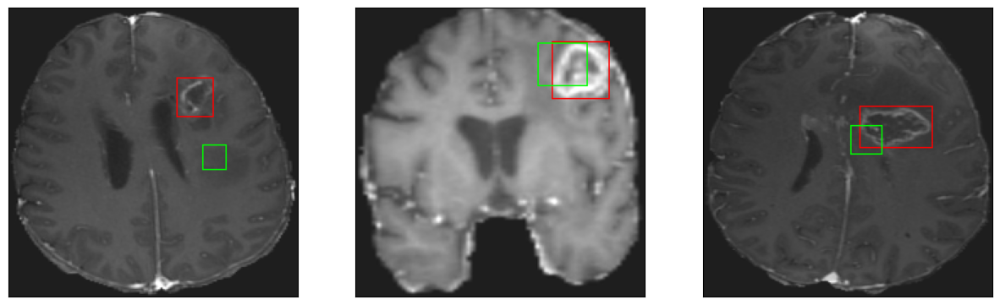

26/26 [==============================] - 7s 288ms/step - loss: 7.2914 - IoU: 0.4982 - val_loss: 9.6661 - val_IoU: 0.4404
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.0085 - IoU: 0.5100
Epoch 79: val_IoU did not improve from 0.49229
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


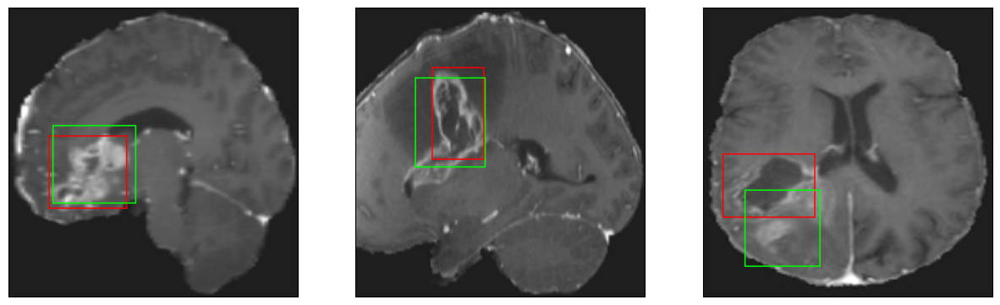

26/26 [==============================] - 8s 324ms/step - loss: 7.0085 - IoU: 0.5100 - val_loss: 9.4930 - val_IoU: 0.4734
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 6.7618 - IoU: 0.5218
Epoch 80: val_IoU did not improve from 0.49229
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


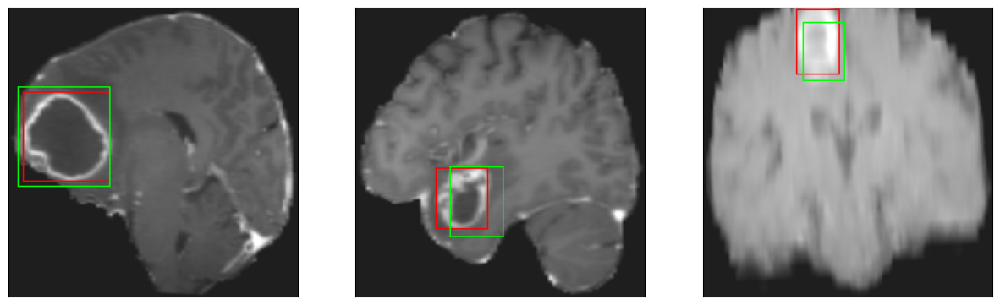

26/26 [==============================] - 7s 275ms/step - loss: 6.7618 - IoU: 0.5218 - val_loss: 8.6994 - val_IoU: 0.4837
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.9555 - IoU: 0.5157
Epoch 81: val_IoU did not improve from 0.49229
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


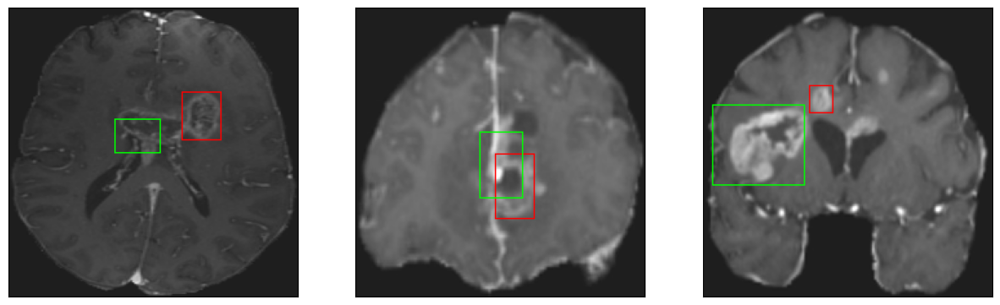

26/26 [==============================] - 8s 300ms/step - loss: 6.9555 - IoU: 0.5157 - val_loss: 9.0777 - val_IoU: 0.4665
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.8460 - IoU: 0.5189
Epoch 82: val_IoU improved from 0.49229 to 0.50487, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


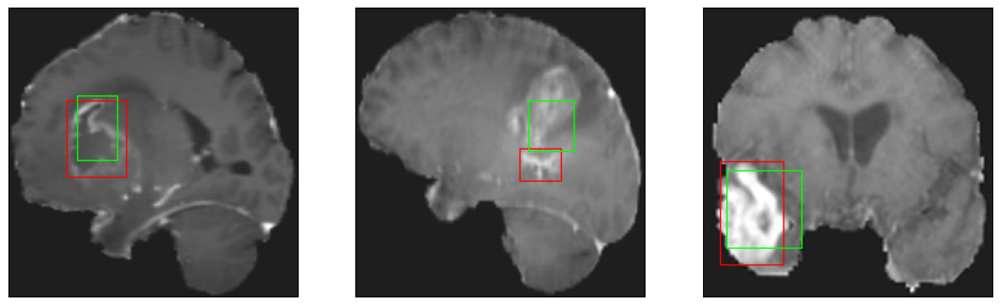

26/26 [==============================] - 22s 863ms/step - loss: 6.8460 - IoU: 0.5189 - val_loss: 8.5611 - val_IoU: 0.5049
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.5726 - IoU: 0.5271
Epoch 83: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


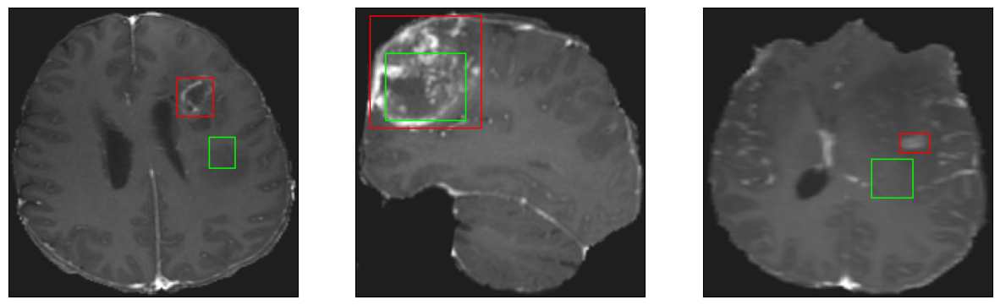

26/26 [==============================] - 7s 288ms/step - loss: 6.5726 - IoU: 0.5271 - val_loss: 8.8162 - val_IoU: 0.4730
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.6207 - IoU: 0.5331
Epoch 84: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


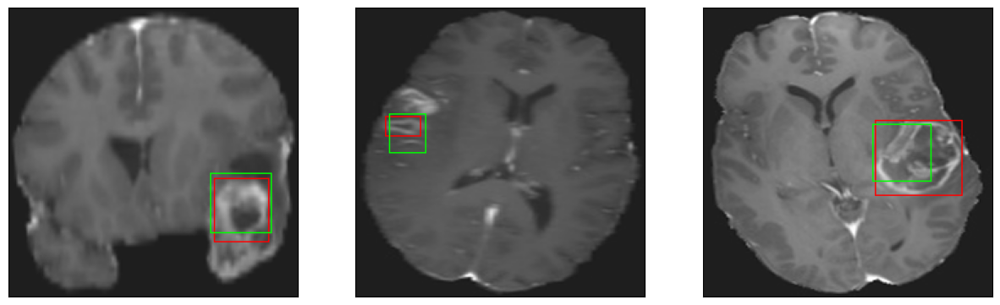

26/26 [==============================] - 8s 300ms/step - loss: 6.6207 - IoU: 0.5331 - val_loss: 9.3455 - val_IoU: 0.4411
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.7469 - IoU: 0.5195
Epoch 85: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


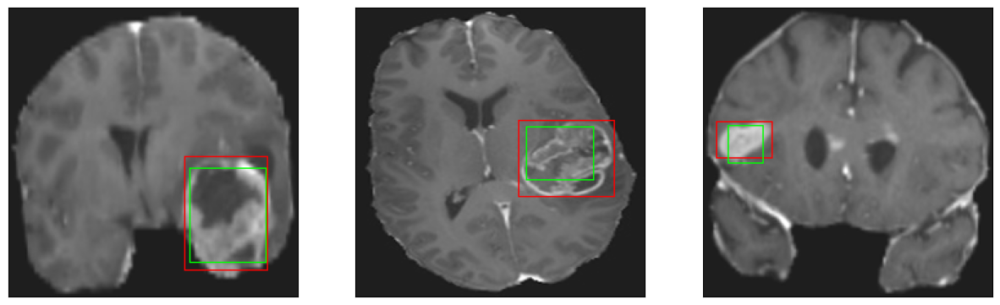

26/26 [==============================] - 8s 309ms/step - loss: 6.7469 - IoU: 0.5195 - val_loss: 8.7811 - val_IoU: 0.4662
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.6406 - IoU: 0.5297
Epoch 86: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


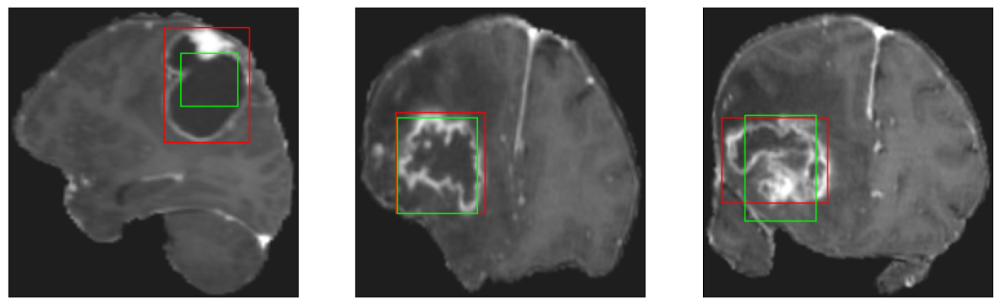

26/26 [==============================] - 8s 316ms/step - loss: 6.6406 - IoU: 0.5297 - val_loss: 9.0089 - val_IoU: 0.5010
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.8251 - IoU: 0.5132
Epoch 87: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


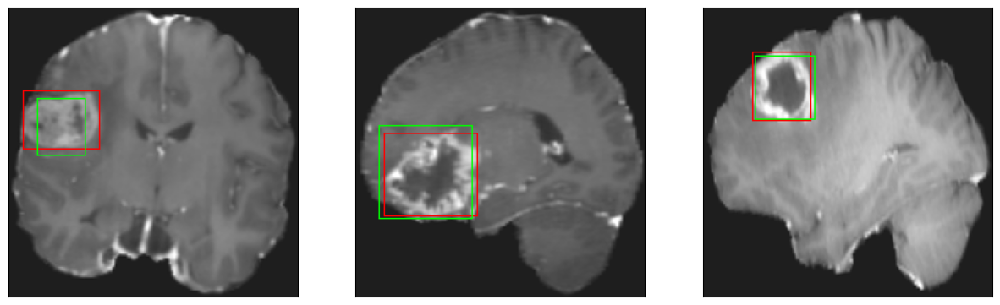

26/26 [==============================] - 8s 308ms/step - loss: 6.8251 - IoU: 0.5132 - val_loss: 9.9705 - val_IoU: 0.4232
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.6125 - IoU: 0.5434
Epoch 88: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


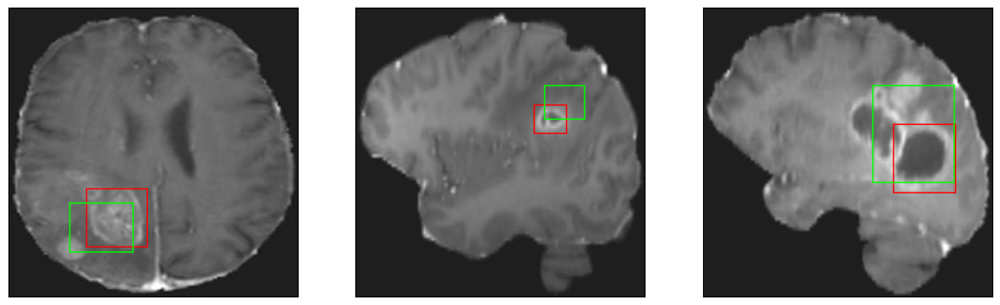

26/26 [==============================] - 8s 314ms/step - loss: 6.6125 - IoU: 0.5434 - val_loss: 9.1107 - val_IoU: 0.4557
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.8359 - IoU: 0.5249
Epoch 89: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


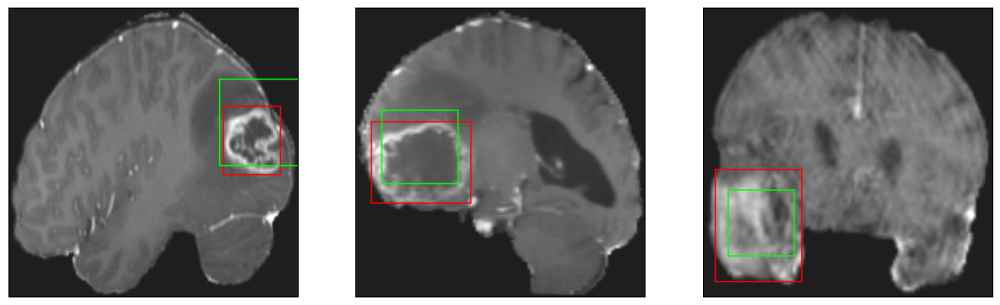

26/26 [==============================] - 8s 316ms/step - loss: 6.8359 - IoU: 0.5249 - val_loss: 8.8266 - val_IoU: 0.4757
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.6577 - IoU: 0.5245
Epoch 90: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


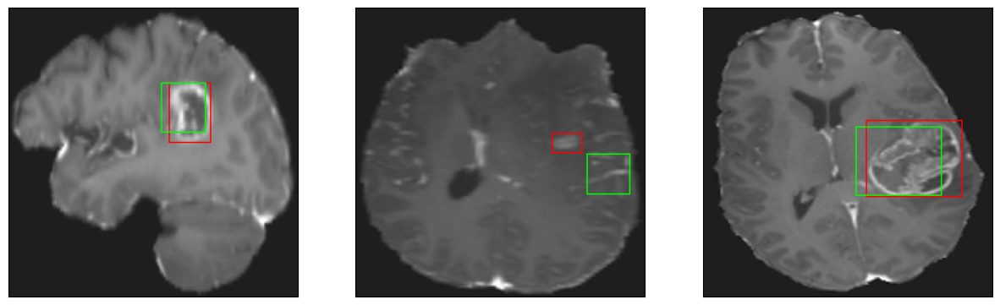

26/26 [==============================] - 8s 324ms/step - loss: 6.6577 - IoU: 0.5245 - val_loss: 9.2652 - val_IoU: 0.4832
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.8939 - IoU: 0.5164
Epoch 91: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


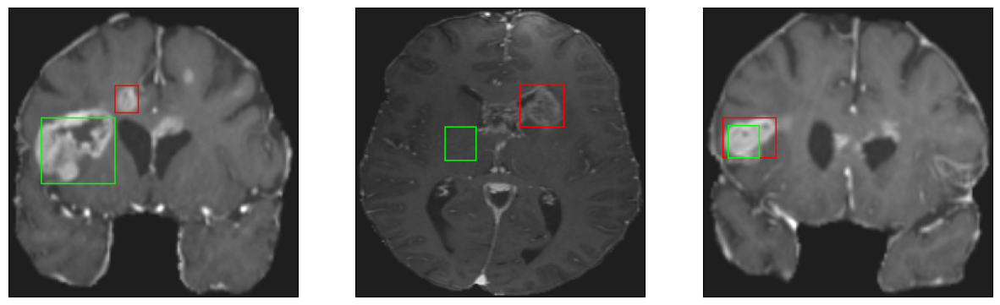

26/26 [==============================] - 8s 316ms/step - loss: 6.8939 - IoU: 0.5164 - val_loss: 8.5310 - val_IoU: 0.4626
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.4802 - IoU: 0.5284
Epoch 92: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


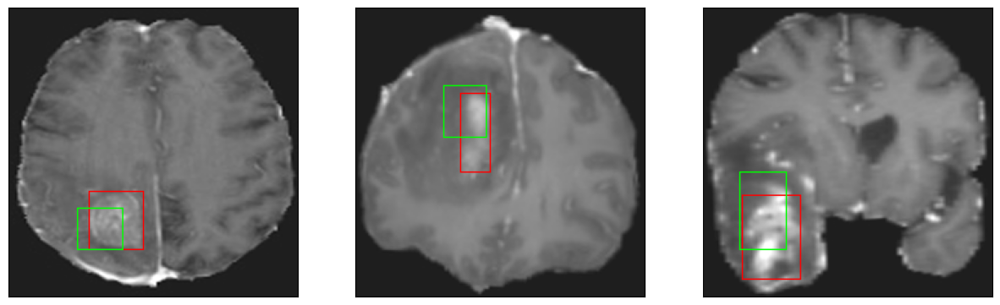

26/26 [==============================] - 8s 295ms/step - loss: 6.4802 - IoU: 0.5284 - val_loss: 8.7608 - val_IoU: 0.4614
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.3901 - IoU: 0.5392
Epoch 93: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


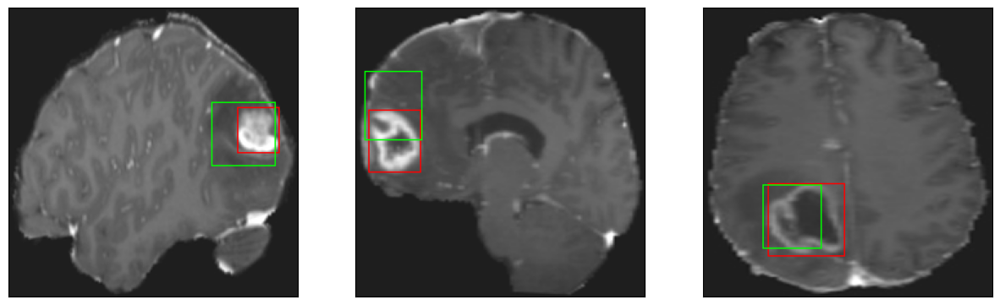

26/26 [==============================] - 7s 276ms/step - loss: 6.3901 - IoU: 0.5392 - val_loss: 8.9690 - val_IoU: 0.4477
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.3959 - IoU: 0.5456
Epoch 94: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


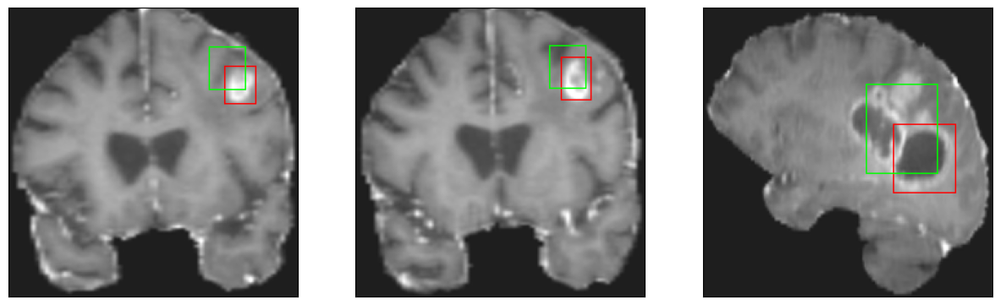

26/26 [==============================] - 8s 316ms/step - loss: 6.3959 - IoU: 0.5456 - val_loss: 7.9976 - val_IoU: 0.4973
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.3860 - IoU: 0.5373
Epoch 95: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


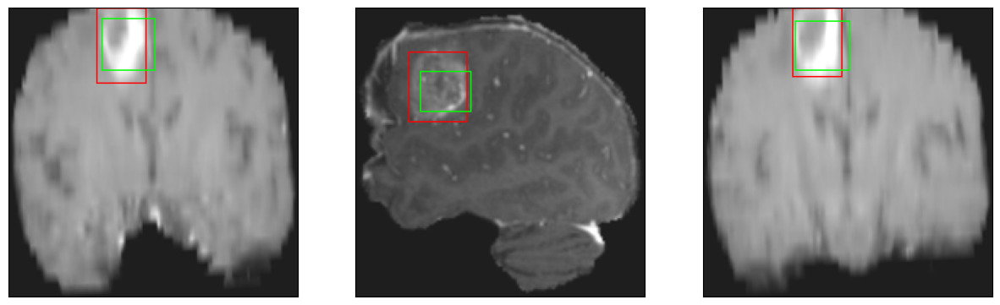

26/26 [==============================] - 8s 306ms/step - loss: 6.3860 - IoU: 0.5373 - val_loss: 8.6764 - val_IoU: 0.4767
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.1761 - IoU: 0.5479
Epoch 96: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


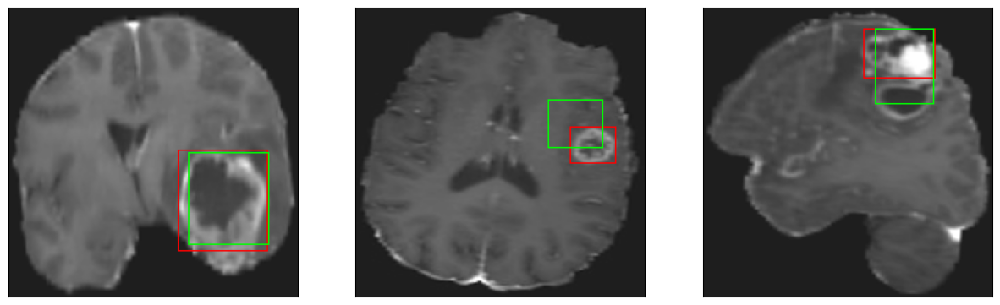

26/26 [==============================] - 8s 310ms/step - loss: 6.1761 - IoU: 0.5479 - val_loss: 9.0524 - val_IoU: 0.4701
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.1843 - IoU: 0.5522
Epoch 97: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


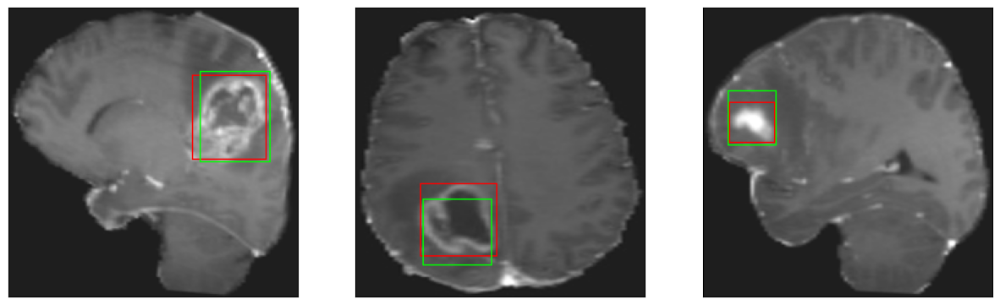

26/26 [==============================] - 7s 284ms/step - loss: 6.1843 - IoU: 0.5522 - val_loss: 9.0846 - val_IoU: 0.4358
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.3916 - IoU: 0.5407
Epoch 98: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


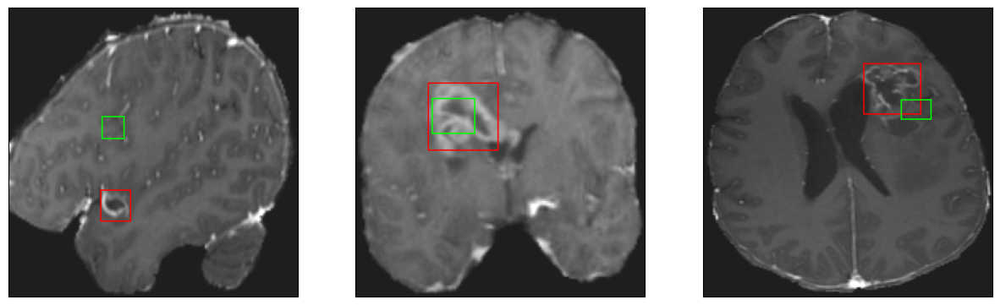

26/26 [==============================] - 8s 307ms/step - loss: 6.3916 - IoU: 0.5407 - val_loss: 9.6104 - val_IoU: 0.4327
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.6992 - IoU: 0.5207
Epoch 99: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


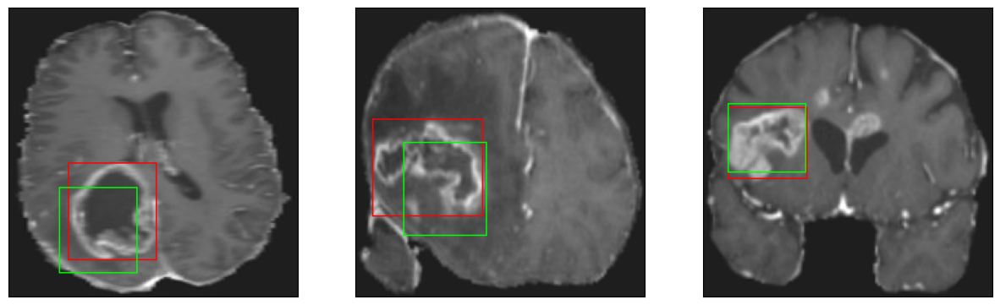

26/26 [==============================] - 8s 309ms/step - loss: 6.6992 - IoU: 0.5207 - val_loss: 8.1877 - val_IoU: 0.4960
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.2003 - IoU: 0.5497
Epoch 100: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


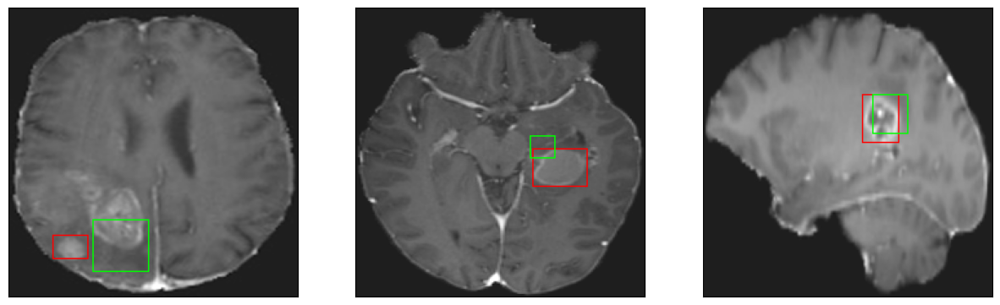

26/26 [==============================] - 8s 296ms/step - loss: 6.2003 - IoU: 0.5497 - val_loss: 8.8544 - val_IoU: 0.4684
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.1531 - IoU: 0.5488
Epoch 101: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


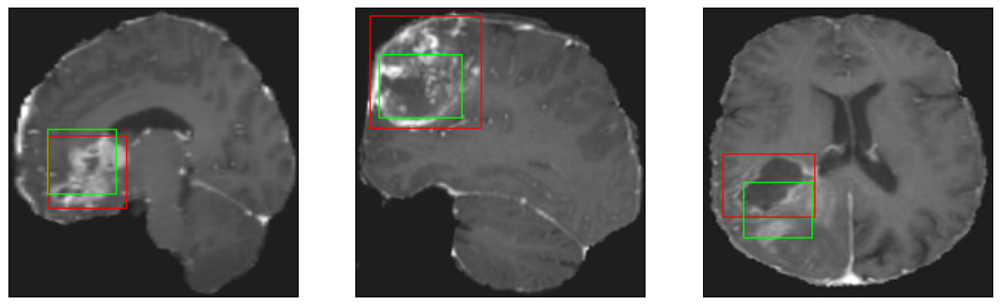

26/26 [==============================] - 7s 287ms/step - loss: 6.1531 - IoU: 0.5488 - val_loss: 9.1856 - val_IoU: 0.4654
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.0941 - IoU: 0.5579
Epoch 102: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


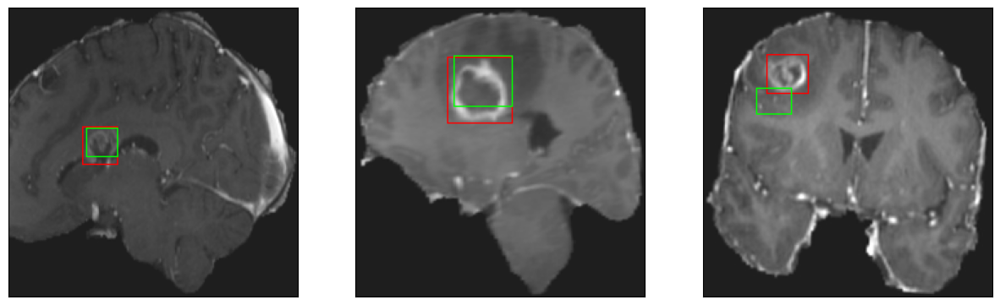

26/26 [==============================] - 8s 309ms/step - loss: 6.0941 - IoU: 0.5579 - val_loss: 10.2894 - val_IoU: 0.4406
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.2143 - IoU: 0.5431
Epoch 103: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


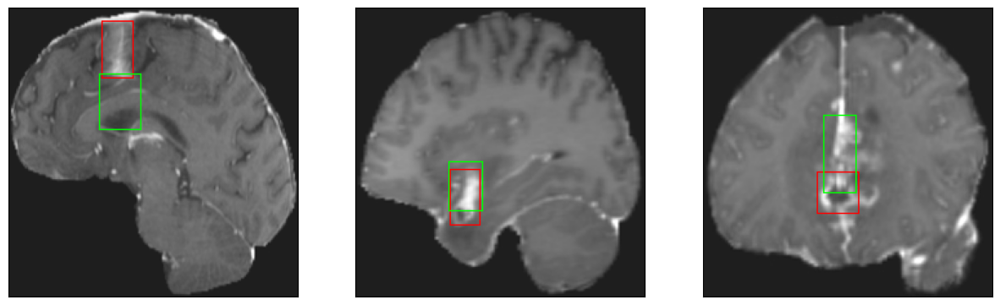

26/26 [==============================] - 7s 279ms/step - loss: 6.2143 - IoU: 0.5431 - val_loss: 9.3224 - val_IoU: 0.4694
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.2495 - IoU: 0.5441
Epoch 104: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


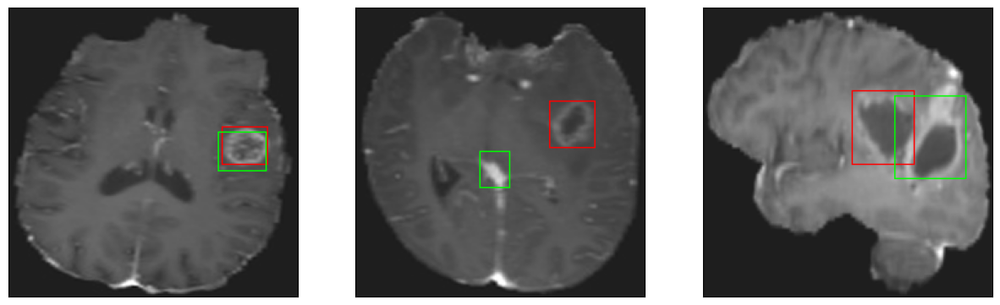

26/26 [==============================] - 7s 280ms/step - loss: 6.2495 - IoU: 0.5441 - val_loss: 8.7359 - val_IoU: 0.4817
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.4034 - IoU: 0.5425
Epoch 105: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


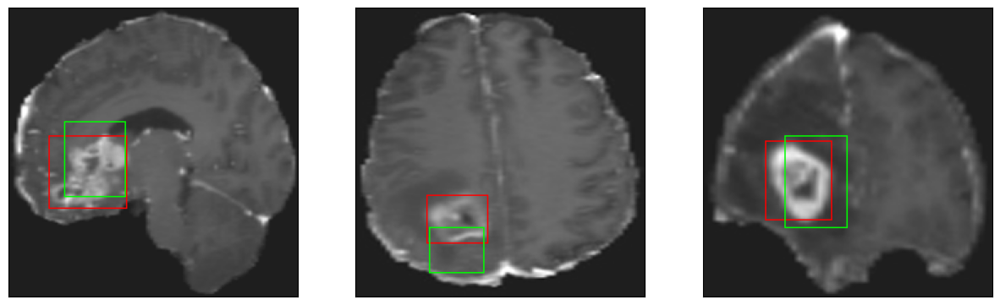

26/26 [==============================] - 8s 314ms/step - loss: 6.4034 - IoU: 0.5425 - val_loss: 8.6639 - val_IoU: 0.4730
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.1125 - IoU: 0.5422
Epoch 106: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


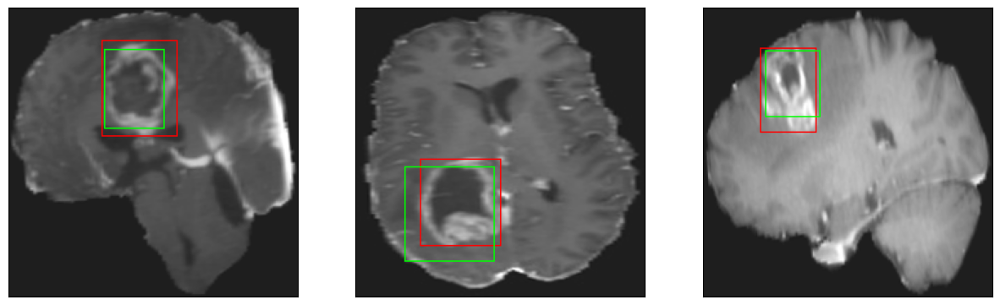

26/26 [==============================] - 8s 291ms/step - loss: 6.1125 - IoU: 0.5422 - val_loss: 9.2415 - val_IoU: 0.4533
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 5.9466 - IoU: 0.5592
Epoch 107: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


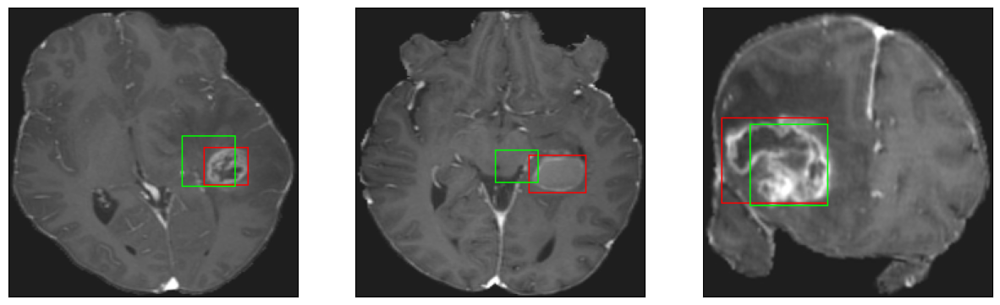

26/26 [==============================] - 7s 282ms/step - loss: 5.9466 - IoU: 0.5592 - val_loss: 8.6913 - val_IoU: 0.4867
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 5.9488 - IoU: 0.5618
Epoch 108: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


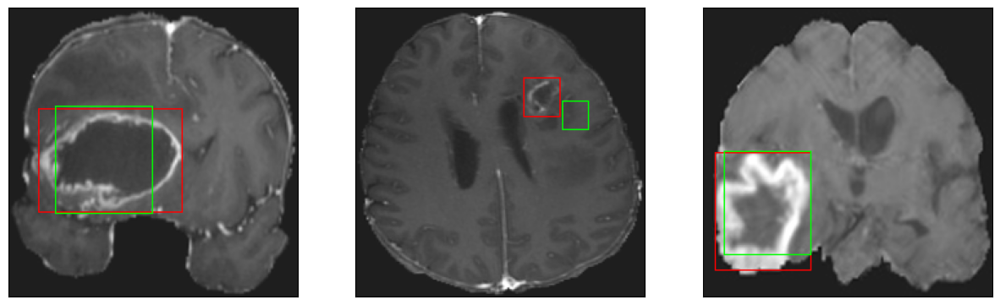

26/26 [==============================] - 8s 296ms/step - loss: 5.9488 - IoU: 0.5618 - val_loss: 8.3773 - val_IoU: 0.4869
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.1813 - IoU: 0.5484
Epoch 109: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


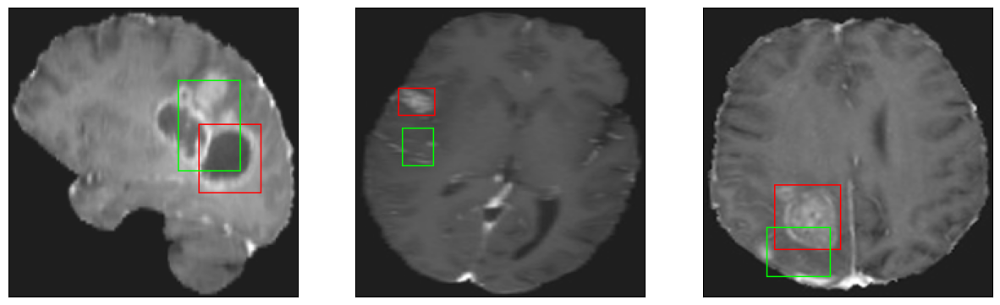

26/26 [==============================] - 8s 292ms/step - loss: 6.1813 - IoU: 0.5484 - val_loss: 9.8524 - val_IoU: 0.4228
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.4785 - IoU: 0.5297
Epoch 110: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


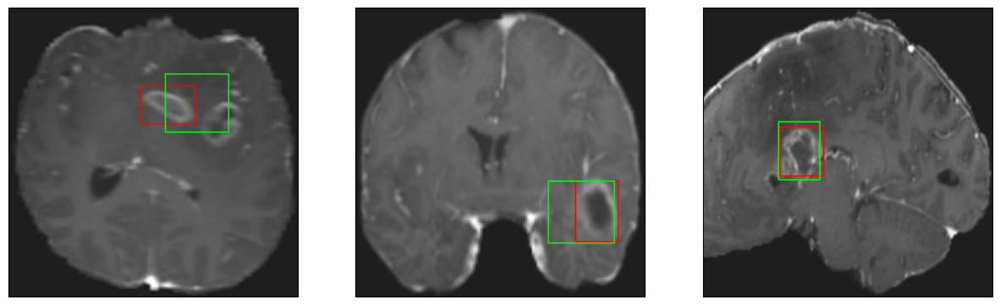

26/26 [==============================] - 8s 302ms/step - loss: 6.4785 - IoU: 0.5297 - val_loss: 9.1850 - val_IoU: 0.4758
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.1324 - IoU: 0.5525
Epoch 111: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


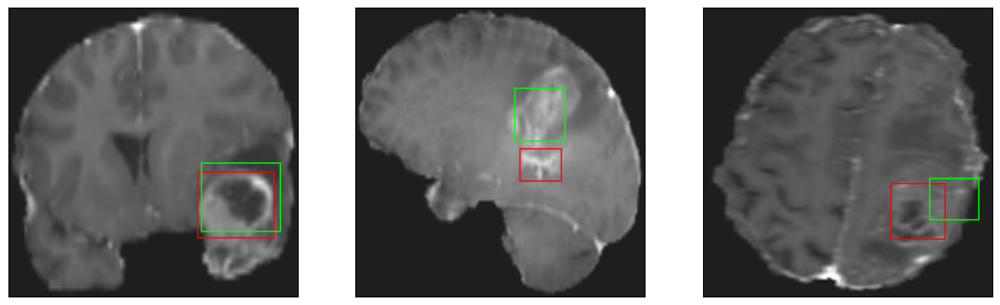

26/26 [==============================] - 7s 275ms/step - loss: 6.1324 - IoU: 0.5525 - val_loss: 8.4062 - val_IoU: 0.4924
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.3800 - IoU: 0.5469
Epoch 112: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


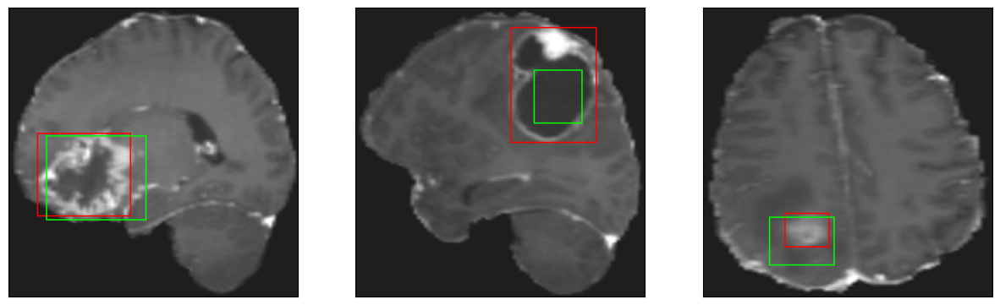

26/26 [==============================] - 8s 299ms/step - loss: 6.3800 - IoU: 0.5469 - val_loss: 8.3978 - val_IoU: 0.5022
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 5.9490 - IoU: 0.5677
Epoch 113: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


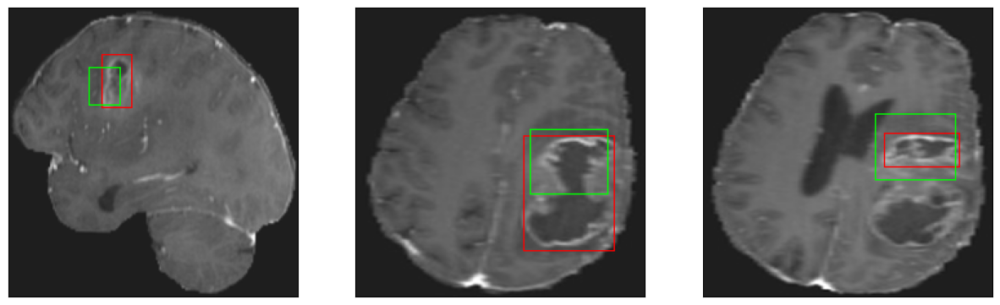

26/26 [==============================] - 8s 317ms/step - loss: 5.9490 - IoU: 0.5677 - val_loss: 9.0466 - val_IoU: 0.4444
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.0823 - IoU: 0.5569
Epoch 114: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


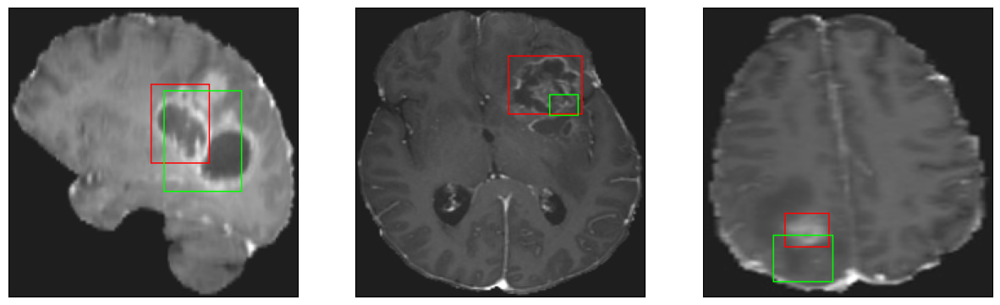

26/26 [==============================] - 8s 313ms/step - loss: 6.0823 - IoU: 0.5569 - val_loss: 9.1404 - val_IoU: 0.4235
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.1462 - IoU: 0.5487
Epoch 115: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


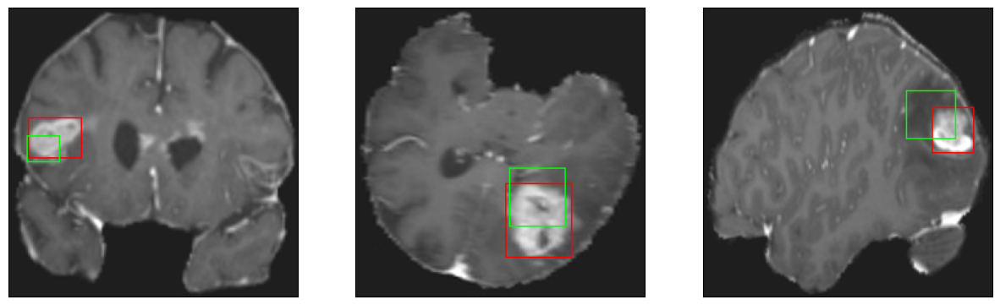

26/26 [==============================] - 8s 307ms/step - loss: 6.1462 - IoU: 0.5487 - val_loss: 8.6879 - val_IoU: 0.4750
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 5.7456 - IoU: 0.5650
Epoch 116: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


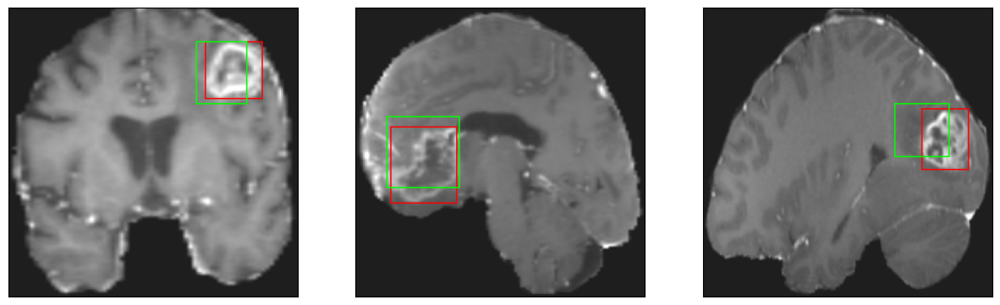

26/26 [==============================] - 8s 301ms/step - loss: 5.7456 - IoU: 0.5650 - val_loss: 8.1494 - val_IoU: 0.4973
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 5.8902 - IoU: 0.5585
Epoch 117: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


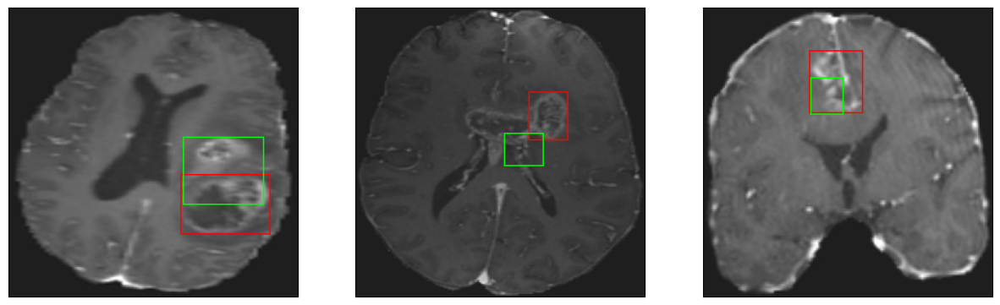

26/26 [==============================] - 8s 301ms/step - loss: 5.8902 - IoU: 0.5585 - val_loss: 8.4846 - val_IoU: 0.4883
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 5.7718 - IoU: 0.5676
Epoch 118: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


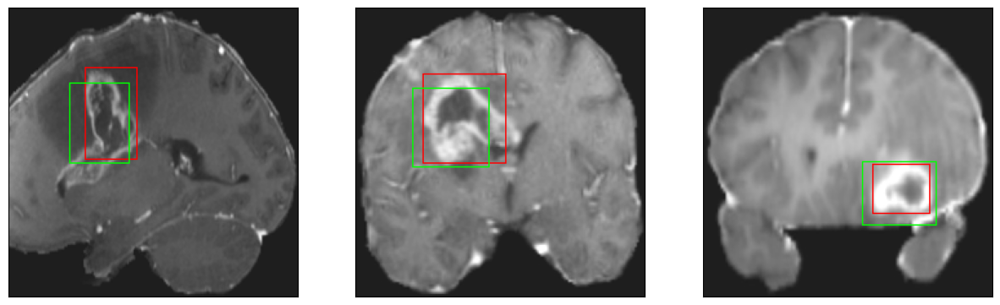

26/26 [==============================] - 8s 319ms/step - loss: 5.7718 - IoU: 0.5676 - val_loss: 8.4860 - val_IoU: 0.4856
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 5.7316 - IoU: 0.5694
Epoch 119: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


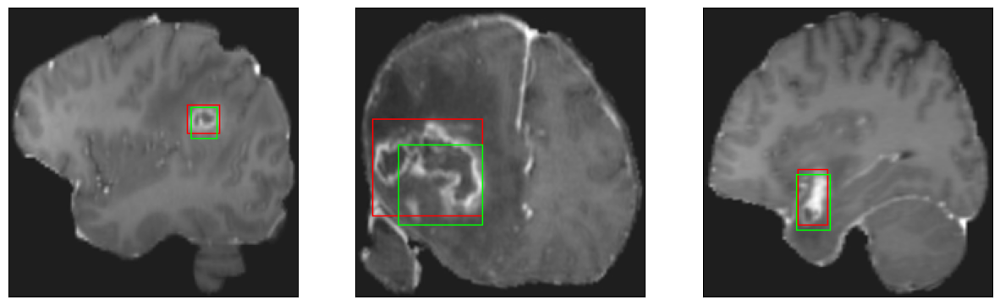

26/26 [==============================] - 7s 285ms/step - loss: 5.7316 - IoU: 0.5694 - val_loss: 9.7259 - val_IoU: 0.4405
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.1583 - IoU: 0.5409
Epoch 120: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


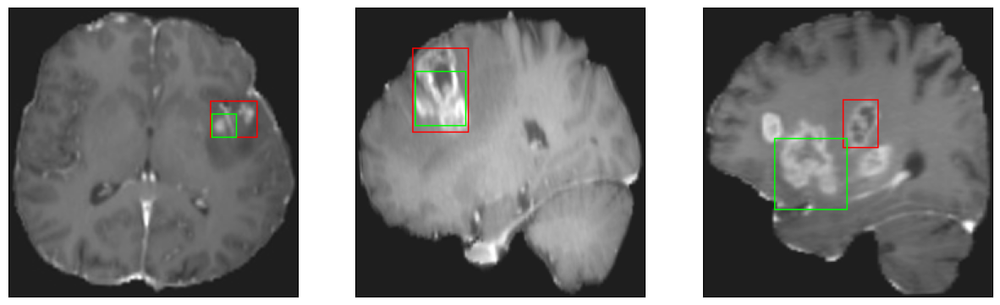

26/26 [==============================] - 8s 295ms/step - loss: 6.1583 - IoU: 0.5409 - val_loss: 8.9693 - val_IoU: 0.4632
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.0023 - IoU: 0.5515
Epoch 121: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


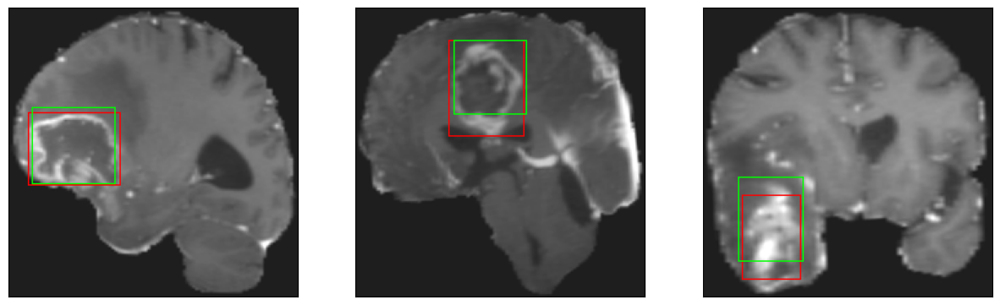

26/26 [==============================] - 7s 289ms/step - loss: 6.0023 - IoU: 0.5515 - val_loss: 8.7162 - val_IoU: 0.4777
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.3317 - IoU: 0.5361
Epoch 122: val_IoU did not improve from 0.50487
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


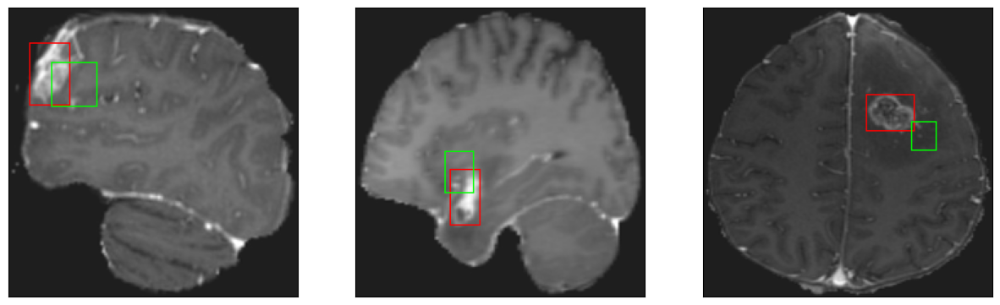

26/26 [==============================] - 8s 307ms/step - loss: 6.3317 - IoU: 0.5361 - val_loss: 8.4748 - val_IoU: 0.4807
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.2107 - IoU: 0.5461
Epoch 123: val_IoU improved from 0.50487 to 0.51141, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


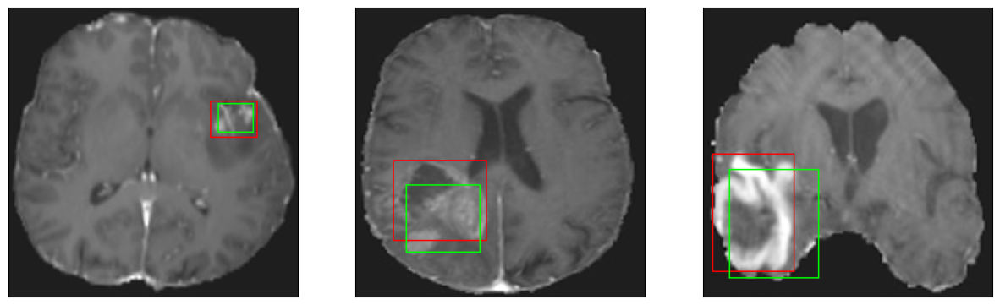

26/26 [==============================] - 20s 775ms/step - loss: 6.2107 - IoU: 0.5461 - val_loss: 8.0974 - val_IoU: 0.5114
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 6.3753 - IoU: 0.5397
Epoch 124: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


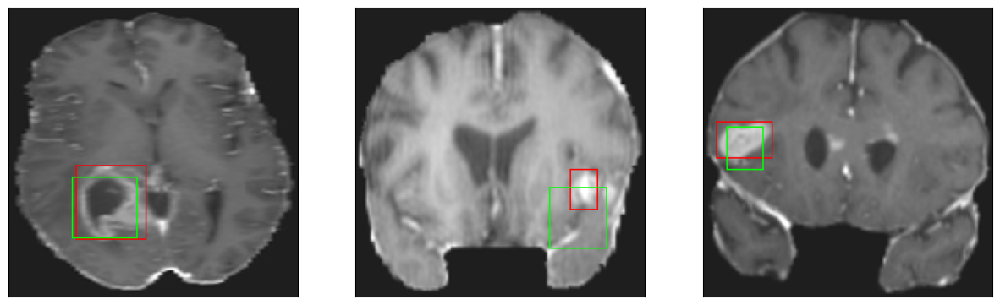

26/26 [==============================] - 8s 297ms/step - loss: 6.3753 - IoU: 0.5397 - val_loss: 8.1614 - val_IoU: 0.4959
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 5.9219 - IoU: 0.5596
Epoch 125: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 46ms/step
4


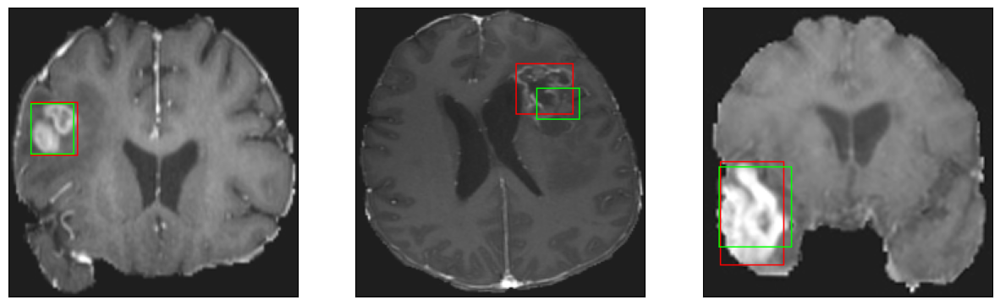

26/26 [==============================] - 8s 328ms/step - loss: 5.9219 - IoU: 0.5596 - val_loss: 8.8126 - val_IoU: 0.4954
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.0253 - IoU: 0.5551
Epoch 126: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


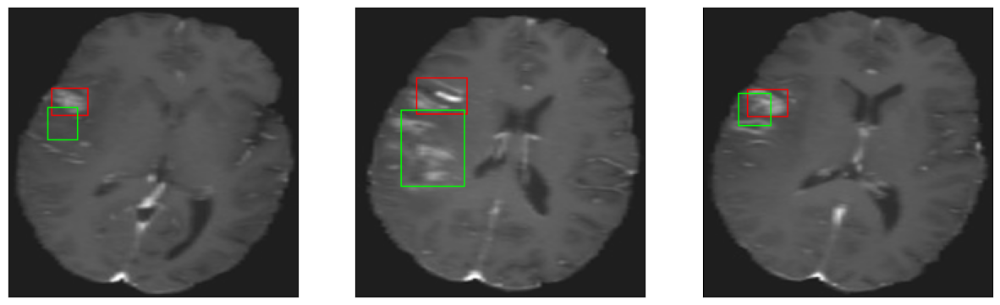

26/26 [==============================] - 8s 303ms/step - loss: 6.0253 - IoU: 0.5551 - val_loss: 8.3820 - val_IoU: 0.4970
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.0485 - IoU: 0.5524
Epoch 127: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


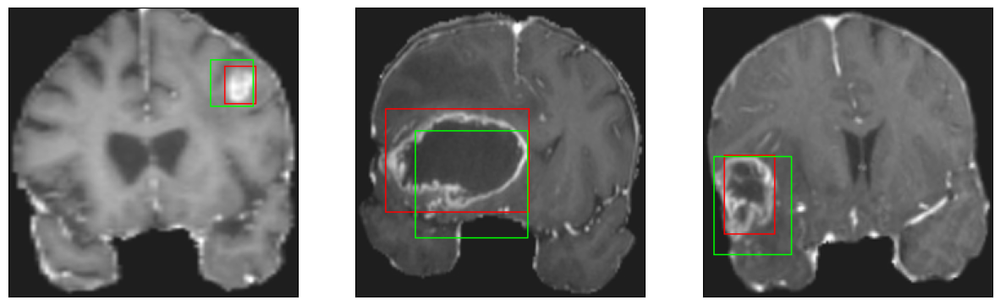

26/26 [==============================] - 8s 293ms/step - loss: 6.0485 - IoU: 0.5524 - val_loss: 8.7140 - val_IoU: 0.4987
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 5.9064 - IoU: 0.5600
Epoch 128: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


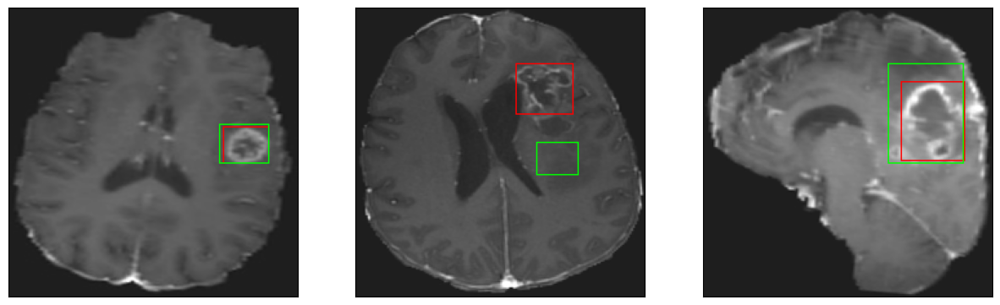

26/26 [==============================] - 7s 289ms/step - loss: 5.9064 - IoU: 0.5600 - val_loss: 9.0923 - val_IoU: 0.4465
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 5.8364 - IoU: 0.5658
Epoch 129: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


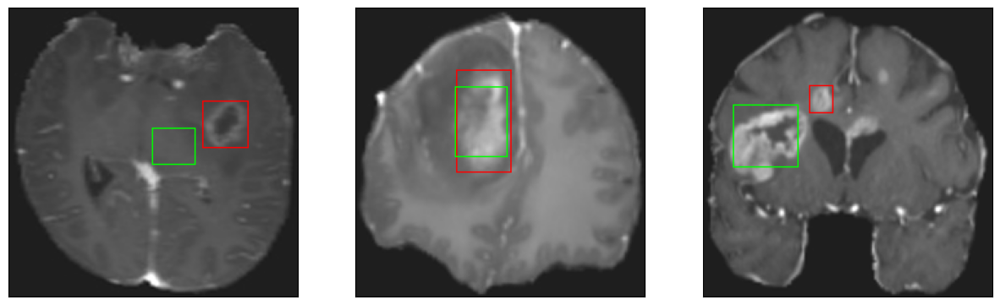

26/26 [==============================] - 7s 287ms/step - loss: 5.8364 - IoU: 0.5658 - val_loss: 8.6961 - val_IoU: 0.4806
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 6.0556 - IoU: 0.5559
Epoch 130: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


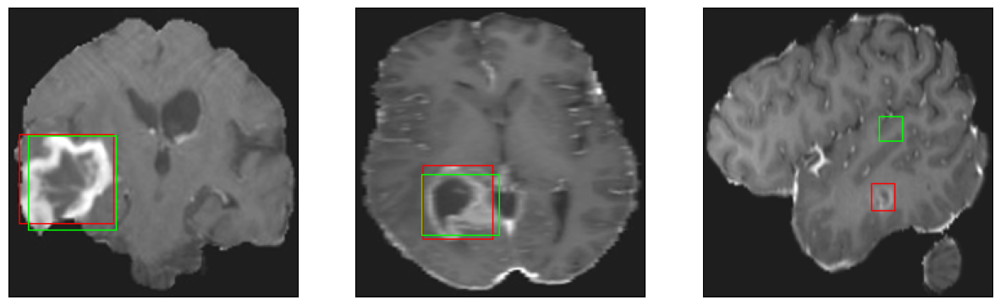

26/26 [==============================] - 8s 300ms/step - loss: 6.0556 - IoU: 0.5559 - val_loss: 8.2943 - val_IoU: 0.5106
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 5.9405 - IoU: 0.5595
Epoch 131: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


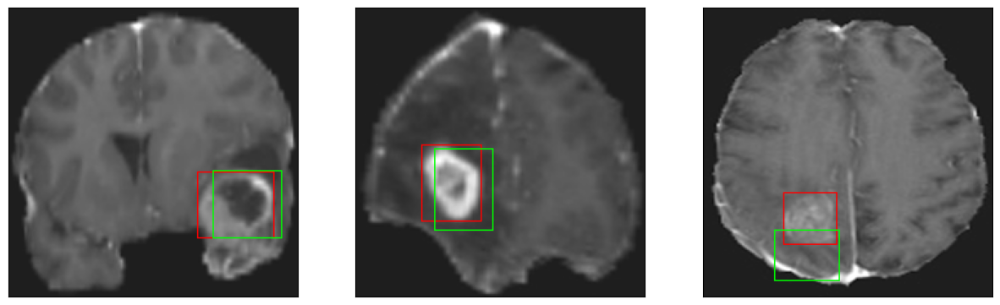

26/26 [==============================] - 8s 313ms/step - loss: 5.9405 - IoU: 0.5595 - val_loss: 8.1997 - val_IoU: 0.4924
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.7711 - IoU: 0.5683
Epoch 132: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


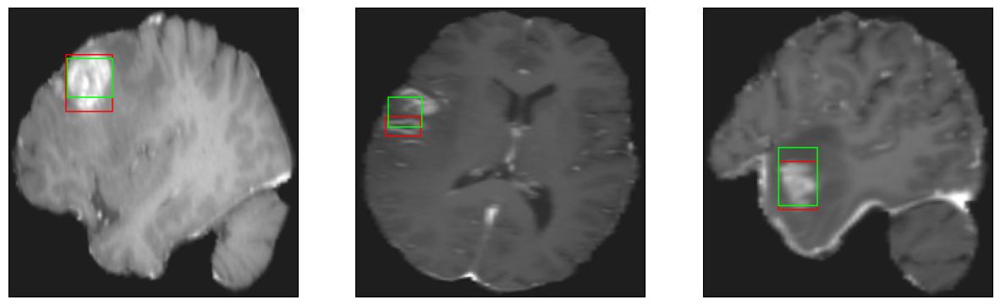

26/26 [==============================] - 8s 310ms/step - loss: 5.7711 - IoU: 0.5683 - val_loss: 8.9578 - val_IoU: 0.4601
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 6.3235 - IoU: 0.5339
Epoch 133: val_IoU did not improve from 0.51141
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


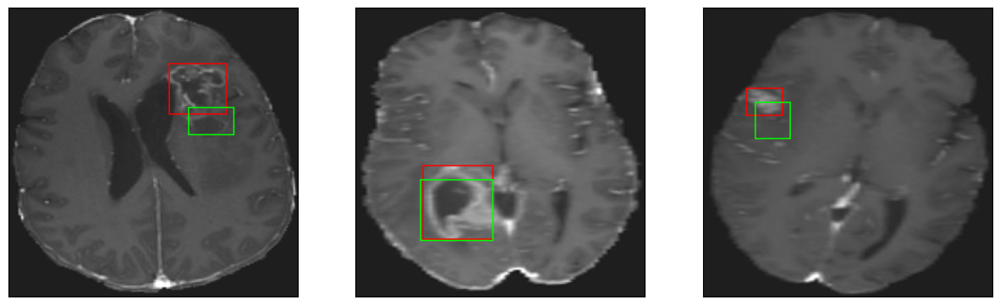

26/26 [==============================] - 8s 316ms/step - loss: 6.3235 - IoU: 0.5339 - val_loss: 8.3831 - val_IoU: 0.4920
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.8425 - IoU: 0.5560
Epoch 134: val_IoU improved from 0.51141 to 0.52820, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


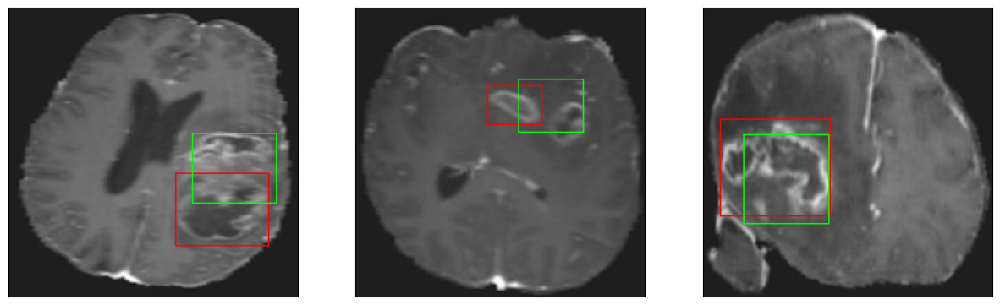

26/26 [==============================] - 23s 921ms/step - loss: 5.8425 - IoU: 0.5560 - val_loss: 8.0173 - val_IoU: 0.5282
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.8363 - IoU: 0.5713
Epoch 135: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


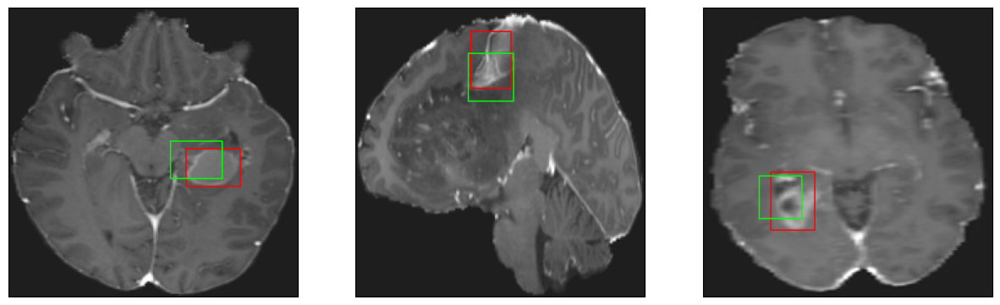

26/26 [==============================] - 8s 318ms/step - loss: 5.8363 - IoU: 0.5713 - val_loss: 8.1951 - val_IoU: 0.4919
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.8917 - IoU: 0.5684
Epoch 136: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


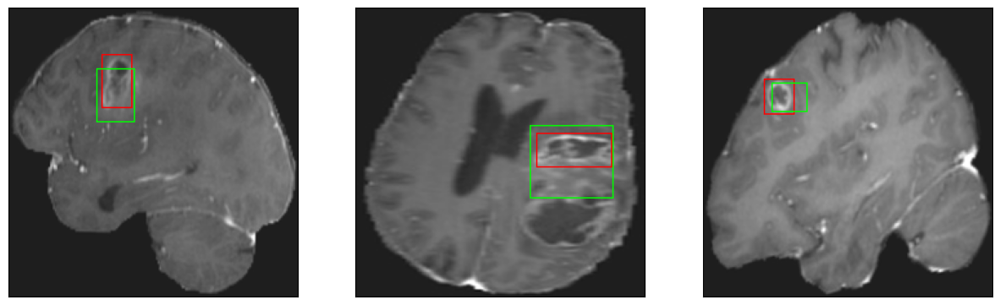

26/26 [==============================] - 8s 313ms/step - loss: 5.8917 - IoU: 0.5684 - val_loss: 8.4987 - val_IoU: 0.4888
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 6.0877 - IoU: 0.5531
Epoch 137: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


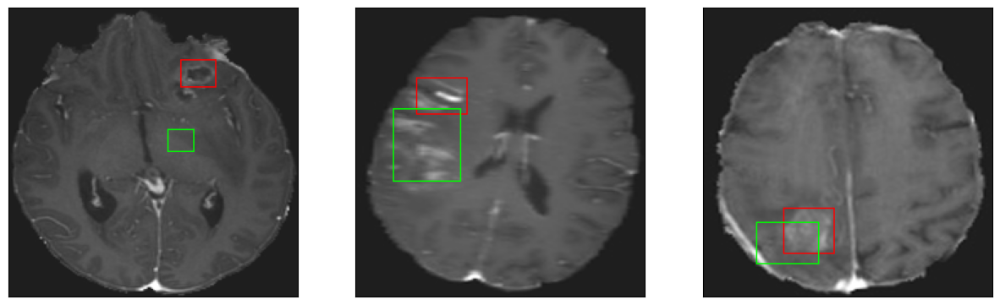

26/26 [==============================] - 7s 283ms/step - loss: 6.0877 - IoU: 0.5531 - val_loss: 8.3822 - val_IoU: 0.4848
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.6952 - IoU: 0.5740
Epoch 138: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


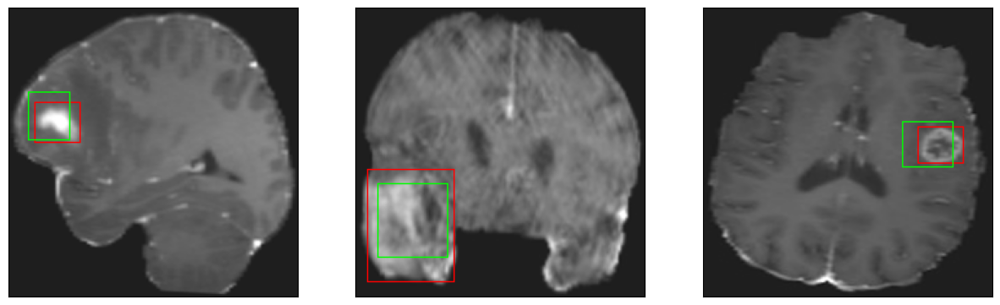

26/26 [==============================] - 8s 297ms/step - loss: 5.6952 - IoU: 0.5740 - val_loss: 8.1673 - val_IoU: 0.5172
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 6.0610 - IoU: 0.5576
Epoch 139: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


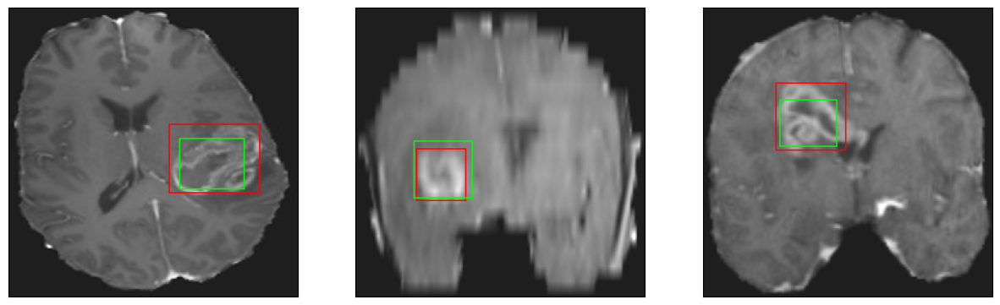

26/26 [==============================] - 7s 290ms/step - loss: 6.0610 - IoU: 0.5576 - val_loss: 8.2408 - val_IoU: 0.4958
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.6410 - IoU: 0.5803
Epoch 140: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


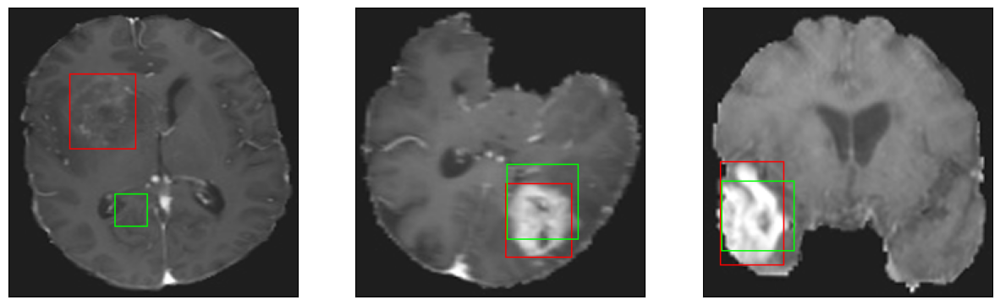

26/26 [==============================] - 8s 306ms/step - loss: 5.6410 - IoU: 0.5803 - val_loss: 8.3168 - val_IoU: 0.5219
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.6704 - IoU: 0.5729
Epoch 141: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


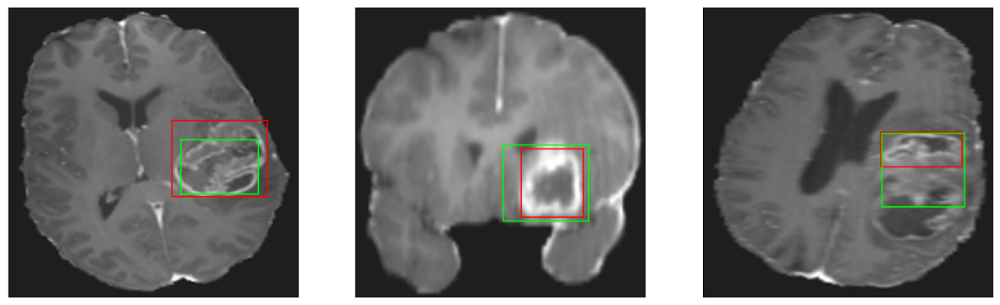

26/26 [==============================] - 7s 266ms/step - loss: 5.6704 - IoU: 0.5729 - val_loss: 8.8206 - val_IoU: 0.4838
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.7835 - IoU: 0.5697
Epoch 142: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


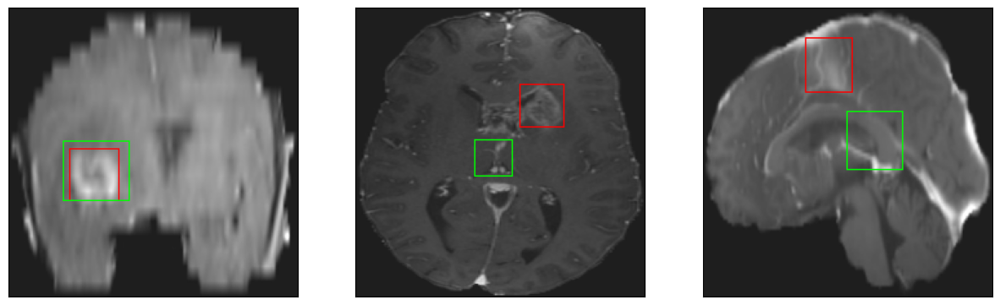

26/26 [==============================] - 8s 297ms/step - loss: 5.7835 - IoU: 0.5697 - val_loss: 8.6489 - val_IoU: 0.4883
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.6053 - IoU: 0.5739
Epoch 143: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


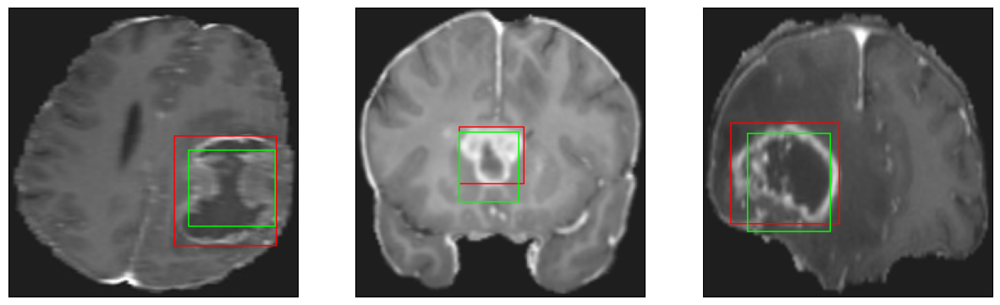

26/26 [==============================] - 8s 300ms/step - loss: 5.6053 - IoU: 0.5739 - val_loss: 8.3944 - val_IoU: 0.4993
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.9314 - IoU: 0.5564
Epoch 144: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


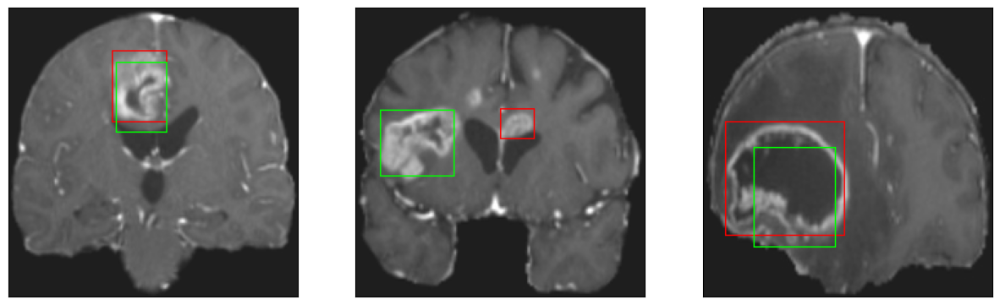

26/26 [==============================] - 8s 301ms/step - loss: 5.9314 - IoU: 0.5564 - val_loss: 8.2581 - val_IoU: 0.4951
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.5311 - IoU: 0.5747
Epoch 145: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


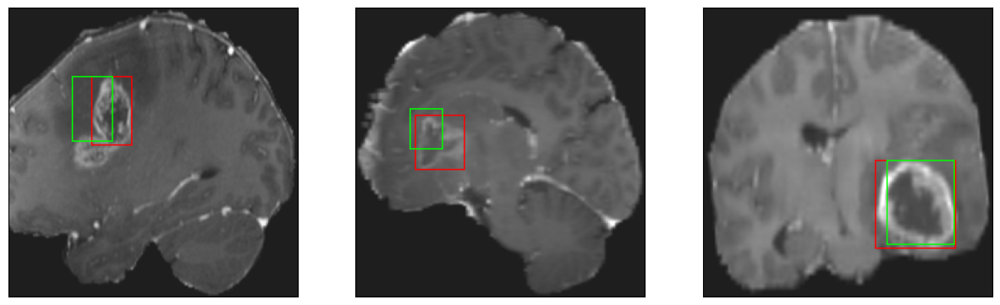

26/26 [==============================] - 8s 321ms/step - loss: 5.5311 - IoU: 0.5747 - val_loss: 8.3335 - val_IoU: 0.4988
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.5910 - IoU: 0.5796
Epoch 146: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


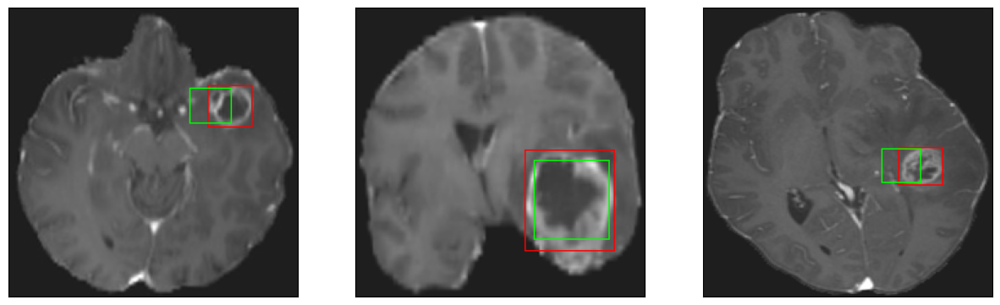

26/26 [==============================] - 8s 304ms/step - loss: 5.5910 - IoU: 0.5796 - val_loss: 8.6620 - val_IoU: 0.4740
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 5.7735 - IoU: 0.5647
Epoch 147: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


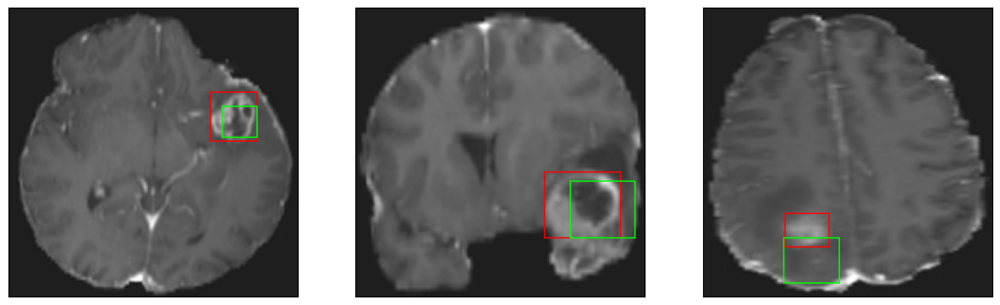

26/26 [==============================] - 7s 278ms/step - loss: 5.7735 - IoU: 0.5647 - val_loss: 8.5808 - val_IoU: 0.4858
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.6838 - IoU: 0.5704
Epoch 148: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


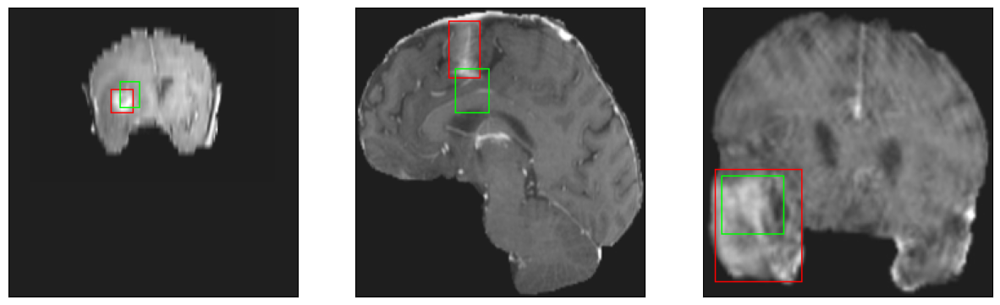

26/26 [==============================] - 8s 317ms/step - loss: 5.6838 - IoU: 0.5704 - val_loss: 8.8880 - val_IoU: 0.4772
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.4450 - IoU: 0.5924
Epoch 149: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


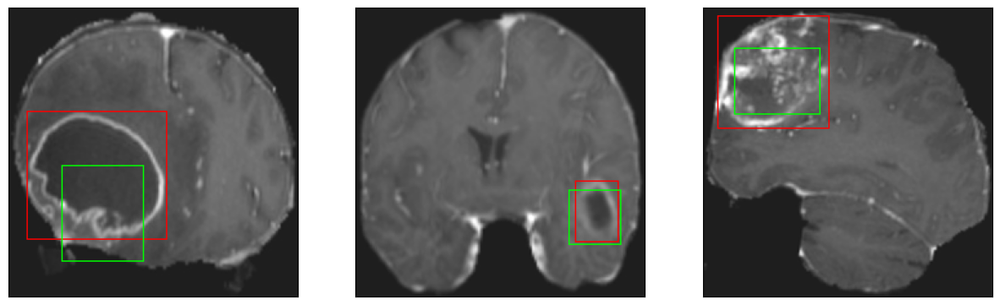

26/26 [==============================] - 8s 312ms/step - loss: 5.4450 - IoU: 0.5924 - val_loss: 9.2457 - val_IoU: 0.4535
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.6009 - IoU: 0.5733
Epoch 150: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


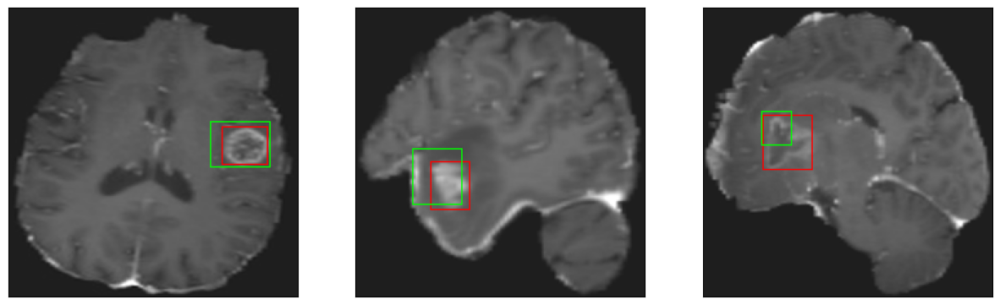

26/26 [==============================] - 8s 302ms/step - loss: 5.6009 - IoU: 0.5733 - val_loss: 8.7961 - val_IoU: 0.4711
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.4113 - IoU: 0.5888
Epoch 151: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


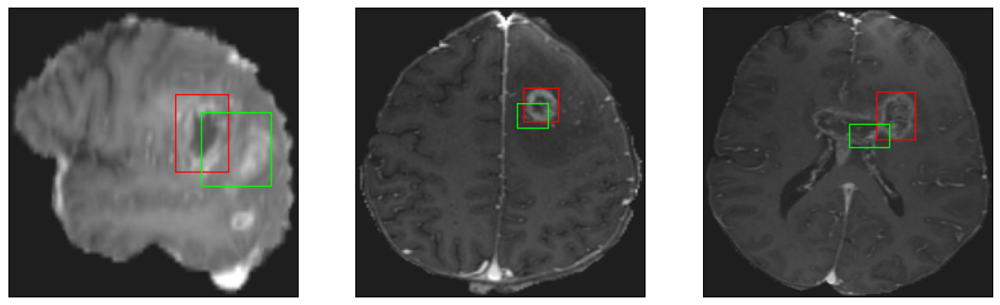

26/26 [==============================] - 8s 310ms/step - loss: 5.4113 - IoU: 0.5888 - val_loss: 8.7057 - val_IoU: 0.4566
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.6884 - IoU: 0.5704
Epoch 152: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


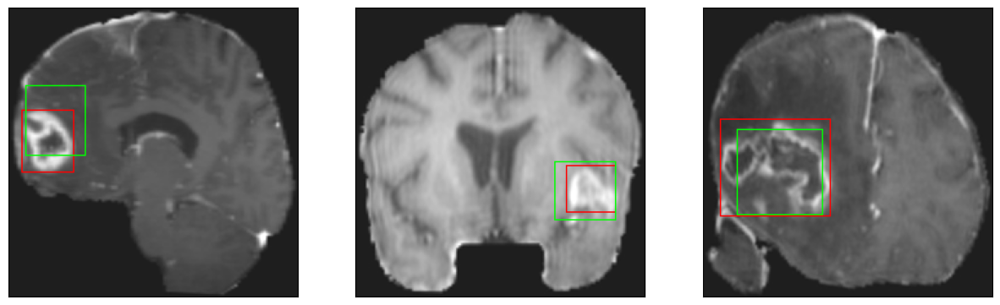

26/26 [==============================] - 8s 300ms/step - loss: 5.6884 - IoU: 0.5704 - val_loss: 8.4265 - val_IoU: 0.4521
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 5.8434 - IoU: 0.5639
Epoch 153: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


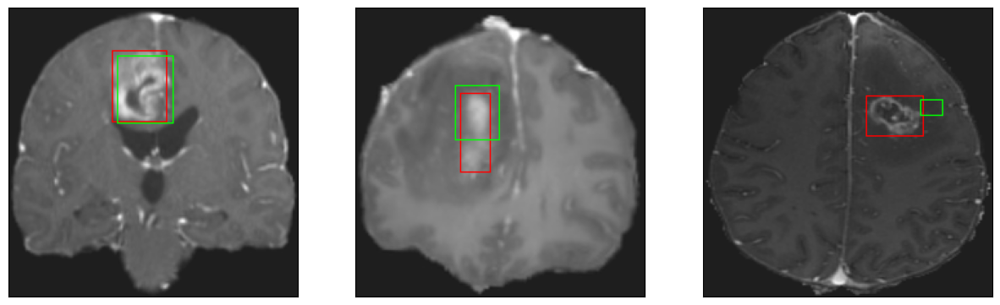

26/26 [==============================] - 8s 324ms/step - loss: 5.8434 - IoU: 0.5639 - val_loss: 8.7801 - val_IoU: 0.4732
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.5433 - IoU: 0.5774
Epoch 154: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


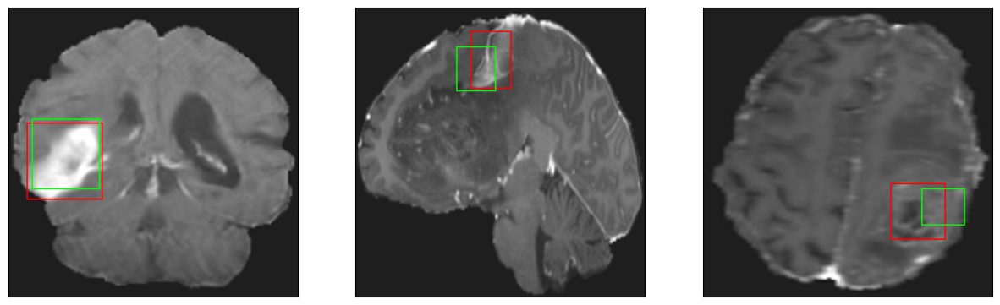

26/26 [==============================] - 8s 311ms/step - loss: 5.5433 - IoU: 0.5774 - val_loss: 7.9849 - val_IoU: 0.5043
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.4553 - IoU: 0.5836
Epoch 155: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


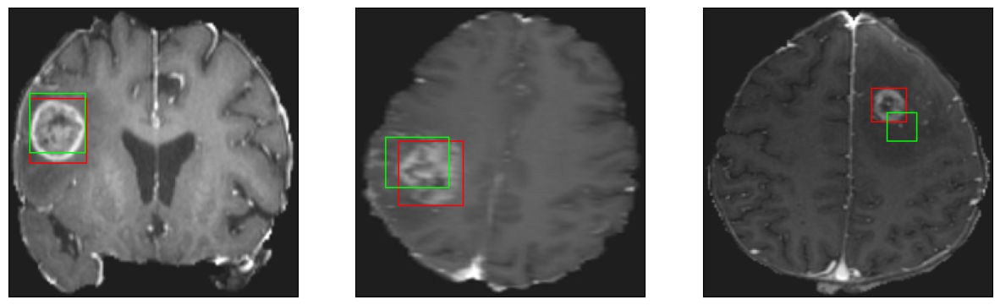

26/26 [==============================] - 8s 316ms/step - loss: 5.4553 - IoU: 0.5836 - val_loss: 8.5719 - val_IoU: 0.4734
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.2350 - IoU: 0.6004
Epoch 156: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


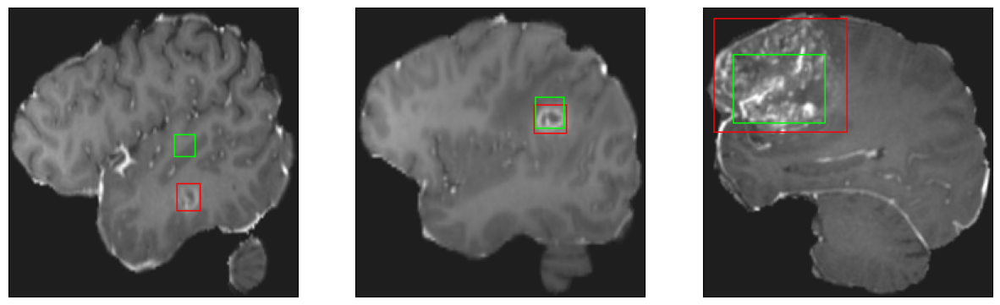

26/26 [==============================] - 8s 300ms/step - loss: 5.2350 - IoU: 0.6004 - val_loss: 8.9936 - val_IoU: 0.4537
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.7358 - IoU: 0.5713
Epoch 157: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


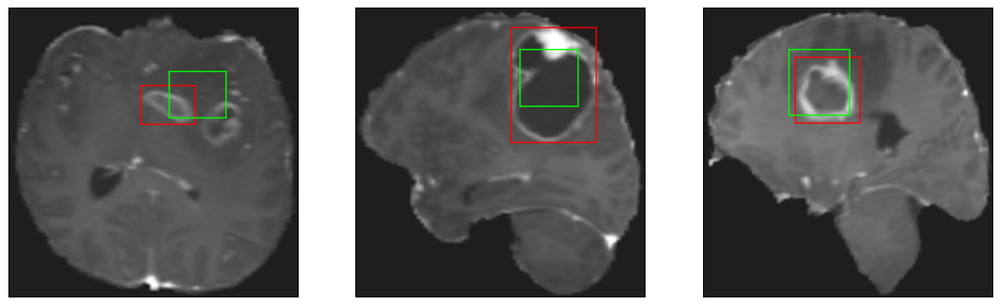

26/26 [==============================] - 8s 313ms/step - loss: 5.7358 - IoU: 0.5713 - val_loss: 8.3313 - val_IoU: 0.4934
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.6133 - IoU: 0.5756
Epoch 158: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


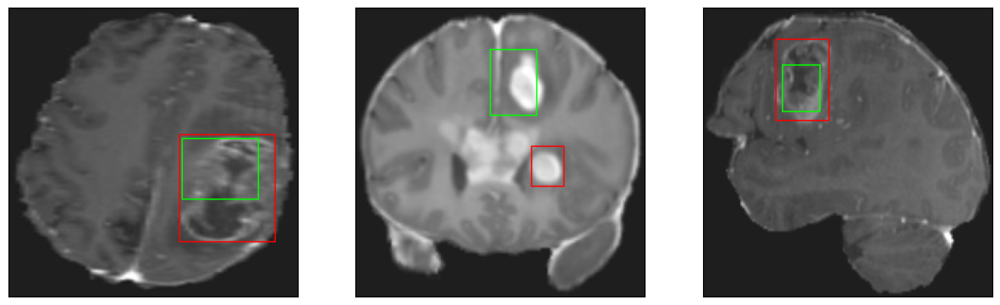

26/26 [==============================] - 7s 286ms/step - loss: 5.6133 - IoU: 0.5756 - val_loss: 8.9893 - val_IoU: 0.4454
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.5667 - IoU: 0.5718
Epoch 159: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


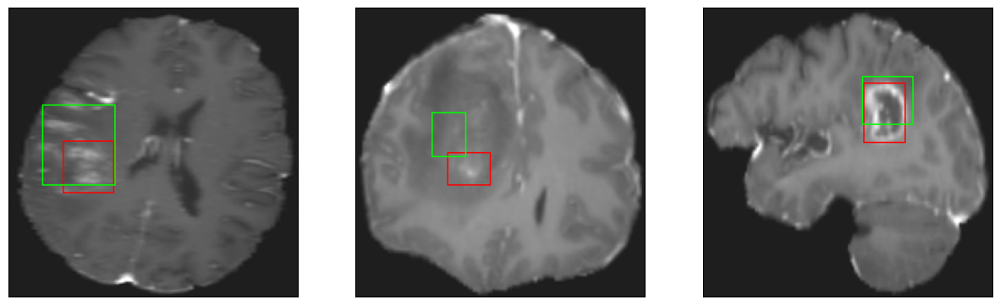

26/26 [==============================] - 8s 313ms/step - loss: 5.5667 - IoU: 0.5718 - val_loss: 8.5725 - val_IoU: 0.4982
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.5582 - IoU: 0.5785
Epoch 160: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4


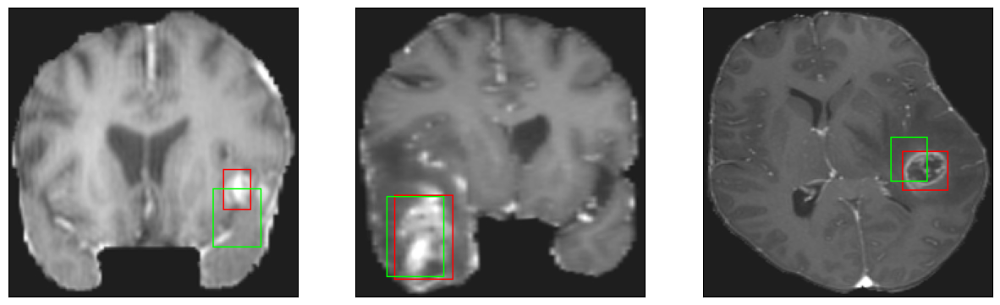

26/26 [==============================] - 8s 293ms/step - loss: 5.5582 - IoU: 0.5785 - val_loss: 8.4420 - val_IoU: 0.4961
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.3787 - IoU: 0.5897
Epoch 161: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


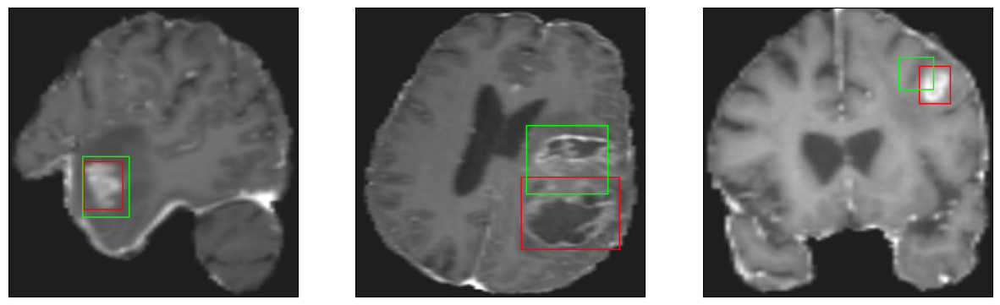

26/26 [==============================] - 8s 313ms/step - loss: 5.3787 - IoU: 0.5897 - val_loss: 8.2900 - val_IoU: 0.4829
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.3038 - IoU: 0.5915
Epoch 162: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


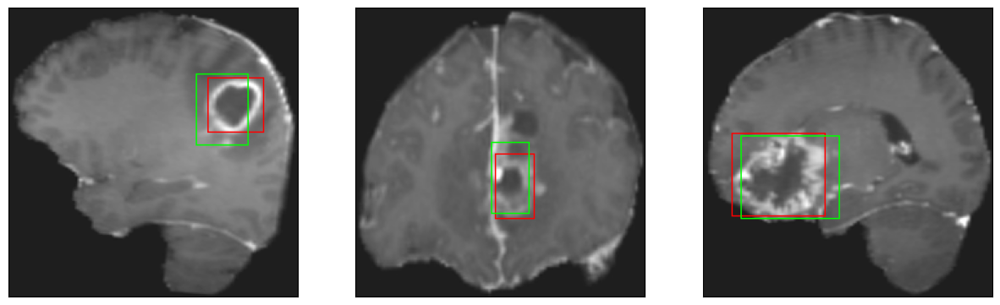

26/26 [==============================] - 7s 290ms/step - loss: 5.3038 - IoU: 0.5915 - val_loss: 8.4094 - val_IoU: 0.4951
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.5440 - IoU: 0.5816
Epoch 163: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


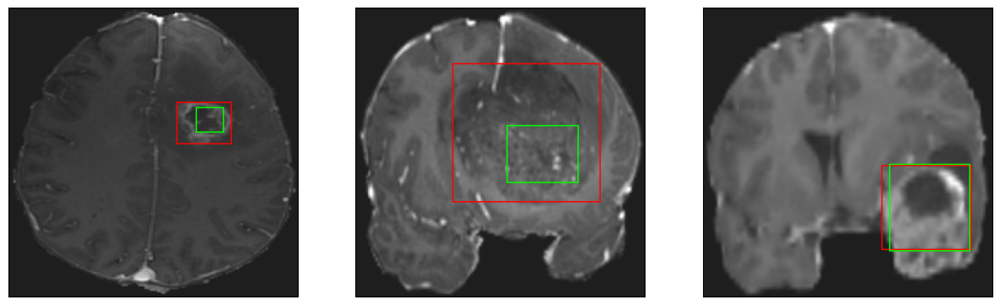

26/26 [==============================] - 7s 274ms/step - loss: 5.5440 - IoU: 0.5816 - val_loss: 8.3318 - val_IoU: 0.5101
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.4612 - IoU: 0.5891
Epoch 164: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


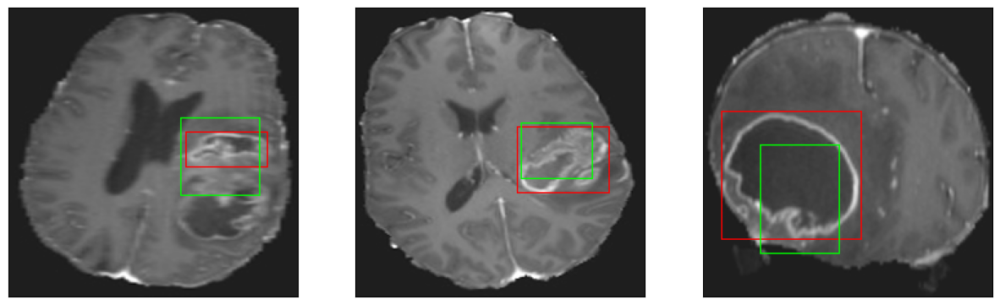

26/26 [==============================] - 8s 300ms/step - loss: 5.4612 - IoU: 0.5891 - val_loss: 8.9936 - val_IoU: 0.4604
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.8245 - IoU: 0.5633
Epoch 165: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


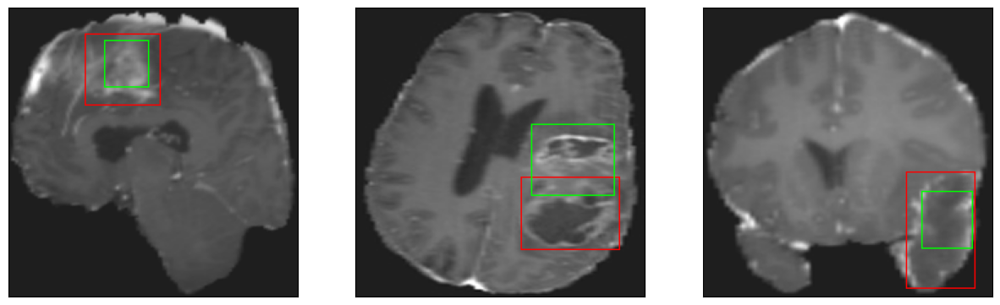

26/26 [==============================] - 8s 297ms/step - loss: 5.8245 - IoU: 0.5633 - val_loss: 8.6754 - val_IoU: 0.4878
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.5846 - IoU: 0.5738
Epoch 166: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


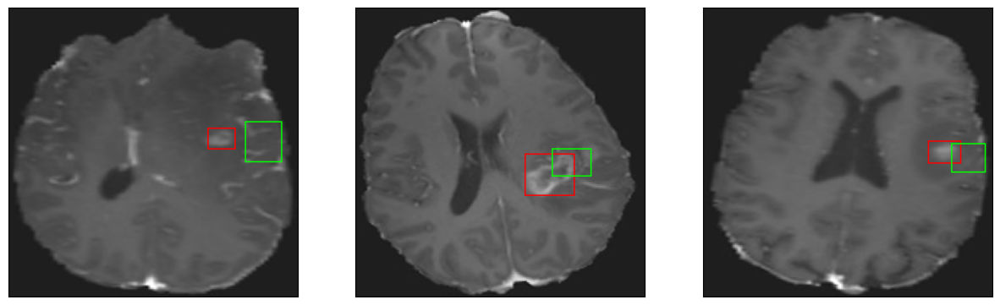

26/26 [==============================] - 8s 312ms/step - loss: 5.5846 - IoU: 0.5738 - val_loss: 9.0230 - val_IoU: 0.4490
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.5339 - IoU: 0.5781
Epoch 167: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


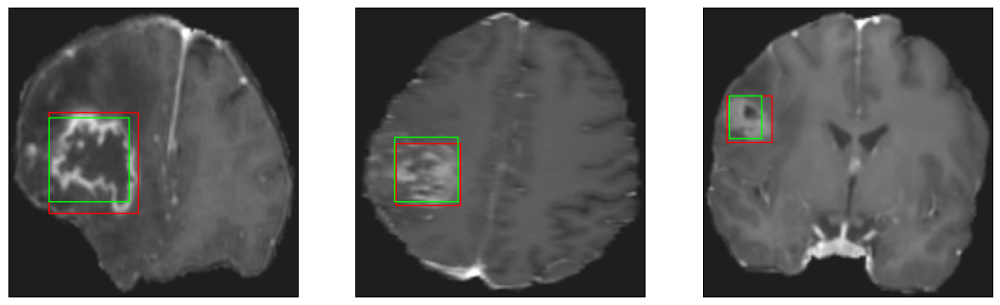

26/26 [==============================] - 8s 314ms/step - loss: 5.5339 - IoU: 0.5781 - val_loss: 9.0796 - val_IoU: 0.4568
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.6810 - IoU: 0.5729
Epoch 168: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


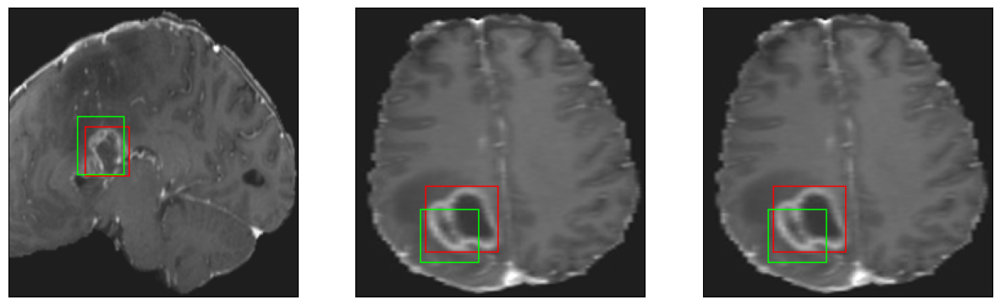

26/26 [==============================] - 8s 298ms/step - loss: 5.6810 - IoU: 0.5729 - val_loss: 8.8200 - val_IoU: 0.4617
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.3698 - IoU: 0.5907
Epoch 169: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


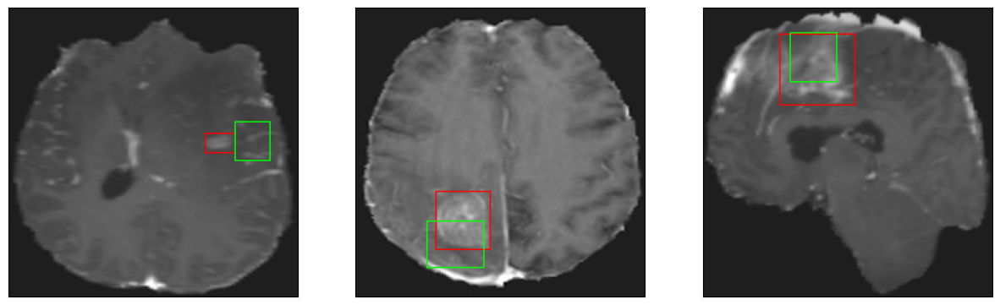

26/26 [==============================] - 8s 299ms/step - loss: 5.3698 - IoU: 0.5907 - val_loss: 8.6382 - val_IoU: 0.4878
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.4014 - IoU: 0.6016
Epoch 170: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


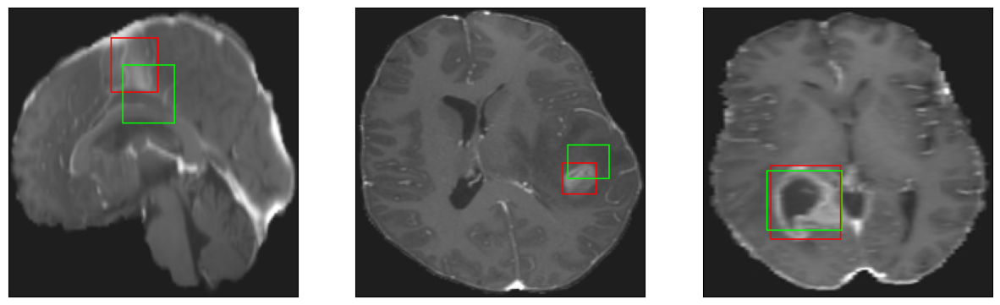

26/26 [==============================] - 8s 305ms/step - loss: 5.4014 - IoU: 0.6016 - val_loss: 8.5456 - val_IoU: 0.4998
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.6919 - IoU: 0.5731
Epoch 171: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


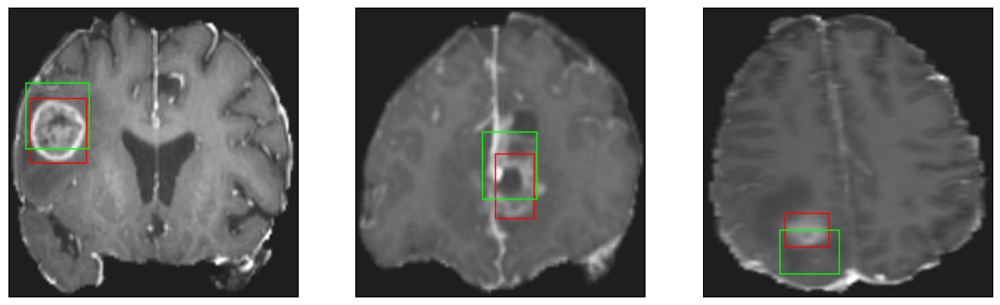

26/26 [==============================] - 8s 301ms/step - loss: 5.6919 - IoU: 0.5731 - val_loss: 10.1556 - val_IoU: 0.4577
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.4686 - IoU: 0.5855
Epoch 172: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


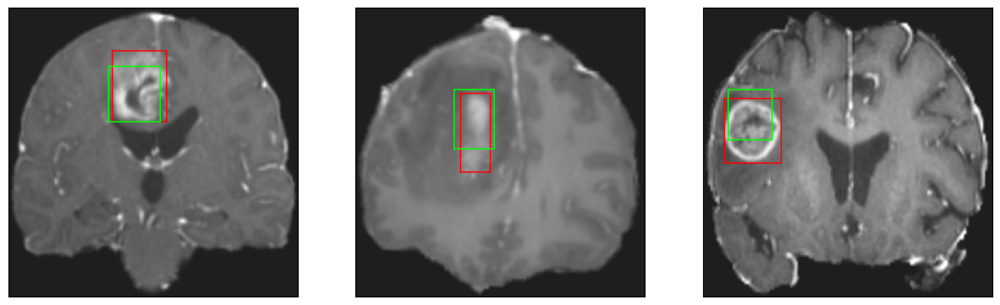

26/26 [==============================] - 7s 278ms/step - loss: 5.4686 - IoU: 0.5855 - val_loss: 8.2764 - val_IoU: 0.5202
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.5534 - IoU: 0.5796
Epoch 173: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


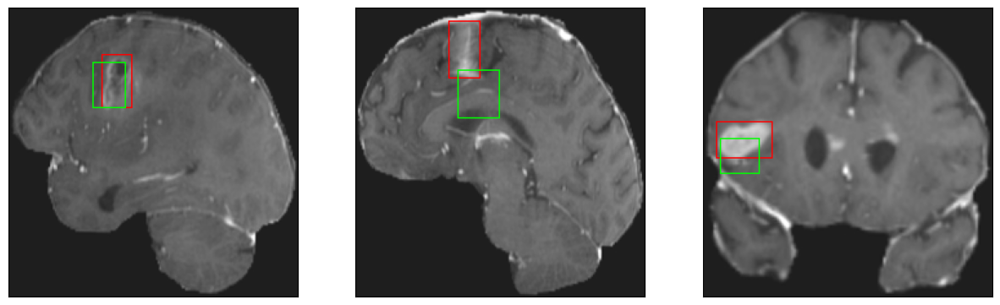

26/26 [==============================] - 8s 309ms/step - loss: 5.5534 - IoU: 0.5796 - val_loss: 8.4865 - val_IoU: 0.4831
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.2824 - IoU: 0.5875
Epoch 174: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


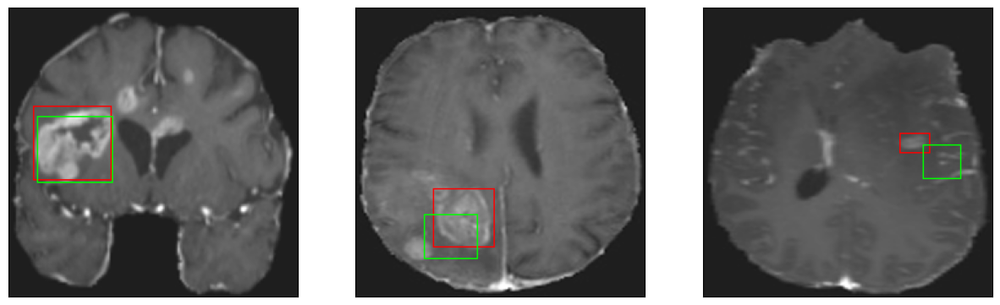

26/26 [==============================] - 8s 298ms/step - loss: 5.2824 - IoU: 0.5875 - val_loss: 8.0398 - val_IoU: 0.5105
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.9874 - IoU: 0.6106
Epoch 175: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


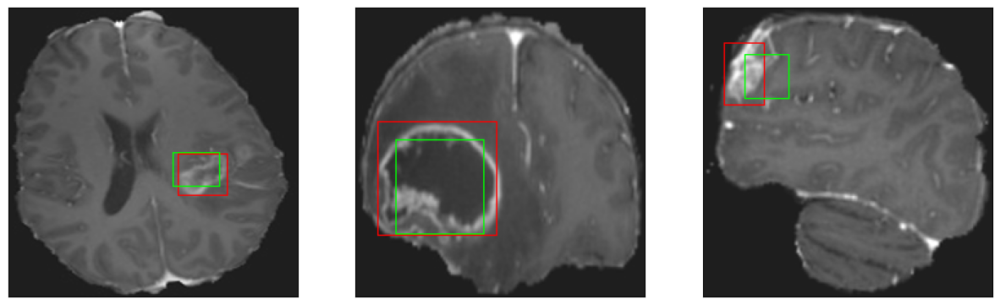

26/26 [==============================] - 8s 315ms/step - loss: 4.9874 - IoU: 0.6106 - val_loss: 8.1292 - val_IoU: 0.5046
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.2827 - IoU: 0.5894
Epoch 176: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


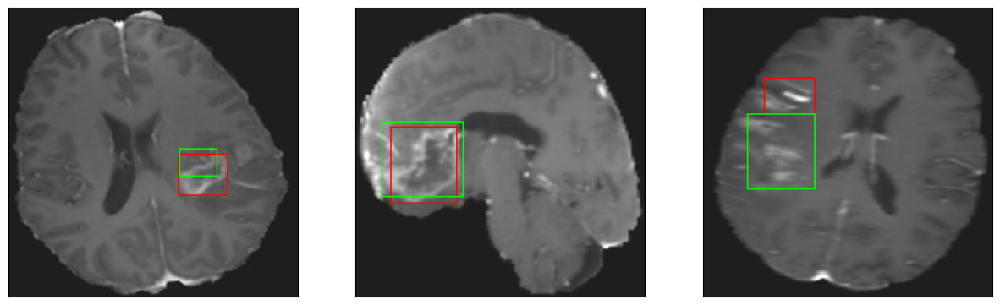

26/26 [==============================] - 8s 297ms/step - loss: 5.2827 - IoU: 0.5894 - val_loss: 8.3440 - val_IoU: 0.4956
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.1870 - IoU: 0.6016
Epoch 177: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


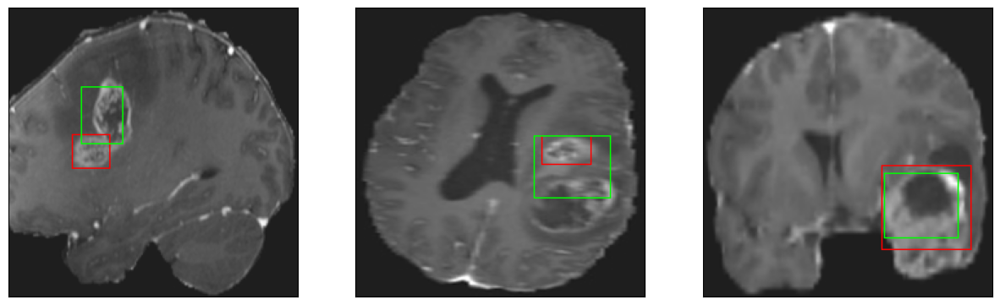

26/26 [==============================] - 8s 313ms/step - loss: 5.1870 - IoU: 0.6016 - val_loss: 9.0836 - val_IoU: 0.4586
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.6838 - IoU: 0.5728
Epoch 178: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


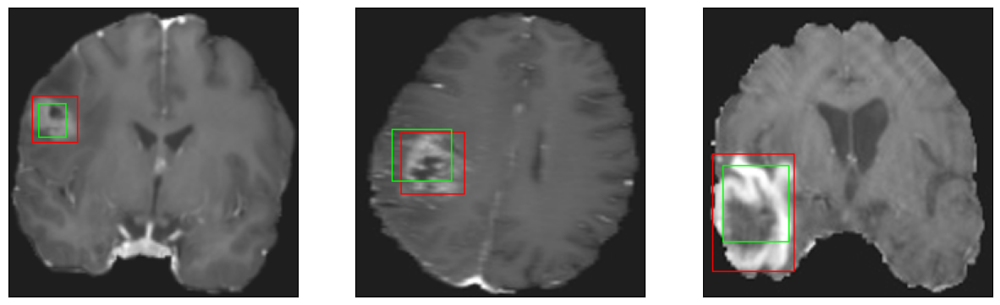

26/26 [==============================] - 8s 310ms/step - loss: 5.6838 - IoU: 0.5728 - val_loss: 9.9230 - val_IoU: 0.4110
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.4593 - IoU: 0.5837
Epoch 179: val_IoU did not improve from 0.52820
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


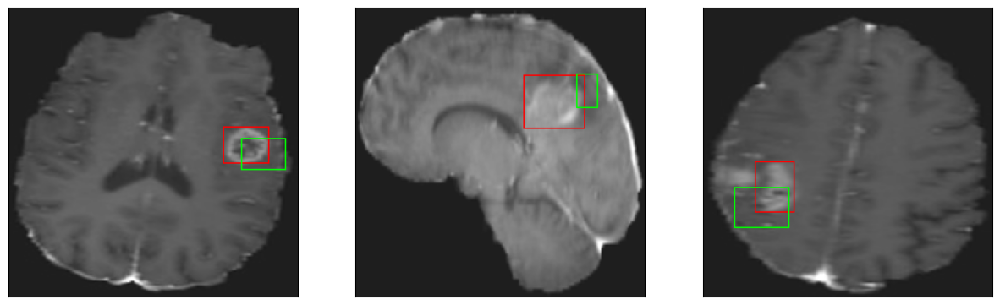

26/26 [==============================] - 8s 305ms/step - loss: 5.4593 - IoU: 0.5837 - val_loss: 8.9583 - val_IoU: 0.4865
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.2650 - IoU: 0.5957
Epoch 180: val_IoU improved from 0.52820 to 0.53453, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


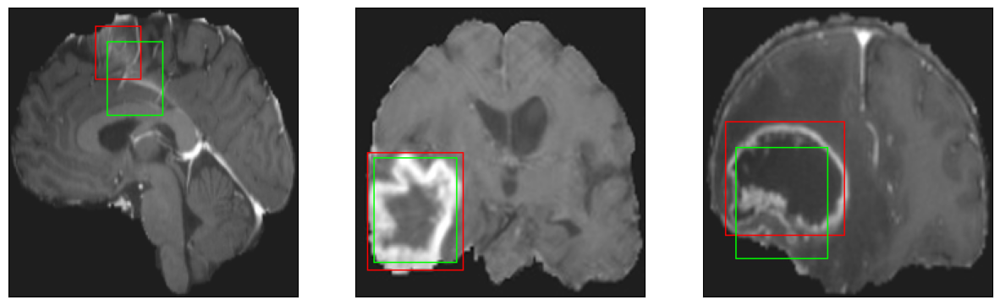

26/26 [==============================] - 21s 843ms/step - loss: 5.2650 - IoU: 0.5957 - val_loss: 7.9947 - val_IoU: 0.5345
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.4043 - IoU: 0.5944
Epoch 181: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


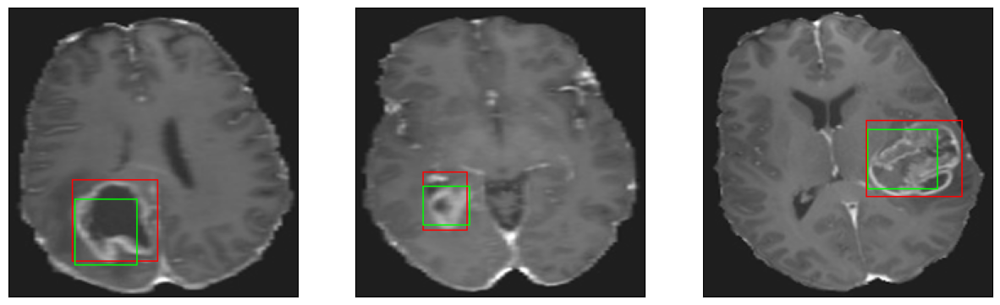

26/26 [==============================] - 8s 309ms/step - loss: 5.4043 - IoU: 0.5944 - val_loss: 8.4820 - val_IoU: 0.4740
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.3606 - IoU: 0.5965
Epoch 182: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


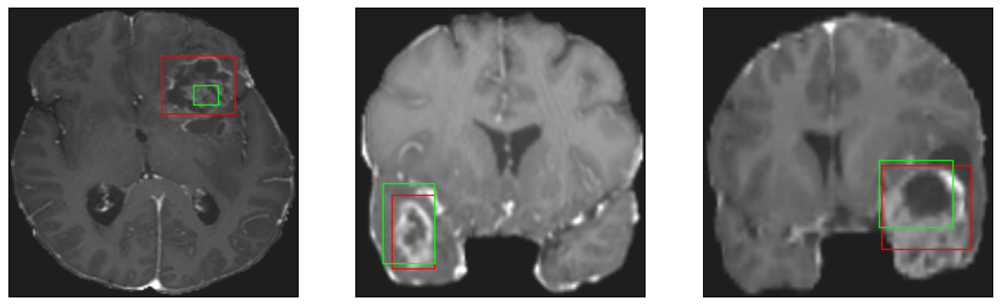

26/26 [==============================] - 7s 288ms/step - loss: 5.3606 - IoU: 0.5965 - val_loss: 9.0940 - val_IoU: 0.4513
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.6035 - IoU: 0.5706
Epoch 183: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


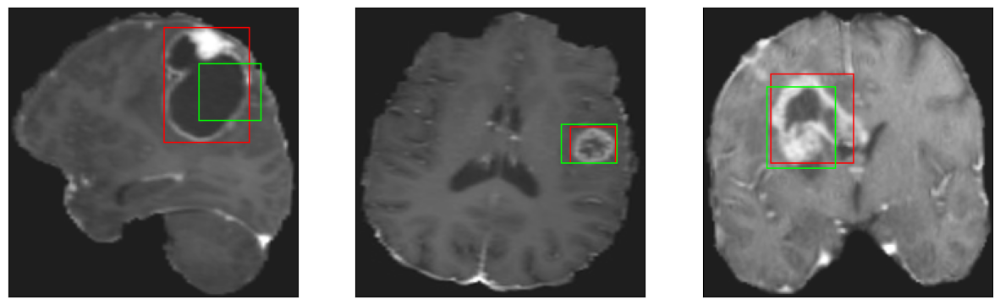

26/26 [==============================] - 8s 308ms/step - loss: 5.6035 - IoU: 0.5706 - val_loss: 8.0771 - val_IoU: 0.5080
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.6502 - IoU: 0.5684
Epoch 184: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


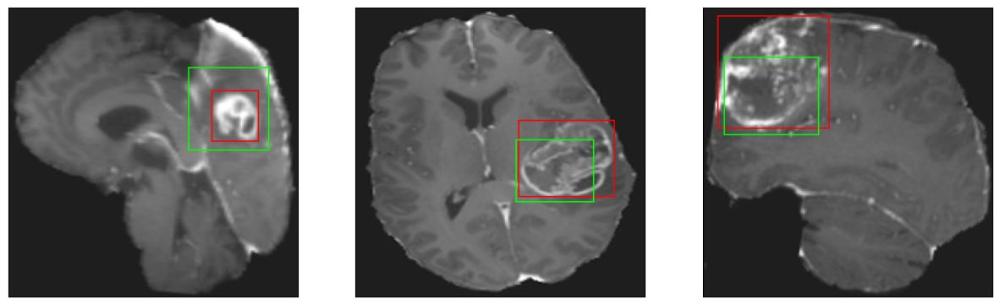

26/26 [==============================] - 8s 306ms/step - loss: 5.6502 - IoU: 0.5684 - val_loss: 7.9453 - val_IoU: 0.5287
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.7053 - IoU: 0.5791
Epoch 185: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


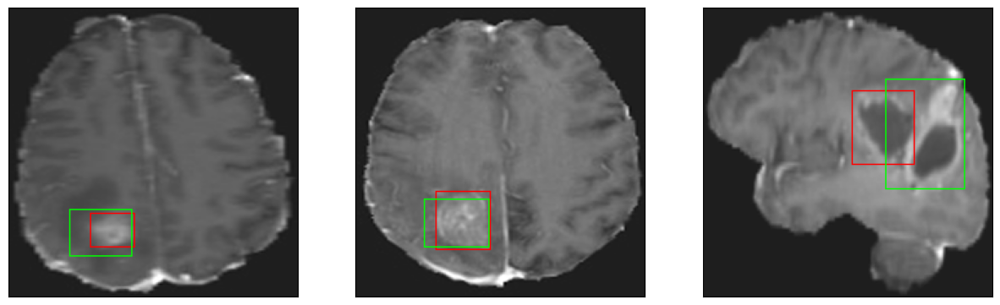

26/26 [==============================] - 8s 293ms/step - loss: 5.7053 - IoU: 0.5791 - val_loss: 9.3474 - val_IoU: 0.4662
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.4084 - IoU: 0.5932
Epoch 186: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


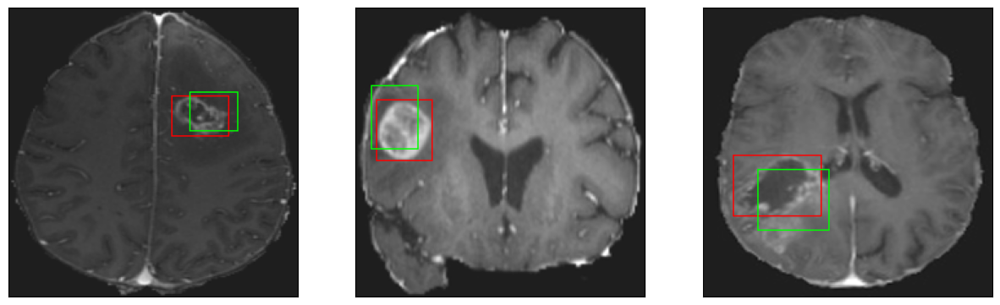

26/26 [==============================] - 8s 312ms/step - loss: 5.4084 - IoU: 0.5932 - val_loss: 8.5919 - val_IoU: 0.4867
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.5973 - IoU: 0.5722
Epoch 187: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


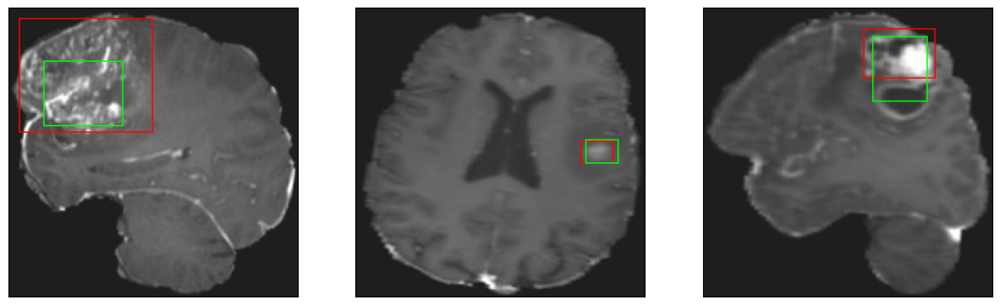

26/26 [==============================] - 8s 298ms/step - loss: 5.5973 - IoU: 0.5722 - val_loss: 8.5163 - val_IoU: 0.4565
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.1660 - IoU: 0.5985
Epoch 188: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


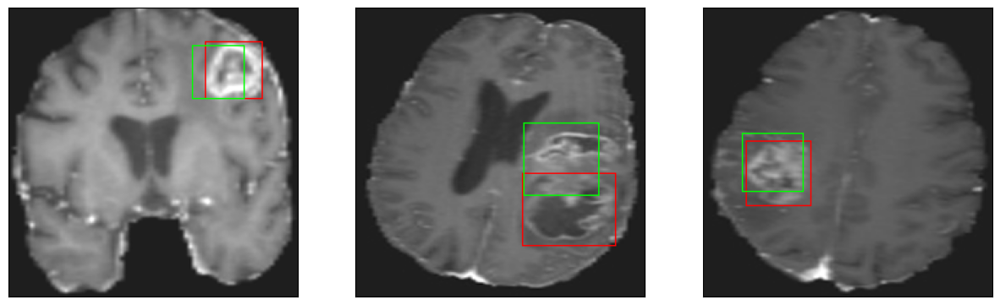

26/26 [==============================] - 8s 311ms/step - loss: 5.1660 - IoU: 0.5985 - val_loss: 8.9275 - val_IoU: 0.4431
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.3484 - IoU: 0.5864
Epoch 189: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


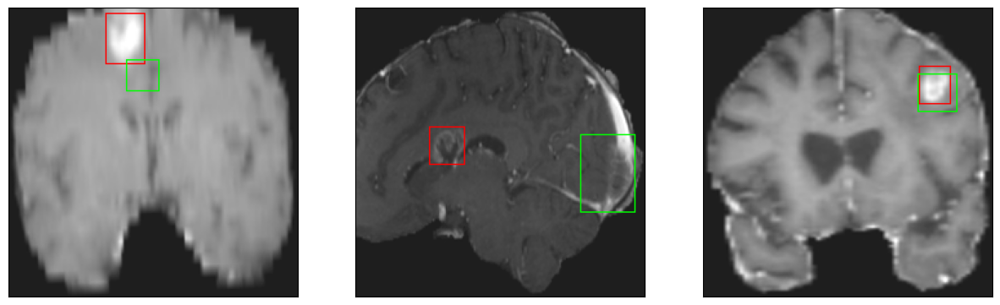

26/26 [==============================] - 8s 308ms/step - loss: 5.3484 - IoU: 0.5864 - val_loss: 8.3588 - val_IoU: 0.5036
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.5579 - IoU: 0.5834
Epoch 190: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


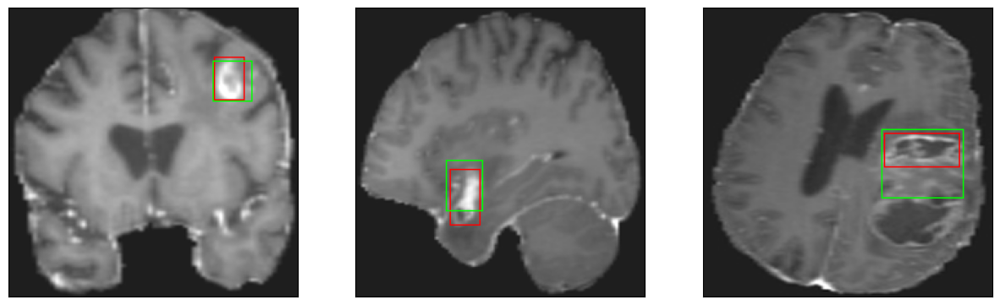

26/26 [==============================] - 8s 313ms/step - loss: 5.5579 - IoU: 0.5834 - val_loss: 7.9991 - val_IoU: 0.5223
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.3927 - IoU: 0.5865
Epoch 191: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


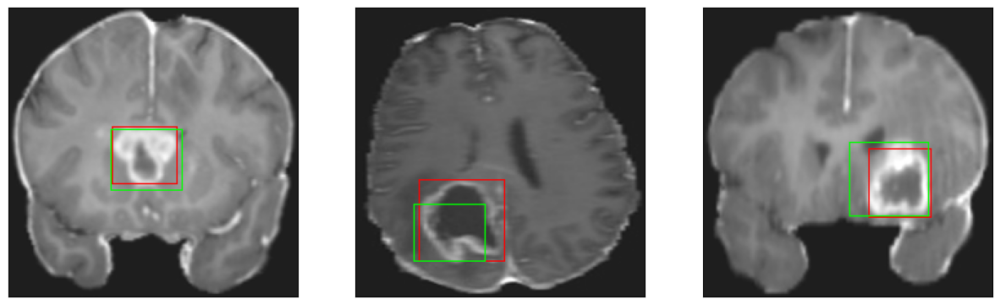

26/26 [==============================] - 8s 297ms/step - loss: 5.3927 - IoU: 0.5865 - val_loss: 9.0532 - val_IoU: 0.4678
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.2931 - IoU: 0.5950
Epoch 192: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


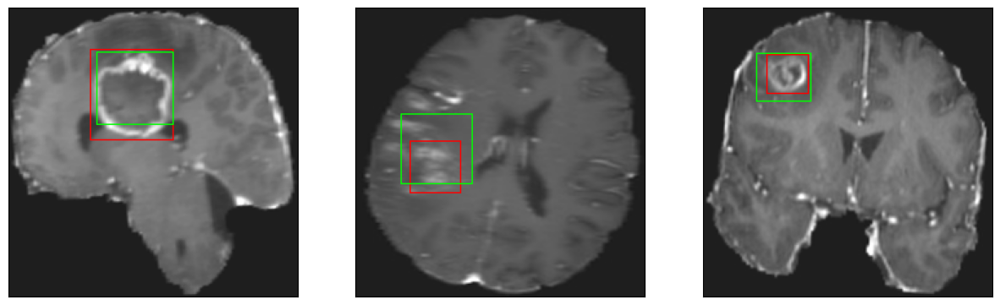

26/26 [==============================] - 8s 301ms/step - loss: 5.2931 - IoU: 0.5950 - val_loss: 8.6202 - val_IoU: 0.4748
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.5938 - IoU: 0.5684
Epoch 193: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


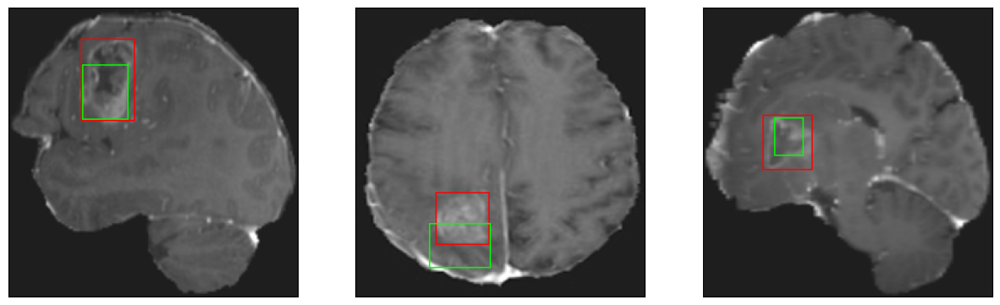

26/26 [==============================] - 7s 288ms/step - loss: 5.5938 - IoU: 0.5684 - val_loss: 8.3749 - val_IoU: 0.5015
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.3627 - IoU: 0.5860
Epoch 194: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


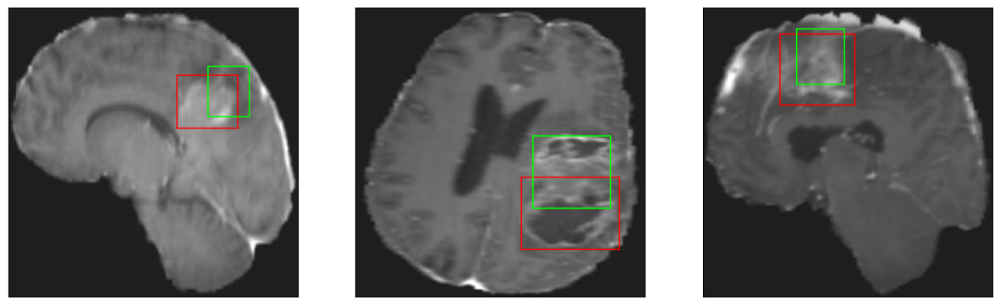

26/26 [==============================] - 8s 311ms/step - loss: 5.3627 - IoU: 0.5860 - val_loss: 8.8269 - val_IoU: 0.4613
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.1622 - IoU: 0.5961
Epoch 195: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


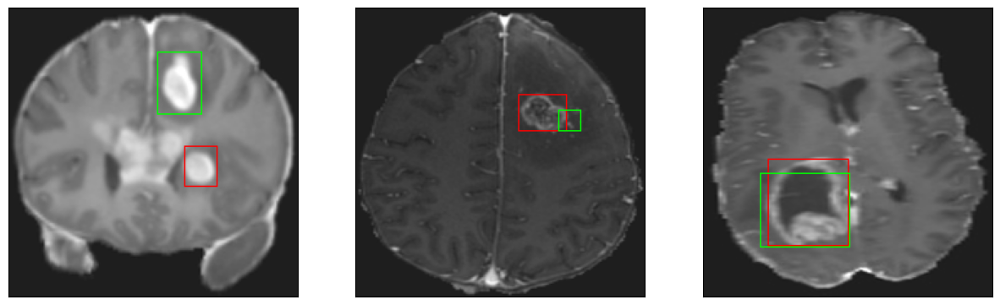

26/26 [==============================] - 8s 303ms/step - loss: 5.1622 - IoU: 0.5961 - val_loss: 8.5509 - val_IoU: 0.5052
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.1828 - IoU: 0.5988
Epoch 196: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


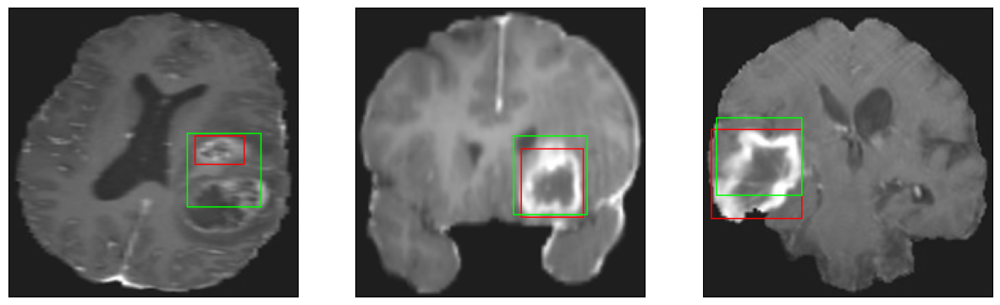

26/26 [==============================] - 8s 314ms/step - loss: 5.1828 - IoU: 0.5988 - val_loss: 8.7064 - val_IoU: 0.4692
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.3447 - IoU: 0.5863
Epoch 197: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4


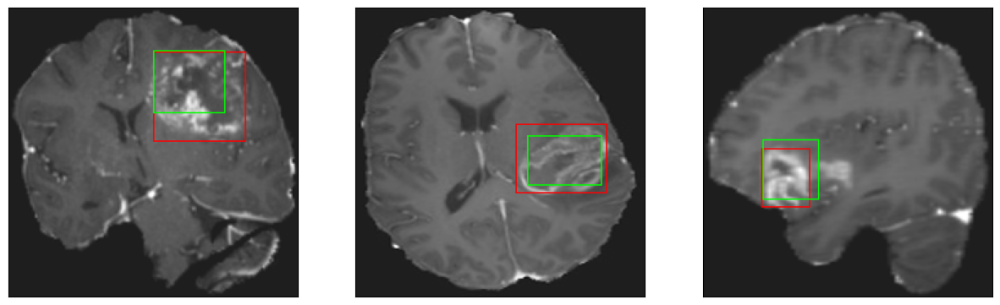

26/26 [==============================] - 8s 322ms/step - loss: 5.3447 - IoU: 0.5863 - val_loss: 8.4611 - val_IoU: 0.4879
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.4832 - IoU: 0.5789
Epoch 198: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


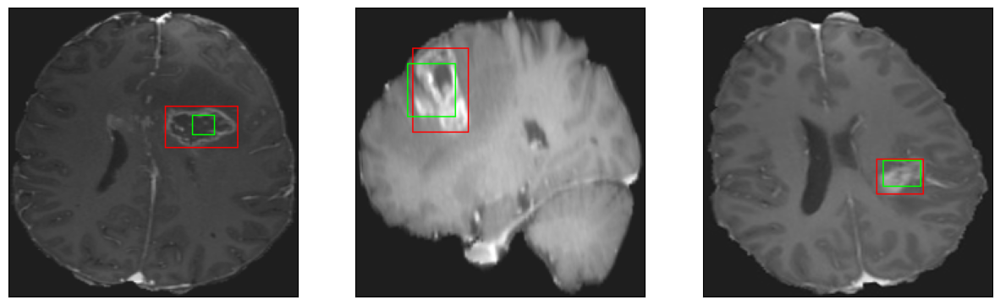

26/26 [==============================] - 8s 297ms/step - loss: 5.4832 - IoU: 0.5789 - val_loss: 9.3038 - val_IoU: 0.4611
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.3399 - IoU: 0.5930
Epoch 199: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


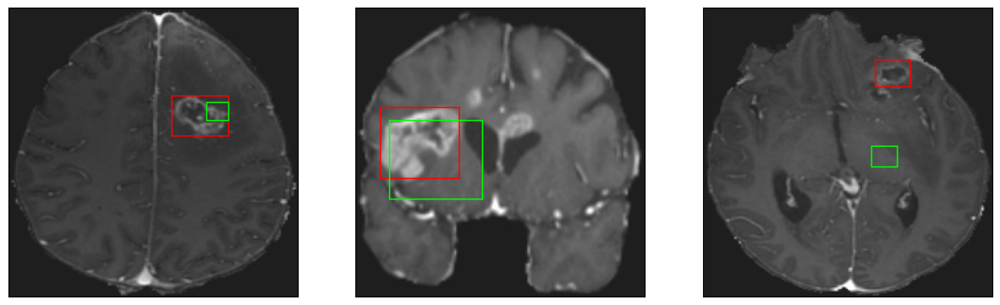

26/26 [==============================] - 8s 313ms/step - loss: 5.3399 - IoU: 0.5930 - val_loss: 8.4401 - val_IoU: 0.4920
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 5.3953 - IoU: 0.5882
Epoch 200: val_IoU did not improve from 0.53453
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


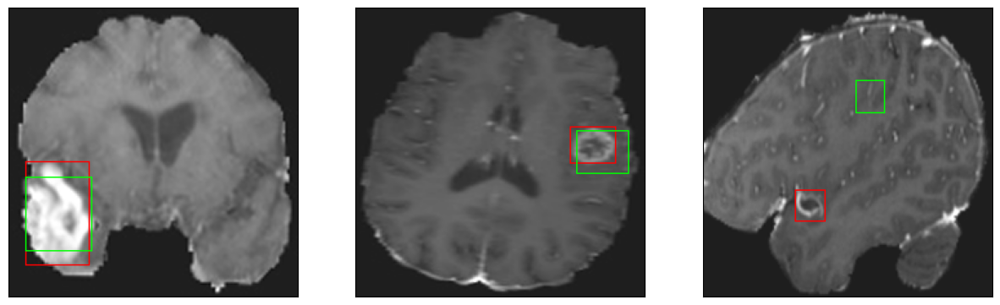

26/26 [==============================] - 8s 293ms/step - loss: 5.3953 - IoU: 0.5882 - val_loss: 8.1942 - val_IoU: 0.5006


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

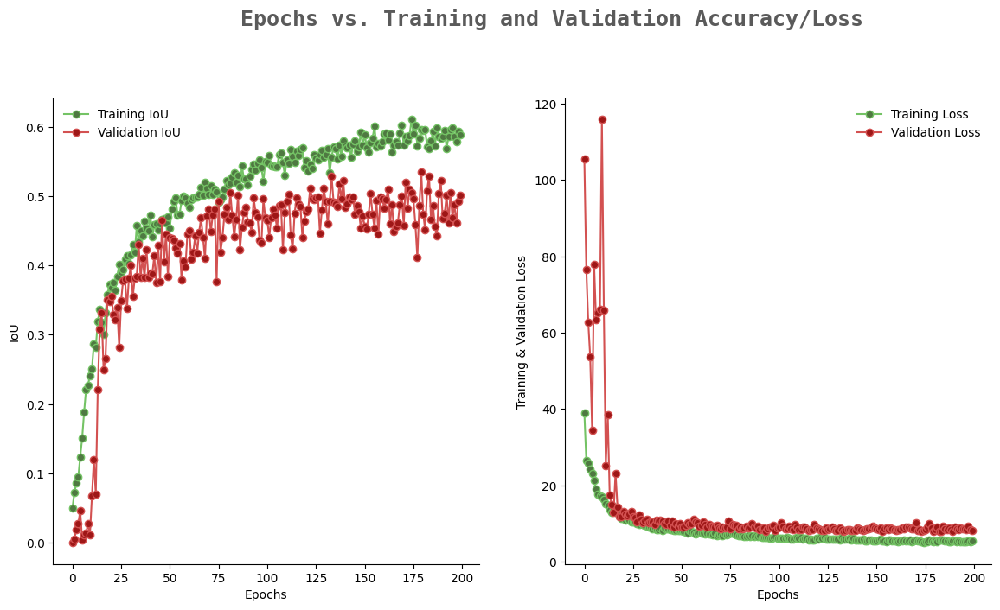

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 57ms/step - loss: 10.3915 - IoU: 0.4517


[10.39151382446289, 0.45167505741119385]